In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
d = "easytour"# easytour tourpedia

# Imports

In [3]:
! pip install "transformers" "pytorch-lightning"

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
import json
import pandas as pd
import numpy as np
import time
import heapq
import ast

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.cluster import KMeans
from sklearn.decomposition import TruncatedSVD
import matplotlib.pyplot as plt
%matplotlib inline 
from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster import SilhouetteVisualizer

In [5]:
from transformers import AutoTokenizer, AutoModel
import torch
import torch.nn as nn

In [6]:
import warnings
warnings.filterwarnings("ignore")

In [7]:
device = 0
if torch.cuda.is_available():    
    # Tell PyTorch to use the GPU.    
    device = torch.device("cuda")
    print('There are %d GPU(s) available.' % torch.cuda.device_count())
    print('We will use the GPU:', torch.cuda.get_device_name(0))
# If not...
else:
    print('No GPU available, using the CPU instead.')
    device = torch.device("cpu")

There are 1 GPU(s) available.
We will use the GPU: Tesla T4


In [8]:
if d == "easytour": 
  likes_path = "/content/drive/MyDrive/Tesi/kuriu-likes-2022-06JUN-18.json"
  schede_path = "/content/drive/MyDrive/Tesi/kuriu-schede-2022-06JUN-18.json"
  #data_path = "/content/drive/MyDrive/Tesi/data-JUN.csv"
  data_path = "/content/drive/MyDrive/Tesi/data-JUN-no-stemming.csv"
  df_schede = pd.read_json(schede_path)
  df_likes = pd.read_json(likes_path)
  categories = ["aria aperta", "cultura",	"eventi culinari", "food", "food all'aperto", "food drink",	"sport",	"tempo libero", "travel",	"viaggi"]
  df_schede_fields = df_schede[["id","userId", "title", "description", "duration", "datePublishing", "creationDate", "categories", "viewCounter"]]
  df_likes_ids = df_likes[["documentId", "authorId"]]
else:
  data_path = "/content/drive/MyDrive/Tesi/tourpedia_preprocessed.csv"

data = pd.read_csv(data_path, encoding_errors='ignore')  

In [9]:
data

,id,userId,title,description,duration,datePublishing,creationDate,categories,viewCounter,Unnamed: 9,...,food all'aperto,food drink,sport,tempo libero,travel,viaggi,title_processed,description_processed,duration_min,days
0,62349ff2272ae5672fbc3135,632,"Big Buddha, Phuket 🇹🇭",Phuket è conosciuta per essere la meta predile...,0,2022-03-19T04:48:49.248Z,2022-03-18T15:06:26.000+00:00,['Viaggi'],18,0,...,0,0,0,0,0,1,"['big', 'buddha']","['meta', 'turista', 'assalto', 'spiaggia', 'ac...",0.0,150
1,6234aa65272ae5672fbc34c2,632,"Wat Chalong, il tempio più venerato di Phuket 🇹🇭","Phuket non è solo spiagge, ci sono anche altri...",0,2022-03-19T04:04:27.356Z,2022-03-18T15:51:01.000+00:00,['Viaggi'],16,0,...,0,0,0,0,0,1,"['wat', 'chalong', 'tempio', 'phuket']","['spiaggia', 'pena', 'tempio', 'wat', 'chalong...",0.0,150
2,620aa536ff8ae67f37cafb06,442,Accarezzare le tigri,So che dietro queste cose c’è spesso del marci...,10800000,2022-02-14T20:05:09.586Z,2022-02-14T18:53:42.000+00:00,['Viaggi'],426,0,...,0,0,0,0,0,1,['tigre'],"['marcio', 'maltrattamento', 'animale', 'andar...",180.0,182
3,624e5982ec9ff859ff529ce8,571,"Yangon, la capitale storica del Myanmar",Probabilmente Yangon sarà il punto d’inizio se...,0,2022-04-07T03:24:51.101Z,2022-04-07T03:24:50.000+00:00,['Viaggi'],6,0,...,0,0,0,0,0,1,"['capitale', 'myanmar']","['punto', 'inizio', 'viaggio', 'myanmar', 'pre...",0.0,131
4,620abb33ff8ae67f37cafe3c,442,Freedom beach,Forse la spiaggia più bella di tutta l’isola d...,18000000,2022-02-14T20:27:32.224Z,2022-02-14T20:27:31.000+00:00,['Viaggi'],424,0,...,0,0,0,0,0,1,['beach'],"['spiaggia', 'isola', 'phuket', 'freedom', 'be...",300.0,182
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5719,6213b3460f41f86438b07d9c,429,"Machu Picchu, meraviglia del mondo","È l’alba, ma la realtà è che in questo viaggio...",21600000,2022-02-21T15:44:06.580Z,2022-02-21T15:44:06.000+00:00,['Viaggi'],47,0,...,0,0,0,0,0,1,"['picchu', 'meraviglia']","['alba', 'realtà', 'viaggio', 'rumore', 'casca...",360.0,175
5720,61dd867f9c823e129b1f2cc2,429,I segreti di Moray,Sembra la prova schiacciante dell’esistenza de...,7200000,2022-01-11T13:30:45.997Z,2022-01-11T13:30:39.000+00:00,['Aria aperta'],95,0,...,0,0,0,0,0,0,"['segreto', 'moray']","['prova', 'esistenza', 'alieno', 'realtà', 'st...",120.0,217
5721,61e0146111b3bf4d3185ad5d,427,"Machu Picchu, tra storia e meraviglia",Sono passati dieci (!) anni dalla mia esperien...,16200000,2022-01-13T12:04:35.591Z,2022-01-13T12:00:33.000+00:00,['Cultura'],63,0,...,0,0,0,0,0,0,"['picchu', 'storia', 'meraviglia']","['dieci', 'esperienza', 'machu', 'ricordo', 'm...",270.0,215
5722,6273a0a9dd67f6198e5ac192,606,Come arrivare a Machu Picchu: modalità e tempi,Sembrerà un argomento banale: vuoi che sia dif...,0,2022-05-05T10:02:17.841Z,2022-05-05T10:02:17.000+00:00,['Viaggi'],7,0,...,0,0,0,0,0,1,"['machu', 'picchu', 'modalità']","['argomento', 'meraviglia', 'ebbene', 'realtà'...",0.0,103


#User/likes distribution

In [ ]:
df_likes_ids.authorId.drop_duplicates().isin(data.userId.drop_duplicates())

0        True
1        True
2        True
4        True
5        True
        ...  
2252    False
2312     True
2415     True
2447     True
2488     True
Name: authorId, Length: 123, dtype: bool

In [ ]:
#list of users, some ids in likes are not in posts -> some users liked posts but not posted one
users = pd.concat([df_likes_ids.authorId, data.userId]).drop_duplicates() 
#list of posts' id
posts = data.id
#list of users and posts they made
users_posts = data.groupby("userId").id.apply(list)
#list of posts and users that liked that post
posts_with_likes = df_likes_ids.groupby("documentId").authorId.apply(list)
#list of users and posts they liked
users_with_likes = df_likes_ids.groupby("authorId").documentId.apply(list)
#users that have not posted anything
users_without_posts = users[~users.isin(users_posts.index)].values
#users that did not like any posts
users_without_likes_made = users[~users.isin(users_with_likes.index)].values
#posts that did not receive any likes
posts_without_likes = posts[~posts.isin(posts_with_likes.index)].values

print("Total number of users: {}".format(len(users)))
print("Number of posts: {}".format(len(posts)))
print("Number of users that posted something: {}".format(len(users_posts)))
print("Number of posts that received likes: {}".format(len(posts_with_likes)))
print("Total number of likes: {}".format(posts_with_likes.str.len().sum())) 
print("Number of users that liked posts: {}".format(len(users_with_likes)))
print("Number of users that not posted anything: {}".format(len(users_without_posts)))
print("Number of users that not liked anything: {}".format(len(users_without_likes_made)))
print("Number of posts that not received likes: {}".format(len(posts_without_likes)))

Total number of users: 187
Number of posts: 5724
Number of users that posted something: 156
Number of posts that received likes: 1708
Total number of likes: 2542
Number of users that liked posts: 123
Number of users that not posted anything: 31
Number of users that not liked anything: 64
Number of posts that not received likes: 4016


In [ ]:
data_with_ids = data.drop(columns=["datePublishing", "categories", "creationDate", "duration", "description", "title", "viewCounter"])

In [ ]:
#"duration_min", "days"
X = data.drop(columns=["id", "userId","Unnamed: 9", "description", "description_processed","categories", "title", "title_processed", "datePublishing", "creationDate", "duration", "viewCounter"])

In [ ]:
X

,aria aperta,cultura,eventi culinari,food,food all'aperto,food drink,sport,tempo libero,travel,viaggi,duration_min,days
0,0,0,0,0,0,0,0,0,0,1,0.0,150
1,0,0,0,0,0,0,0,0,0,1,0.0,150
2,0,0,0,0,0,0,0,0,0,1,180.0,182
3,0,0,0,0,0,0,0,0,0,1,0.0,131
4,0,0,0,0,0,0,0,0,0,1,300.0,182
...,...,...,...,...,...,...,...,...,...,...,...,...
5719,0,0,0,0,0,0,0,0,0,1,360.0,175
5720,1,0,0,0,0,0,0,0,0,0,120.0,217
5721,0,1,0,0,0,0,0,0,0,0,270.0,215
5722,0,0,0,0,0,0,0,0,0,1,0.0,103


In [ ]:
data

,id,userId,title,description,duration,datePublishing,creationDate,categories,viewCounter,Unnamed: 9,...,food all'aperto,food drink,sport,tempo libero,travel,viaggi,title_processed,description_processed,duration_min,days
0,62349ff2272ae5672fbc3135,632,"Big Buddha, Phuket 🇹🇭",Phuket è conosciuta per essere la meta predile...,0,2022-03-19T04:48:49.248Z,2022-03-18T15:06:26.000+00:00,['Viaggi'],18,0,...,0,0,0,0,0,1,"['big', 'buddha']","['meta', 'turista', 'assalto', 'spiaggia', 'ac...",0.0,150
1,6234aa65272ae5672fbc34c2,632,"Wat Chalong, il tempio più venerato di Phuket 🇹🇭","Phuket non è solo spiagge, ci sono anche altri...",0,2022-03-19T04:04:27.356Z,2022-03-18T15:51:01.000+00:00,['Viaggi'],16,0,...,0,0,0,0,0,1,"['wat', 'chalong', 'tempio', 'phuket']","['spiaggia', 'pena', 'tempio', 'wat', 'chalong...",0.0,150
2,620aa536ff8ae67f37cafb06,442,Accarezzare le tigri,So che dietro queste cose c’è spesso del marci...,10800000,2022-02-14T20:05:09.586Z,2022-02-14T18:53:42.000+00:00,['Viaggi'],426,0,...,0,0,0,0,0,1,['tigre'],"['marcio', 'maltrattamento', 'animale', 'andar...",180.0,182
3,624e5982ec9ff859ff529ce8,571,"Yangon, la capitale storica del Myanmar",Probabilmente Yangon sarà il punto d’inizio se...,0,2022-04-07T03:24:51.101Z,2022-04-07T03:24:50.000+00:00,['Viaggi'],6,0,...,0,0,0,0,0,1,"['capitale', 'myanmar']","['punto', 'inizio', 'viaggio', 'myanmar', 'pre...",0.0,131
4,620abb33ff8ae67f37cafe3c,442,Freedom beach,Forse la spiaggia più bella di tutta l’isola d...,18000000,2022-02-14T20:27:32.224Z,2022-02-14T20:27:31.000+00:00,['Viaggi'],424,0,...,0,0,0,0,0,1,['beach'],"['spiaggia', 'isola', 'phuket', 'freedom', 'be...",300.0,182
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5719,6213b3460f41f86438b07d9c,429,"Machu Picchu, meraviglia del mondo","È l’alba, ma la realtà è che in questo viaggio...",21600000,2022-02-21T15:44:06.580Z,2022-02-21T15:44:06.000+00:00,['Viaggi'],47,0,...,0,0,0,0,0,1,"['picchu', 'meraviglia']","['alba', 'realtà', 'viaggio', 'rumore', 'casca...",360.0,175
5720,61dd867f9c823e129b1f2cc2,429,I segreti di Moray,Sembra la prova schiacciante dell’esistenza de...,7200000,2022-01-11T13:30:45.997Z,2022-01-11T13:30:39.000+00:00,['Aria aperta'],95,0,...,0,0,0,0,0,0,"['segreto', 'moray']","['prova', 'esistenza', 'alieno', 'realtà', 'st...",120.0,217
5721,61e0146111b3bf4d3185ad5d,427,"Machu Picchu, tra storia e meraviglia",Sono passati dieci (!) anni dalla mia esperien...,16200000,2022-01-13T12:04:35.591Z,2022-01-13T12:00:33.000+00:00,['Cultura'],63,0,...,0,0,0,0,0,0,"['picchu', 'storia', 'meraviglia']","['dieci', 'esperienza', 'machu', 'ricordo', 'm...",270.0,215
5722,6273a0a9dd67f6198e5ac192,606,Come arrivare a Machu Picchu: modalità e tempi,Sembrerà un argomento banale: vuoi che sia dif...,0,2022-05-05T10:02:17.841Z,2022-05-05T10:02:17.000+00:00,['Viaggi'],7,0,...,0,0,0,0,0,1,"['machu', 'picchu', 'modalità']","['argomento', 'meraviglia', 'ebbene', 'realtà'...",0.0,103


In [ ]:
df_schede

,id,userId,userName,documentType,title,description,locations,duration,imageId,previewId,...,version,media,shareType,status,lastUpdate,versionHistory,viewCounter,device,crowdPosting,activeCrowdPosting
0,62349ff2272ae5672fbc3135,632,Forestlife_Adventure,experience,"Big Buddha, Phuket 🇹🇭",Phuket è conosciuta per essere la meta predile...,[{'photoReference': 'Aap_uEA4LhCYzVzbaHBUWsYoz...,0,62349c0c272ae5672fbc30d6,None,...,5,{'photos': [{'fileId': '62349c0c272ae5672fbc30...,SHARED,PUBLISHED,2022-04-20T12:54:13.563Z,"[{'version': 0, 'status': 'DRAFT', 'date': '20...",18,"{'deviceModel': 'Xiaomi Mi 9T', 'deviceOS': 'A...",NaN,False
1,6234aa65272ae5672fbc34c2,632,Forestlife_Adventure,experience,"Wat Chalong, il tempio più venerato di Phuket 🇹🇭","Phuket non è solo spiagge, ci sono anche altri...",[{'photoReference': 'Aap_uEDR-tkPt3POWYoKoWcHy...,0,6234a758272ae5672fbc32aa,None,...,5,{'photos': [{'fileId': '6234a758272ae5672fbc32...,SHARED,PUBLISHED,2022-04-20T12:54:13.586Z,"[{'version': 0, 'status': 'DRAFT', 'date': '20...",16,"{'deviceModel': 'Xiaomi Mi 9T', 'deviceOS': 'A...",NaN,False
2,620aa536ff8ae67f37cafb06,442,lollo_cata,experience,Accarezzare le tigri,So che dietro queste cose c’è spesso del marci...,[{'photoReference': 'Aap_uEBCcOt7F8m6JNGvUZJOR...,10800000,620aa384ff8ae67f37cafaf9,None,...,7,{'photos': [{'fileId': '620aa384ff8ae67f37cafa...,SHARED,PUBLISHED,2022-02-14T20:05:09.362Z,"[{'version': 0, 'status': 'DRAFT', 'date': '20...",426,"{'deviceModel': 'iPhone 13', 'deviceOS': 'iOS'...",NaN,False
3,624e5982ec9ff859ff529ce8,571,tiportoviaconme,experience,"Yangon, la capitale storica del Myanmar",Probabilmente Yangon sarà il punto d’inizio se...,[{'photoReference': 'Aap_uEDCSLsqxhvyp9pUEmR5R...,0,624e5916ec9ff859ff529c90,None,...,3,{'photos': [{'fileId': '624e5916ec9ff859ff529c...,SHARED,PUBLISHED,2022-04-07T03:24:50.535Z,"[{'version': 0, 'status': 'DRAFT', 'date': '20...",6,"{'deviceModel': 'OPPO CPH1907', 'deviceOS': 'A...",NaN,False
4,620abb33ff8ae67f37cafe3c,442,lollo_cata,experience,Freedom beach,Forse la spiaggia più bella di tutta l’isola d...,[{'photoReference': 'Aap_uECP3iO80ReEkce8JB_2s...,18000000,620ab9e4ff8ae67f37cafe30,None,...,8,{'photos': [{'fileId': '620ab9e4ff8ae67f37cafe...,SHARED,PUBLISHED,2022-02-14T20:27:31.966Z,"[{'version': 0, 'status': 'DRAFT', 'date': '20...",424,"{'deviceModel': 'iPhone 13', 'deviceOS': 'iOS'...",NaN,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5719,6213b3460f41f86438b07d9c,429,Elle_,experience,"Machu Picchu, meraviglia del mondo","È l’alba, ma la realtà è che in questo viaggio...",[{'photoReference': 'Aap_uEASvi2g7Xd91-_ojmvmi...,21600000,6213b3000f41f86438b07cad,None,...,6,{'photos': [{'fileId': '6213b3000f41f86438b07c...,SHARED,PUBLISHED,2022-04-22T14:14:59.961Z,"[{'version': 0, 'status': 'DRAFT', 'date': '20...",47,"{'deviceModel': 'iPhone 8', 'deviceOS': 'iOS',...",NaN,False
5720,61dd867f9c823e129b1f2cc2,429,Elle_,experience,I segreti di Moray,Sembra la prova schiacciante dell’esistenza de...,[{'photoReference': 'Aap_uEBZ0EHCQ9HgiQWe89I7L...,7200000,61dd860e9c823e129b1f2c7b,None,...,6,{'photos': [{'fileId': '61dd860e9c823e129b1f2c...,SHARED,PUBLISHED,2022-04-22T14:14:59.815Z,"[{'version': 0, 'status': 'DRAFT', 'date': '20...",95,None,NaN,False
5721,61e0146111b3bf4d3185ad5d,427,teretacchi,experience,"Machu Picchu, tra storia e meraviglia",Sono passati dieci (!) anni dalla mia esperien...,[{'photoReference': 'Aap_uECe7KHh6UtQvIdb8g3JL...,16200000,61e0134011b3bf4d3185ad2f,None,...,6,{'photos': [{'fileId': '61e0134011b3bf4d3185ad...,SHARED,PUBLISHED,2022-01-13T12:04:33.749Z,"[{'version': 0, 'status': 'DRAFT', 'date': '20...",63,None,NaN,False
5722,6273a0a9dd67f6198e5ac192,606,DaleOnTravel,experience,Come arrivare a Machu Picchu: modalità e tempi,Sembrerà un argomento banale: vuoi che sia dif...,[{'photoReference': 'Aap_uEBtY1EzLnQqBMoci7nIs...,0,6273a0a7dd67f6198e5ac165,6273a03add67f6198e5ac12c,...,2,{'photos': [{'fileId': '6273a0a7

# Evaluation metrics

Elbow rule and distortion are already implemented for the methods that allow such metrics, so here I just define some other useful metrics.

Documentation of the libraries used:

- [Scikit-learn](https://scikit-learn.org/stable/modules/clustering.html#clustering-performance-evaluation);
- [Yellowbrick](https://www.scikit-yb.org/en/latest/api/cluster/index.html);
- [gensim](https://radimrehurek.com/gensim/models/coherencemodel.html?highlight=coherence#module-gensim.models.coherencemodel)

In [10]:
from yellowbrick.cluster import InterclusterDistance, SilhouetteVisualizer
from sklearn import metrics

The **Silhouette Coefficient** is used when the ground-truth about the dataset is unknown and computes the density of clusters computed by the model. The score is computed by averaging the silhouette coefficient for each sample, computed as the difference between the average intra-cluster distance and the mean nearest-cluster distance for each sample, normalized by the maximum value. This produces a score between 1 and -1, where 1 is highly dense clusters and -1 is completely incorrect clustering.

**Note:** the Silhouette Coefficient is generally higher for convex clusters than other concepts of clusters, such as density based clusters like those obtained through DBSCAN.

In [11]:
def silhouette_visualizer(model, data):
  visualizer = SilhouetteVisualizer(model)
  visualizer.fit(data)   
  visualizer.show() 

**Intercluster distance** is the distance between two objects belonging to two different clusters.

Intercluster distance maps display an embedding of the cluster centers in 2 dimensions with the distance to other centers preserved. E.g. the closer to centers are in the visualization, the closer they are in the original feature space. The clusters are sized according to a scoring metric. By default, they are sized by membership, e.g. the number of instances that belong to each center.

In [12]:
def inter_cluster_distance(model, data):
  visualizer = InterclusterDistance(model)
  visualizer.fit(data)  
  visualizer.show() 

**Intracluster distance** is the distance between two objects belonging to the same cluster. It can be of three types (according to [geeksforgeeks](https://www.geeksforgeeks.org/ml-intercluster-and-intracluster-distance/)):


1.   Complete Diameter Distance : The complete diameter distance is the distance between two most remote objects belonging to the same cluster, defined as $\Delta(s)=max\{d(x,y)\}$
2.   Average Diameter Distance : The average diameter distance is the average distance between all the objects belonging to the same cluster, defined as $\Delta(s)=\dfrac{1}{|S|\cdot (|S|-1)}\sum_{x!=y}d(x,y)$
3.   Centroid Diameter Distance : The centroid diameter distance is double average distance between all of the objects and the cluster center of s, defined as $\Delta(s)=2(\dfrac{\sum_{x \in S} d(x,v)}{|S|})$ with $v=\dfrac{1}{|S|}\sum_{x \in S}x$



In [13]:
def intra_cluster_distance(labels, data):
  dim = len(labels)
  data_clusters_dict = dict() #each key is a cluster and the items are the list of indexes for the points
  for i in range(dim):
    if labels[i] in data_clusters_dict:
      data_clusters_dict[labels[i]].append(i)
    else:
      data_clusters_dict[labels[i]] = [i]
  #compute the distances
  complete_diameter_dict = dict()
  avg_diameter_dict = dict()
  centroid_diameter_dict = dict()
  for c in data_clusters_dict.keys():
    S = len(data_clusters_dict[c])
    complete_diameter_dist = 0
    sum_distances = 0
    objects_center_dist = 0
    if type(data) == type(np.empty(1)):
      cluster_center = np.zeros(len(data[0]))
    else:
      cluster_center = np.zeros(len(data.iloc[0]))

    for p in data_clusters_dict[c]:
      if type(data) == type(np.empty(1)):
        cluster_center += data[i]
      else:
        cluster_center += data.iloc[i]
    v = cluster_center / S

    for p1 in data_clusters_dict[c]:
      objects_center_dist += np.linalg.norm(p1-v)
      for p2 in data_clusters_dict[c]:
        if p1 != p2:
          dist = np.linalg.norm(p1-p2)
          if dist > complete_diameter_dist:
            complete_diameter_dist = dist
          sum_distances += dist
    avg_diameter_dist = sum_distances / (S * (S-1))
    centroid_diameter_dist = objects_center_dist * 2 / S
    print("Intra cluster distances for topic {}:\nComplete Diameter Distance: {}\nAverage Diameter Distance: {}\nCentroid Diameter Distance: {}".format(c, complete_diameter_dist, avg_diameter_dist, centroid_diameter_dist))
    print("-"*100)
    complete_diameter_dict[c] = complete_diameter_dist
    avg_diameter_dict[c] = avg_diameter_dist
    centroid_diameter_dict[c] = centroid_diameter_dist
  return complete_diameter_dict, avg_diameter_dict, centroid_diameter_dict

The **Calinski-Harabasz index** is the ratio of the sum of between-clusters dispersion and of within-cluster dispersion for all clusters (where dispersion is defined as the sum of distances squared). A higher Calinski-Harabasz score relates to a model with better defined clusters.

In [14]:
def calinski_harabasz(data, labels):
  ch_score = metrics.calinski_harabasz_score(data, labels)
  print("Calinski-Harabasz score (higher is better): {}".format(ch_score))

The **Davies-Bouldin index** signifies the average ‘similarity’ between clusters, where the similarity is a measure that compares the distance between clusters with the size of the clusters themselves.

Zero is the lowest possible score. Values closer to zero indicate a better partition.

**Note:** the Davies-Boulding index is generally higher for convex clusters than other concepts of clusters, such as density based clusters like those obtained from DBSCAN.

In [15]:
def davies_bouldin(data, labels):
  db_score = metrics.davies_bouldin_score(data, labels)
  print("Davies-Bouldin score (closer to 0 is better): {}".format(db_score))

List of the *n* most relevant words for each topic

In [16]:
def get_topics_words(labels, docs):
  topics_words = dict()
  for i in range(len(labels)):
    text = ast.literal_eval(docs.description_processed.iloc[i])
    if labels[i] in topics_words:
      topics_words[labels[i]] += text
    else: 
      topics_words[labels[i]] = text
  return topics_words

In [17]:
def get_count(t:tuple):
  return t[1]
  
def get_topics(labels, docs, n = 25, print_topics=False):
  #get list of words for each topic
  topics_words = get_topics_words(labels, docs)
  #count words in topics
  topics_count_words = dict()
  for k in topics_words.keys():
    count_words = np.unique(np.array(topics_words[k]), return_counts=True)
    topics_count_words[k] = count_words
  #get 25 top words for each topic
  topics_topn = dict()
  for k in topics_count_words.keys():
    heap = []
    heapq.heapify(heap)
    for w,c in zip(topics_count_words[k][0], topics_count_words[k][1]):
      heapq.heappush(heap, (w,c))
    topics_topn[k] = heapq.nlargest(n, heap, key=get_count) 
  ## Print topics
  if print_topics==True:
    print("Topics:")
    for a in topics_topn.keys():
      print(a, topics_topn[a])
  #I want just the words, not the counts
  top_words_topics = dict()
  for t,words_list in topics_topn.items():
    top_words_topics[t] = []
    for w in words_list:
      top_words_topics[t].append(w[0])
  return top_words_topics

**Pointwise Mutual Information**: it compares the probability of two events occurring together to what this probability would be if the events were independent

In [18]:
from math import log
import operator

#returns a dictionary where the key is the topic and the item is a list of couples
#(word, pmi_score)
def pmi(docs, labels, k=25):
  n = len(docs)
  #Get distribution of words in topics
  words_dict = dict()
  for i in range(0,n):
    list_words = ast.literal_eval(docs.description_processed.iloc[i])
    topic = labels[i]
    for w in set(list_words):
      if w in words_dict:
        if topic in words_dict[w]:
          words_dict[w][topic] += 1
        else:
          words_dict[w][topic] = 1
      else:
        words_dict[w] = dict()
        words_dict[w][topic] = 1
  #Number of documents for each class
  labels_numpy = np.array(labels)
  count_docs_classes = np.unique(labels_numpy, return_counts=True)
  count_docs_classes_dict = dict()
  for i,j in zip(count_docs_classes[0], count_docs_classes[1]):
    count_docs_classes_dict[i] = j
  #Compute pmi
  topic_pmi = dict()
  for w in words_dict.keys():
    #total number of documents that contains w
    total_num_docs = 0
    for l in words_dict[w].values():
      total_num_docs += l
    #pmi of w for each class
    for t in words_dict[w].keys():
      #number of docs of topic t that contain w
      topic_num_docs = words_dict[w][t]
      p_w = total_num_docs/n
      p_cl = count_docs_classes_dict[t]/n
      p_w_cl = topic_num_docs/n
      pmi = log((p_w_cl)/(p_w*p_cl))
      if t in topic_pmi:
        topic_pmi[t].append((w,pmi))
      else:
        topic_pmi[t] = [(w,pmi)]
  #order w in topics in decreasing order of pmi
  for topic in topic_pmi.keys():
    topic_pmi[topic].sort(key=operator.itemgetter(1), reverse=True)
    #print("Topic {}, pmi: {}".format(topic,topic_pmi[topic]))
  #get just the top k words for each topic
  topk_dict = dict()
  for topic in topic_pmi.keys():
    topk_dict[topic] = topic_pmi[topic][:25]
    print("Topic {}, pmi: {}".format(topic,topic_pmi[topic]))

**Topic diversity** : it is the percentage of unique words in the top *n* words for a given topic.

In [19]:
def topic_diversity_score(topics, topk):  
  unique_words = set()
  for topic in topics.values():
      unique_words = unique_words.union(set(topic))
  td = len(unique_words) / (topk * len(topics))
  return td

In [20]:
def get_count(t:tuple):
  return t[1]

def topic_diversity(docs, labels=None, topics_list=None, topk=25):
  if topics_list is None:
    #get topics
    topics_topk = get_topics(labels, docs, topk)
  else:
    topics_topk = dict()
    for id,t in enumerate(topics_list):
      topics_topk[id] = t[:topk]
  #compute diversity
  topics_diversity = dict()
  for k1 in topics_topk.keys():
    words = topics_topk[k1]
    not_unique_words = 0
    #nuw = dict()
    for w in words:
      for k2 in topics_topk.keys():
        if k2 == k1:
          continue
        if w in topics_topk[k2]:
          not_unique_words += 1
          # if k1 in nuw:
          #   nuw[k1].append(w)
          # else:
          #   nuw[k1] = [w]
          break
    percentage = (len(words) - not_unique_words)/len(words)
    topics_diversity[k1] = percentage
    # print("Topic {} has {} words that are not unique".format(k1, not_unique_words))
    # if k1 in nuw:
    #   print("Not unique words for topic {} are: {}".format(k1, nuw[k1]))
    # else:
    #   print("{} has no not unique words".format(k1))
  #return result
  td_score = topic_diversity_score(topics_topk, topk)
  print("Topic diversity score is: {}".format(td_score))
  return topics_diversity, td_score

**Topic Coherence** : it scores a single topic by measuring the degree of semantic similarity between high-scoring words in the topic -> we want to maximate this metric.

In [21]:
import gensim
from gensim.models.coherencemodel import CoherenceModel

In [22]:
#data_description = data.description_processed.apply(ast.literal_eval)
data_description = list(data.description_processed)
for i,t in enumerate(data_description):
  data_description[i]= ast.literal_eval(t)
dictionary = gensim.corpora.Dictionary(data_description)
bow_corpus = [dictionary.doc2bow(text) for text in data_description]

In [23]:
len(dictionary)

32202

First approach: C_umass is based on document co-occurrence counts -> $score_{UMass}(w_i,w_j)=\log(\dfrac{D(W_i, w_j)+ \epsilon}{D(w_i)})$, where $D(w_i)$ is the count of documents containing the word $w_i$ and $D(w_i,w_j)$ is the count of documents containing both words. $\epsilon$ is obviously added to avoid a zero value in the logarithm.

Second approach: C_uci uses as pairwise score function the Pointwise Mutual Information -> $score_{UCI}(w_i,w_j)=\log(\dfrac{p(w_i,w_j)}{p(w_i)p(w_j)})$

Third approach: C_npmi is similar to C_uci but it uses the Normalized Pointwise Mutual Information.

Fourth approach: C_v is based on a sliding window, a one-set segmentation of the top words and an indirect confirmation measure that uses normalized pointwise mutual information (NPMI) and the cosinus similarity.

In [24]:
def coherence(docs, labels=None, topics_list=None):
  if topics_list is None:
    topics = get_topics(labels, data)
    topics_keys = list(topics.keys())
    topics_list = [topics[k] for k in topics_keys]

  c_npmi = CoherenceModel(topics=topics_list,
                                texts=data_description,
                                dictionary=dictionary,
                                coherence="c_npmi")
  c_umass = CoherenceModel(topics=topics_list,
                                texts=data_description,
                                dictionary=dictionary,
                                coherence="u_mass")
  c_uci = CoherenceModel(topics=topics_list,
                                texts=data_description,
                                dictionary=dictionary,
                                coherence="c_uci")
  c_v = CoherenceModel(topics=topics_list,
                                texts=data_description,
                                dictionary=dictionary,
                                coherence="c_v")
  #results
  coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v = c_npmi.get_coherence(), c_uci.get_coherence(), c_umass.get_coherence(), c_v.get_coherence()
  coherence_c_npmi_topics, coherence_c_uci_topics, coherence_c_umass_topics, coherence_c_v_topics = c_npmi.get_coherence_per_topic(), c_uci.get_coherence_per_topic(), c_umass.get_coherence_per_topic(), c_v.get_coherence_per_topic()
  print("c_npmi: {}\nc_uci: {}\nc_umass: {}\nc_v: {}".format(coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v))
  print("-"*100)
  print("c_npmi for each topic: {}\nc_uci for each topic: {}\nc_umass for each topic: {}\nc_v for each topic: {}".format(coherence_c_npmi_topics, coherence_c_uci_topics, coherence_c_umass_topics, coherence_c_v_topics))
  return coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v

# Tf-Idf

In [ ]:
data_type = "tfidf" # "tfidf" "emb" "declutr"

In [ ]:
def compute_tfidf_on_whole_dataset(data):
  tfidf_vectorizer = TfidfVectorizer(lowercase=False,
                                          min_df=5,
                                          max_df=0.10)
  # description and title are put together
  #text = data['description_processed'] + data['title_processed']
  text = data['description'] + data['title']
  tfidf_schede = tfidf_vectorizer.fit_transform(text)
  dense_text = tfidf_schede.todense()
  denselist_text = dense_text.tolist()

  dataset_text_tfidf = pd.DataFrame(denselist_text, index=data.index,
                                    columns=tfidf_vectorizer.get_feature_names())

  return dataset_text_tfidf

In [ ]:
df_tfidf = compute_tfidf_on_whole_dataset(data)
df_tfidf

,00,000,06,08,09,10,100,1000,101,105,...,zuppe,𝐈𝐋,𝐈𝐥,𝐋𝐀,𝐋𝐚,𝐒𝐓𝐎𝐑𝐈𝐀,𝐝𝐞𝐥,𝐝𝐢,𝗜𝗟,𝗟𝗘
0,0.0,0.056313,0.0,0.0,0.0,0.000000,0.0,0.0000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5719,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5720,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5721,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0479,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5722,0.0,0.000000,0.0,0.0,0.0,0.019467,0.0,0.0000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
def compute_tfidf_single_category(data, category:str):
  tfidf_vectorizer = TfidfVectorizer(lowercase=False)#,
                                          #min_df=5,
                                          #max_df=0.40)
  # description and title are put together
  data_category = data[data[category]!=0]
  text = data_category['description_processed'] + data_category['title_processed']
  tfidf_schede = tfidf_vectorizer.fit_transform(text)
  dense_text = tfidf_schede.todense()
  denselist_text = dense_text.tolist()

  dataset_text_tfidf = pd.DataFrame(denselist_text, index=data_category.index,
                                    columns=tfidf_vectorizer.get_feature_names())

  return dataset_text_tfidf

In [ ]:
tfidf_dict = dict()
# for c in categories:
#   tfidf_dict[c] = compute_tfidf_single_category(data, category=c)

In [ ]:
#tfidf_dict["food"]

# Transformers

## Documents as average of [CLS] tokens

Descriptions are often too long to be fed to BERT, so, after getting the tokens ids, split a description into chunks of length 510, add [CLS] and [SEP] tokens and feed the model with one chunk at the time. At the end compute the average of the chunks and keep just the [CLS] embedding. 

In [ ]:
from math import ceil
from tqdm import tqdm

In [ ]:
data_type = "emb" # "tfidf" "emb" "declutr"

In [ ]:
class MyTransformer():
    def __init__(
            self,
            pretrained_model_name_or_path: str = "dbmdz/bert-base-italian-cased",
            device: str = 'cpu'
    ):
        super().__init__()
        self.tokenizer = AutoTokenizer.from_pretrained(pretrained_model_name_or_path)
        self.model = AutoModel.from_pretrained(pretrained_model_name_or_path)
        self.model.to(device)
        print("Device used: {}".format(self.model.device))

    def add_special_tokens(self, tokens_ids):
      # add CLS (token_id is 101) and SEP (token_id is 102)
      ids = [101] + tokens_ids + [102]
      # add padding (token_id is 0)
      padding_length = 512-len(ids)
      for i in range(padding_length):
        ids += [0]
      #print("\n padding_length: {} - len(tokens_ids): {}\nTokens_ids: {}".format(padding_length, len(ids), ids))
      return ids

    def compute_embedding(self, tokens_ids):
      self.model.eval()
      with torch.no_grad():
        if(len(tokens_ids) <= 510):
          tokens_ids = self.add_special_tokens(tokens_ids)
          context_embeddings = self.model(torch.tensor(tokens_ids)[None,:].to(device))[0]
        else:
          k = ceil(len(tokens_ids) / 510.0)
          chunks = np.array_split(tokens_ids, k)
          for i in range(len(chunks)):
            chunks[i] = self.add_special_tokens(chunks[i].tolist())
          chunks_tensor = torch.tensor(chunks[0])[None,:].to(device)
          context_embeddings_list = self.model(chunks_tensor)[0].to(device)
          for i in range(1, len(chunks)):
            chunks_tensor = torch.tensor(chunks[i])[None,:].to(device)
            context_embeddings_list = torch.cat((context_embeddings_list, self.model(chunks_tensor)[0]), 1)
          dim = context_embeddings_list.shape[-1]
          context_embeddings = context_embeddings_list.to(device)
        #compute the average of the vectors
        avg_embeddings = torch.sum(context_embeddings,1)[0]
      return avg_embeddings

    # return embeddings divided by category
    def encode_cat(self, data, docs, categories:list):
        start = time.time()
        encodings_dict = dict()
        for c in categories:
          print("Getting embeddings for class {}".format(c))
          encodings = []
          data_category_index = data[data[c]!=0].index
          filtered_docs = docs.filter(data_category_index, axis=0)
          for _, d in tqdm(enumerate(filtered_docs)): 
            if not d: #df_schede has null descriptions
              print("In category {} there is an empty scheda".format(c))
              empty_embedding = torch.zeros(768).to(device)
              encodings.append(empty_embedding)
              continue
            t = self.tokenizer.tokenize(d)
            tokens_ids = self.tokenizer.convert_tokens_to_ids(t)
            encodings.append(self.compute_embedding(tokens_ids))
          encodings_dict[c] = encodings 
        print("\nTime needed to encode {} documents: {}s".format(len(docs), time.time()-start))
        return encodings_dict

    #return all the embeddings, with no distinction among the categories
    def encode(self, data, docs):
      start = time.time()
      encodings = []
      for i, d in tqdm(enumerate(docs)): 
        if not d: #df_schede has null descriptions
          print("Document {} is an empty scheda".format(i))
          empty_embedding = torch.zeros(768).to(device)
          encodings.append(empty_embedding)
          continue
        t = self.tokenizer.tokenize(d)
        tokens_ids = self.tokenizer.convert_tokens_to_ids(t)
        encodings.append(self.compute_embedding(tokens_ids))
      print("\nTime needed to encode {} documents: {}s".format(len(docs), time.time()-start))
      return encodings

    def text_tokens_length(self, docs):
      res = 0
      N = len(docs) #number of docs
      max = 0
      longer_than_510 = 0
      for idx, d in tqdm(enumerate(docs)): 
        if not d: #df_schede has one null description
          N -= 1
          continue
        t = self.tokenizer.tokenize(d)
        length = len(t)
        res += length
        if length>max:
          max=length
        if length > 510:
          longer_than_510 += 1
      print("\nAverage number of tokens is {}\nMax number of tokens is {}\nNumber of sequences than have more than 510 tokens is {}".format(res/N, max, longer_than_510))

In [ ]:
#model = MyTransformer(device=device, pretrained_model_name_or_path="xlnet-base-cased") #albert-base-v2 xlnet-base-cased
model = MyTransformer(device=device)
#model.text_tokens_length(df_schede.description)
#embeddings = model.encode(data, data.description_processed, categories)
#embeddings = model.encode(data, df_schede.title, categories)
#embeddings = model.encode(data, data.description_processed)
embeddings = model.encode(data, data.description)
#embeddings_dict = model.encode_cat(data, data.description_processed, categories)

Some weights of the model checkpoint at dbmdz/bert-base-italian-cased were not used when initializing BertModel: ['cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Device used: cuda:0


0it [00:00, ?it/s]Token indices sequence length is longer than the specified maximum sequence length for this model (550 > 512). Running this sequence through the model will result in indexing errors
5724it [04:14, 22.47it/s]


Time needed to encode 5724 documents: 254.7635636329651s


In [ ]:
embeddings_np = [t.cpu().numpy() for t in embeddings]

In [ ]:
embeddings_path = "/content/drive/MyDrive/Tesi/embeddings"
torch.save(embeddings, embeddings_path)

In [ ]:
embeddings_from_file = torch.load(embeddings_path)

## DECLUTR

In [ ]:
!pip install -qqq -U sentence-transformers bert-extractive-summarizer sacremoses

     |████████████████████████████████| 85 kB 3.0 MB/s 
     |████████████████████████████████| 880 kB 15.4 MB/s 
     |████████████████████████████████| 1.3 MB 41.1 MB/s 


In [ ]:
from transformers import pipeline
from tqdm.notebook import tqdm
from sentence_transformers import SentenceTransformer
from summarizer.sbert import SBertSummarizer
tqdm.pandas()

In [ ]:
data_type = "declutr" # "tfidf" "emb" "declutr"

In [ ]:
model = SBertSummarizer('distiluse-base-multilingual-cased-v1')
df = df_schede['description'].apply(lambda article: model(article, num_sentences=16))

Downloading:   0%|          | 0.00/690 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/114 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/2.38k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/556 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/122 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/539M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.96M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/452 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/996k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/341 [00:00<?, ?B/s]

In [ ]:
model = SentenceTransformer("johngiorgi/declutr-base", device=device)
declutr_emb = model.encode(df.tolist())

# K-means

## Categories

In [ ]:
#Plot data using SVD
def plot_with_SVD_cat(data:pd.DataFrame, categories:list, description_dict:dict):
  svd_dict = dict()
  for c in categories:
    data_category = data[data[c]!=0]
    descriptions_encodings = pd.DataFrame(description_dict[c], index=data_category.index)
    data_category.drop(columns=categories, inplace=True)
    data_with_encodings = pd.concat([data_category, descriptions_encodings], axis=1, ignore_index=True)
    print("Data dimension: {}".format(data_with_encodings.shape))
    svd = TruncatedSVD(n_components=2, n_iter=7, random_state=42)
    svd = svd.fit_transform(data_with_encodings)
    svd_dict[c] = svd
    plt.scatter(svd[:,0], svd[:,1])
    plt.title("Category: " + c)
    plt.show()
  return svd_dict

Data dimension: (954, 9005)


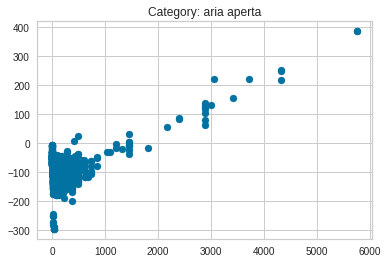

Data dimension: (964, 9447)


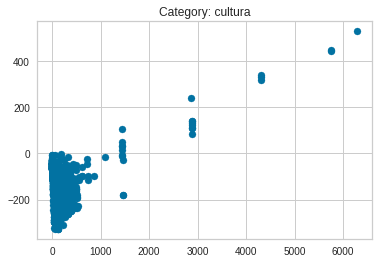

Data dimension: (12, 577)


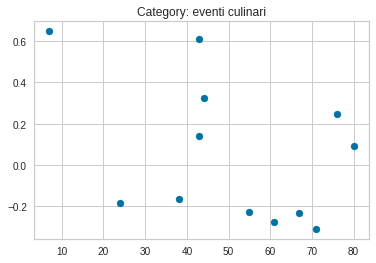

Data dimension: (1269, 8990)


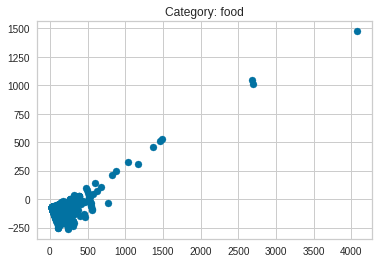

Data dimension: (27, 613)


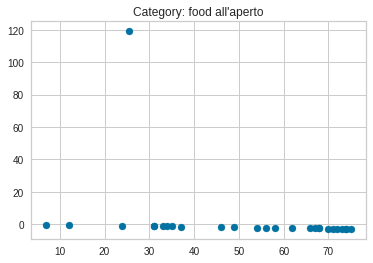

Data dimension: (317, 4285)


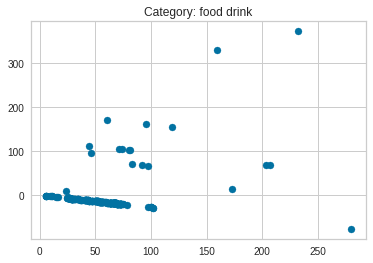

Data dimension: (346, 4573)


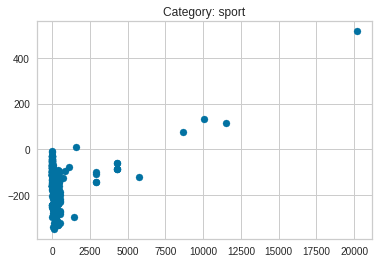

Data dimension: (502, 5278)


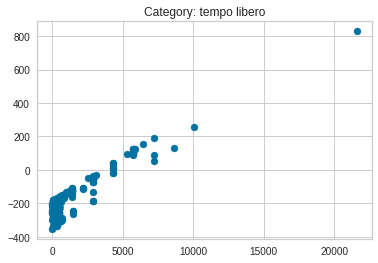

Data dimension: (3, 262)


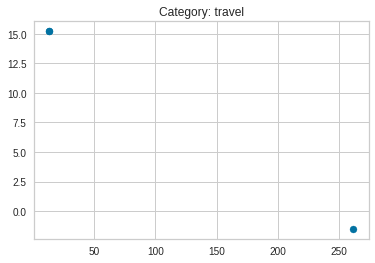

Data dimension: (1324, 13364)


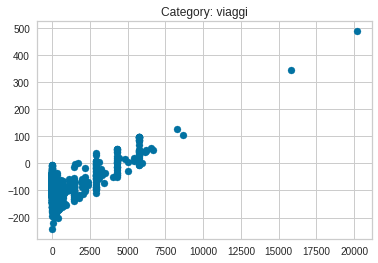

In [ ]:
svd_dict_tfidf = plot_with_SVD_cat(X, categories, tfidf_dict)

Data dimension: (954, 770)


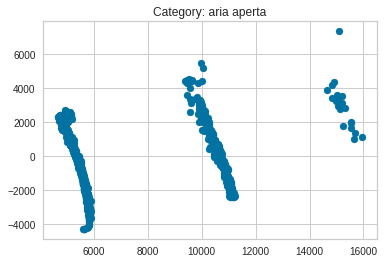

Data dimension: (964, 770)


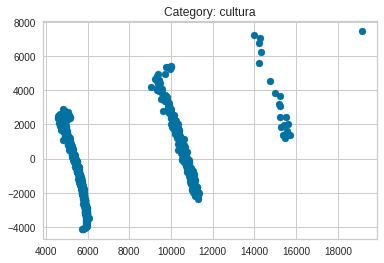

Data dimension: (12, 770)


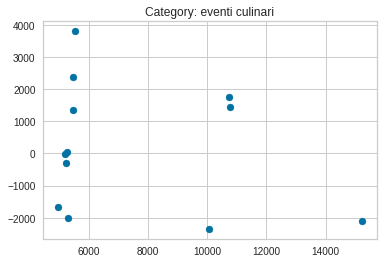

Data dimension: (1269, 770)


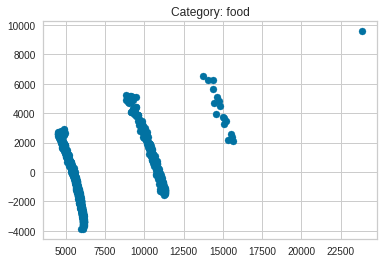

Data dimension: (27, 770)


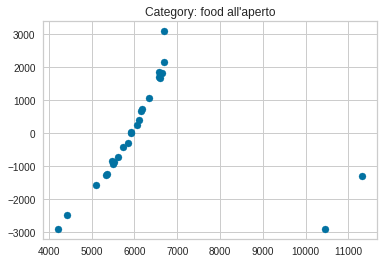

Data dimension: (317, 770)


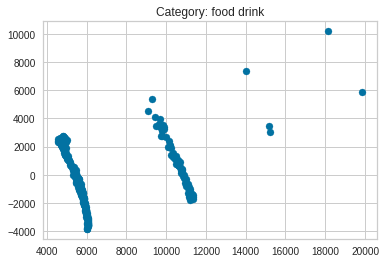

Data dimension: (346, 770)


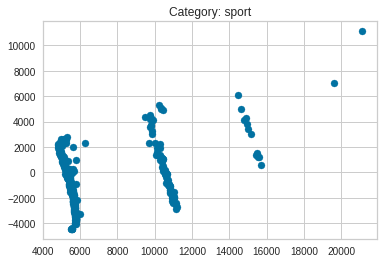

Data dimension: (502, 770)


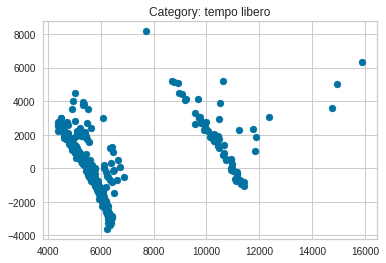

Data dimension: (3, 770)


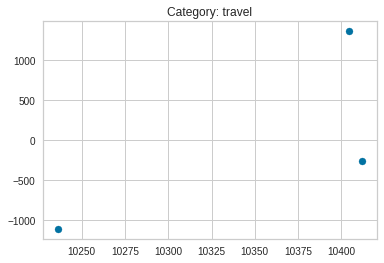

Data dimension: (1324, 770)


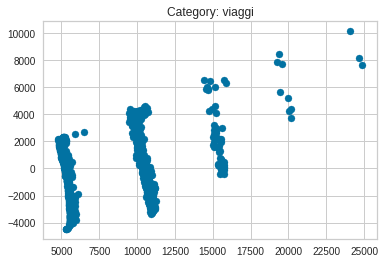

In [ ]:
svd_dict_embeddings = plot_with_SVD_cat(X, categories, embeddings)

In [ ]:
#Plot results
def plotKMeans(label:np.ndarray, df:pd.DataFrame, category:str):
  u_labels = np.unique(label)
  for i in u_labels:
      plt.scatter(df[label == i , 0] , df[label == i , 1] , label = i)
  plt.title('K-means with {} clusters for {}'.format(len(u_labels), category))
  plt.legend()
  plt.show()

In [ ]:
def kmeans_tests(data:pd.DataFrame, category:str, svd_dict:dict, clusters_number:int=10, steps:int=1):
  inertia = []
  times = dict() #{k:time_needed}
  K = range(2,clusters_number,steps) 
  for k in K:
      #Fit 
      start = time.time()
      kmeanModel = KMeans(n_clusters=k)
      kmeans = kmeanModel.fit(data)
      time_needed = time.time() - start
      times[k] = time_needed
      #Elbow
      inertia.append(kmeanModel.inertia_)
      #Clusters
      label = kmeans.predict(data)
      plotKMeans(label, svd_dict[category], category)
  return inertia, times, K

In [ ]:
def elbow_and_statistics(inertia:list, times:dict, K:list):
  #Elbow
  plt.figure(figsize=(10,3))
  plt.plot(K, inertia, 'bx-')
  plt.xlabel('k')
  plt.ylabel('Inertia')
  plt.title('The Elbow Method showing the optimal k')
  plt.show()
  print("\n")
  #Inertia
  for k,value in zip(K, inertia):
    print("Inertia for {} clusters is: {}".format(k,value))
  print("\n")
  #Times needed
  for k,v in times.items():
    print("Time needed to fit kmeans with {} clusters is: {}".format(k,v))

In [ ]:
def elbow_visualizer(data:pd.DataFrame, k:int):
  model = KMeans()
  visualizer = KElbowVisualizer(model, k=k)
  visualizer.fit(data)        
  visualizer.show() 

In [ ]:
def kmeans_computation(data:pd.DataFrame, description_dict:dict, categories:list, svd:dict, k:int, visualizer:bool=False):
  assert type(categories)==list, "Expected list as input not {}".format(type(categories))
  for c in categories:
    print("Category: {}".format(c))
    data_category = data[data[c]!=0]
    descriptions_encodings = pd.DataFrame(description_dict[c], index=data_category.index)
    data_category.drop(columns=categories, inplace=True)
    data_with_encodings = pd.concat([data_category, descriptions_encodings], axis=1, ignore_index=True)
    if visualizer:
      #kmeans
      inertia, times, K = kmeans_tests(data_with_encodings, c, svd, k)
      # Elbow and inertia
      elbow_and_statistics(inertia, times, K)
    else:
      elbow_visualizer(data_with_encodings, k)  

Category: aria aperta


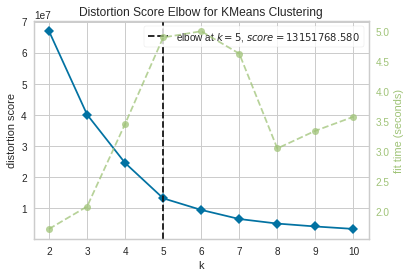

Category: cultura


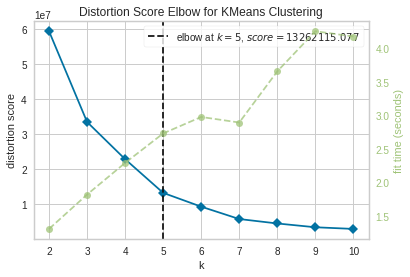

Category: eventi culinari


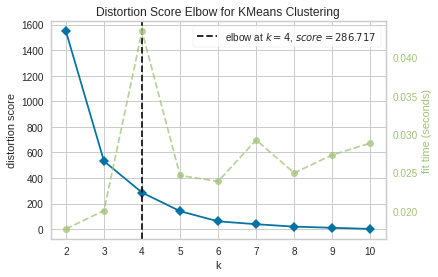

Category: food


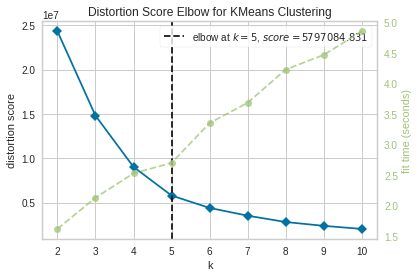

Category: food all'aperto


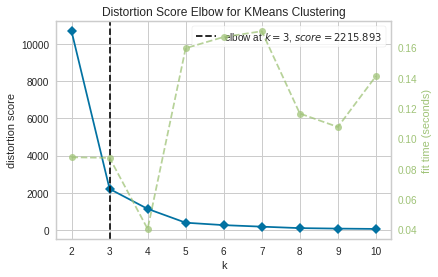

Category: food drink


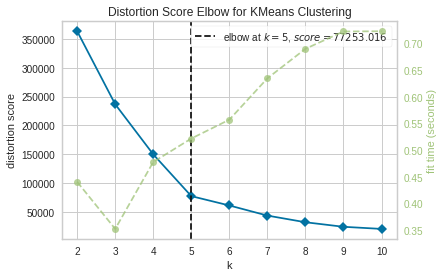

Category: sport


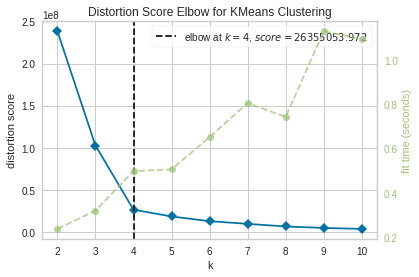

Category: tempo libero


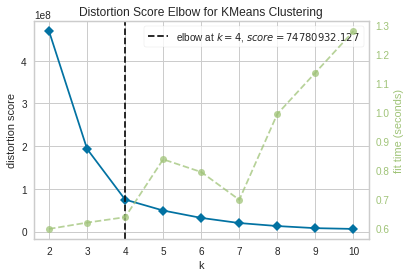

Category: travel


ValueError: ignored

In [ ]:
kmeans_computation(X, tfidf_dict, categories, svd_dict_tfidf, 10)

In [ ]:
kmeans_computation(X, embeddings, categories, svd_dict_embeddings, 10)

## Whole Dataset

In [ ]:
#Plot data using SVD
def plot_with_SVD(data:pd.DataFrame):
  if type(data)==type([]):
    print("Data dimension: {}".format((len(data),len(data[0]))))
  else:
    print("Data dimension: {}".format(data.shape))
  svd = TruncatedSVD(n_components=2, n_iter=7, random_state=42)
  svd = svd.fit_transform(data)
  plt.scatter(svd[:,0], svd[:,1])
  plt.show()
  return svd

In [ ]:
#Plot results
def plotKMeans(label:np.ndarray, df:pd.DataFrame):
  u_labels = np.unique(label)
  for i in u_labels:
      plt.scatter(df[label == i , 0] , df[label == i , 1] , label = i)
  plt.title('K-means with {} clusters'.format(len(u_labels)))
  plt.legend()
  plt.show()

In [ ]:
def kmeans_tests(data:pd.DataFrame, svd_tfidf:dict, clusters_number:int=10, steps:int=1):
  inertia = []
  times = dict() #{k:time_needed}
  K = range(2, clusters_number, steps) 
  for k in K:
      #Fit 
      start = time.time()
      kmeanModel = KMeans(n_clusters=k).fit(data)
      time_needed = time.time() - start
      times[k] = time_needed
      #Elbow
      inertia.append(kmeanModel.inertia_)
      #Clusters
      labels = kmeanModel.labels_
      plotKMeans(labels, svd_tfidf)
  return kmeanModel, inertia, times, K, labels

In [ ]:
def elbow_and_statistics(inertia:list, times:dict, K:list):
  #Elbow
  plt.figure(figsize=(10,3))
  plt.plot(K, inertia, 'bx-')
  plt.xlabel('k')
  plt.ylabel('Inertia')
  plt.title('The Elbow Method showing the optimal k')
  plt.show()
  print("\n")
  #Inertia
  for k,value in zip(K, inertia):
    print("Inertia for {} clusters is: {}".format(k,value))
  print("\n")
  #Times needed
  for k,v in times.items():
    print("Time needed to fit kmeans with {} clusters is: {}".format(k,v))

In [ ]:
def elbow_visualizer(data:pd.DataFrame, k:int):
  model = KMeans()
  visualizer = KElbowVisualizer(model, k=k)
  visualizer.fit(data)        
  visualizer.show() 
  elbow_value = visualizer.elbow_value_
  print("The optimal value for the elbow is {}".format(elbow_value))
  return elbow_value

In [ ]:
def kmeans_computation(data_used:pd.DataFrame, svd, k:int, visualizer:bool=False):
  if visualizer:
    #kmeans
    res_model, inertia, times, K, labels = kmeans_tests(data_used, svd, k)
    # Elbow and inertia
    elbow_and_statistics(inertia, times, K)
  else:
    k_opt = elbow_visualizer(data_used, k) 
    if k_opt is not None:
      res_model = KMeans(n_clusters=k_opt).fit(data_used) 
    else:
      k_in = k
      while k_opt is None:
        print("Cannot find optimal value for the elbow for k={}".format(k))
        k = int(k + k/2)
        if k>= k*4:
          print("Cannot find optimal value for the elbow")
          return None, None
        k_opt = elbow_visualizer(data_used, k)
  return res_model, res_model.labels_

Data dimension: (5724, 768)


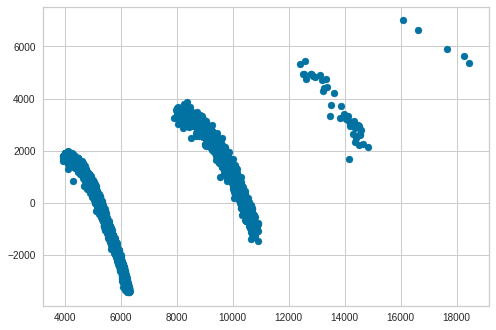

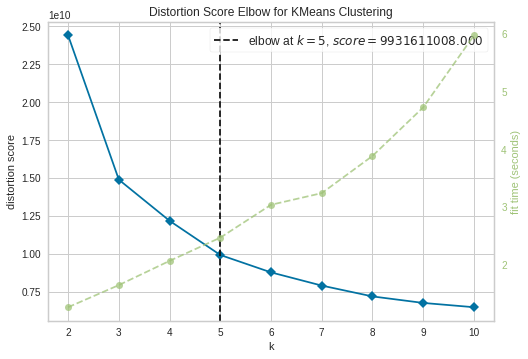

The optimal value for the elbow is 5


In [ ]:
if data_type == "tfidf":
  svd_tfidf = plot_with_SVD(df_tfidf)
  representation_used = df_tfidf
  model_results, labels = kmeans_computation(representation_used, svd_tfidf, 10)
elif data_type == "emb":
  svd_embeddings = plot_with_SVD(embeddings_np)
  representation_used = np.array(embeddings_np)
  model_results, labels = kmeans_computation(representation_used, svd_embeddings, 10)
else: #declutr
  declutr_svd = plot_with_SVD(declutr_emb)
  representation_used = declutr_emb
  model_results, labels = kmeans_computation(representation_used, declutr_svd, 10)

## Results

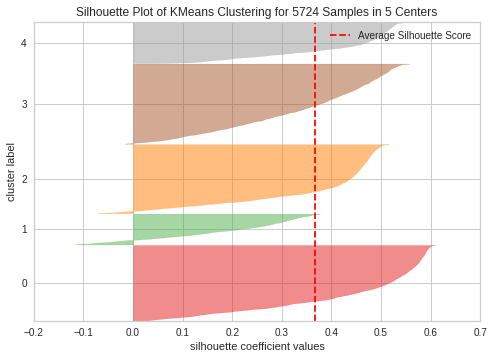

In [ ]:
silhouette_visualizer(model_results, representation_used)

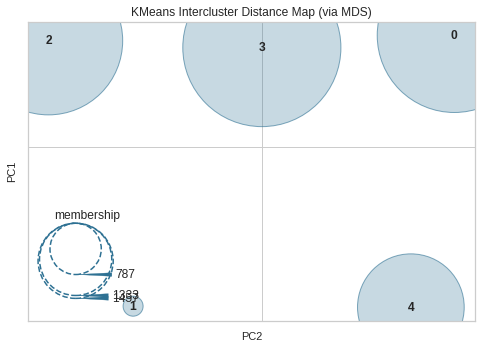

In [ ]:
inter_cluster_distance(model_results, representation_used)

In [ ]:
complete_diameter_dict, avg_diameter_dict, centroid_diameter_dict = intra_cluster_distance(labels, representation_used)

Intra cluster distances for topic 4:
Complete Diameter Distance: 5719.0
Average Diameter Distance: 2133.8797184528485
Centroid Diameter Distance: 158290.92771795572
----------------------------------------------------------------------------------------------------
Intra cluster distances for topic 2:
Complete Diameter Distance: 5722.0
Average Diameter Distance: 1951.3648299462252
Centroid Diameter Distance: 157262.29086131754
----------------------------------------------------------------------------------------------------
Intra cluster distances for topic 0:
Complete Diameter Distance: 5718.0
Average Diameter Distance: 1780.989904741792
Centroid Diameter Distance: 154505.47811644187
----------------------------------------------------------------------------------------------------
Intra cluster distances for topic 1:
Complete Diameter Distance: 5709.0
Average Diameter Distance: 2118.2489179679155
Centroid Diameter Distance: 181773.04223373812
--------------------------------------

In [ ]:
calinski_harabasz(representation_used, labels)

Calinski-Harabasz score (higher is better): 5929.459603035896


In [ ]:
davies_bouldin(representation_used, labels)

Davies-Bouldin score (closer to 0 is better): 1.050172451064763


In [ ]:
get_topics(labels, data)

{4: ['pot',
  'star',
  'mar',
  'ven',
  'punt',
  'zon',
  'acqua',
  'intern',
  'centr',
  'ristor',
  'metr',
  'vol',
  'piazz',
  'percors',
  'sentier',
  'san',
  'local',
  'strad',
  'alcun',
  'spiagg',
  'sal',
  'vist',
  'vis',
  'de',
  'stor'],
 2: ['pot',
  'star',
  'rom',
  'mar',
  'ven',
  'esperit',
  'ristor',
  'centr',
  'zon',
  'acqua',
  'intern',
  'punt',
  'local',
  'parc',
  'vol',
  'isol',
  'piazz',
  'san',
  'vis',
  'muse',
  'dov',
  'lag',
  'stor',
  'piatt',
  'vist'],
 0: ['pot',
  'rom',
  'star',
  'local',
  'mar',
  'ristor',
  'parc',
  'esperit',
  'prezz',
  'centr',
  'ser',
  'intern',
  'giorn',
  'zon',
  'vol',
  'piatt',
  'spiagg',
  'piazz',
  'isol',
  'pizz',
  'dov',
  'qualit',
  'cib',
  'ven',
  'vist'],
 1: ['pot',
  'star',
  'ven',
  'mar',
  'punt',
  'strad',
  'centr',
  'acqua',
  'isol',
  'sentier',
  'zon',
  'intern',
  'piazz',
  'sal',
  'spiagg',
  'alcun',
  'vis',
  'metr',
  'san',
  'lag',
  'dov',
  'e

In [ ]:
pmi(data, labels)

Topic 4, pmi: [('nang', 1.9841948922589385), ('ganesh', 1.9841948922589385), ('kalighat', 1.9841948922589385), ('kuromon', 1.9841948922589385), ('shotenga', 1.9841948922589385), ('tanzan', 1.9841948922589385), ('matal', 1.9841948922589385), ('chup', 1.9841948922589385), ('krapfen', 1.9841948922589385), ('aulett', 1.9841948922589385), ('grimald', 1.9841948922589385), ('discrezion', 1.9841948922589385), ('nobildonn', 1.9841948922589385), ('puntual', 1.9841948922589385), ('morron', 1.9841948922589385), ('pozzett', 1.9841948922589385), ('quegl', 1.9841948922589385), ('3h30', 1.9841948922589385), ('tartar', 1.9841948922589385), ('focalon', 1.9841948922589385), ('abbategg', 1.9841948922589385), ('roccamor', 1.9841948922589385), ('2h30', 1.9841948922589385), ('rimozion', 1.9841948922589385), ('corrett', 1.9841948922589385), ('maresciall', 1.9841948922589385), ('desserts', 1.9841948922589385), ('𝐃𝐄𝐋𝐋𝐀', 1.9841948922589385), ('oreficer', 1.9841948922589385), ('castellin', 1.9841948922589385), (

In [ ]:
topic_diversity(data, labels)

Topic diversity score is: 0.328


({4: 0.04, 2: 0.0, 0: 0.12, 1: 0.0, 3: 0.08}, 0.328)

In [ ]:
c_npmi, c_uci, c_umass, c_v = coherence(data, labels=labels)

c_npmi: -0.00941237545771063
c_uci: -0.09672025871478757
c_umass: -1.6842813976285012
c_v: 0.3237030712393608
----------------------------------------------------------------------------------------------------
c_npmi for each topic: [-0.011831114771754, -0.011407627929291687, -0.006198363757971818, -0.010790221308652446, -0.006834549520883202]
c_uci for each topic: [-0.011831114771754, -0.011407627929291687, -0.006198363757971818, -0.010790221308652446, -0.006834549520883202]
c_umass for each topic: [-0.011831114771754, -0.011407627929291687, -0.006198363757971818, -0.010790221308652446, -0.006834549520883202]
c_v for each topic: 0.3237030712393608


#DBSCAN

In [ ]:
from sklearn.cluster import DBSCAN
from collections import Counter

In [ ]:
#Plot data using SVD
def plot_with_SVD(data:pd.DataFrame):
  if type(data)==type([]):
    print("Data dimension: {}".format((len(data),len(data[0]))))
  else:
    print("Data dimension: {}".format(data.shape))
  svd = TruncatedSVD(n_components=2, n_iter=7, random_state=42)
  svd = svd.fit_transform(data)
  # plt.scatter(svd[:,0], svd[:,1])
  # plt.show()
  return svd

In [ ]:
def plot_dbscan(data:pd.DataFrame, labels:np.ndarray, core_samples_mask:np.ndarray, n_clusters_:int):  
  unique_labels = set(labels)
  colors = [plt.cm.Spectral(each) for each in np.linspace(0, 1, len(unique_labels))]
  for k, col in zip(unique_labels, colors):
      if k == -1:
          # Black used for noise.
          col = [0, 0, 0, 1]

      if(type(data)==type(np.zeros(1))):
        data_array = data
      else:
        data_array = data.to_numpy()
      class_member_mask = labels == k
      xy = data_array[class_member_mask & core_samples_mask]
      plt.plot(
          xy[:, 0],
          xy[:, 1],
          "o",
          markerfacecolor=tuple(col),
          markeredgecolor="k",
          markersize=14,
      )

      xy = data_array[class_member_mask & ~core_samples_mask]
      plt.plot(
          xy[:, 0],
          xy[:, 1],
          "o",
          markerfacecolor=tuple(col),
          markeredgecolor="k",
          markersize=6,
      )

  plt.title("Estimated number of clusters: %d" % n_clusters_)
  plt.show()

## Categories

In [ ]:
def compute_DBSCAN_categories(data:pd.DataFrame, categories:list, description_dict:dict, plot:bool=False):
  dbscan_dict = dict()
  for c in categories:
    data_category = data[data[c]!=0]
    descriptions_encodings = pd.DataFrame(description_dict[c], index=data_category.index)
    data_category.drop(columns=categories, inplace=True)
    data_with_encodings = pd.concat([data_category, descriptions_encodings], axis=1, ignore_index=True)
    clustering = DBSCAN(eps=10, min_samples=10).fit(data_with_encodings)
    dbscan_dict[c] = clustering
    labels = clustering.labels_
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)
    counter = Counter(labels)
    counter = dict(sorted(counter.items(), key=lambda item: item[1], reverse=True))
    print("Category '{}' has {} clusters and {} noisy points\nDistribution of the samples in the clusters: {}\n".format(c, n_clusters_, n_noise_, counter))
    if plot:
      core_samples_mask = np.zeros_like(labels, dtype=bool)
      core_samples_mask[clustering.core_sample_indices_] = True
      plot_dbscan(data_with_encodings, labels, core_samples_mask, n_clusters_)
  return dbscan_dict

Category 'aria aperta' has 9 clusters and 259 noisy points
Distribution of the samples in the clusters: {0: 416, -1: 259, 1: 71, 3: 55, 5: 43, 4: 38, 6: 19, 2: 18, 8: 18, 7: 17}



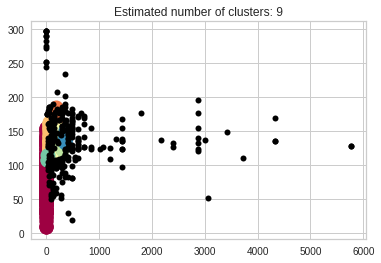

Category 'cultura' has 7 clusters and 355 noisy points
Distribution of the samples in the clusters: {-1: 355, 0: 349, 2: 130, 3: 52, 1: 32, 4: 17, 6: 15, 5: 14}



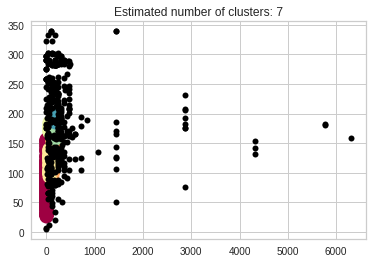

Category 'eventi culinari' has 0 clusters and 12 noisy points
Distribution of the samples in the clusters: {-1: 12}



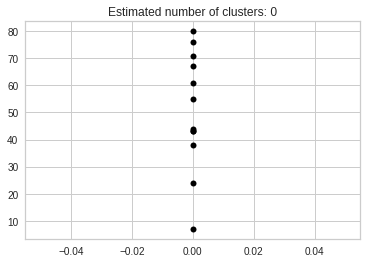

Category 'food' has 9 clusters and 235 noisy points
Distribution of the samples in the clusters: {0: 491, 1: 290, -1: 235, 3: 139, 2: 36, 4: 25, 8: 19, 5: 13, 6: 11, 7: 10}



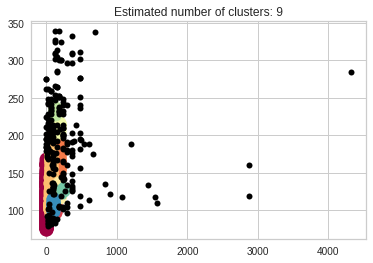

Category 'food all'aperto' has 1 clusters and 12 noisy points
Distribution of the samples in the clusters: {0: 15, -1: 12}



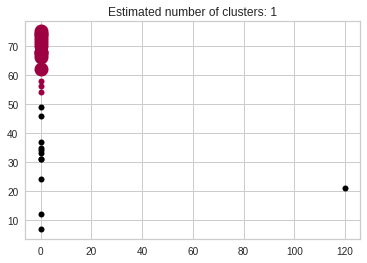

Category 'food drink' has 1 clusters and 26 noisy points
Distribution of the samples in the clusters: {0: 291, -1: 26}



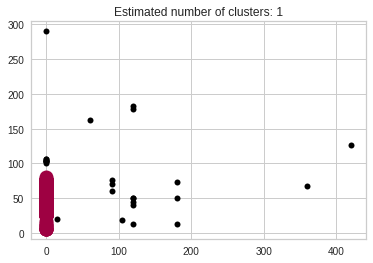

Category 'sport' has 5 clusters and 235 noisy points
Distribution of the samples in the clusters: {-1: 235, 3: 51, 4: 20, 1: 14, 2: 14, 0: 12}



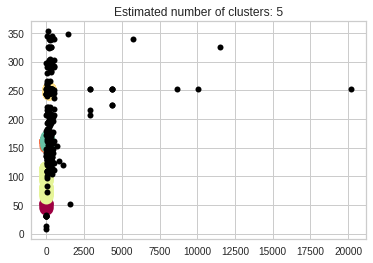

Category 'tempo libero' has 10 clusters and 320 noisy points
Distribution of the samples in the clusters: {-1: 320, 0: 29, 5: 25, 3: 24, 7: 19, 4: 17, 6: 17, 1: 15, 2: 13, 9: 13, 8: 10}



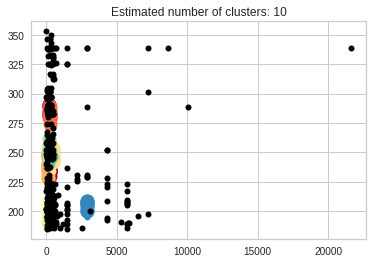

Category 'travel' has 0 clusters and 3 noisy points
Distribution of the samples in the clusters: {-1: 3}



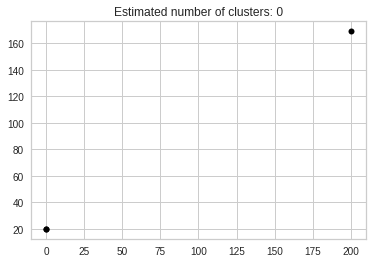

Category 'viaggi' has 13 clusters and 322 noisy points
Distribution of the samples in the clusters: {0: 714, -1: 322, 5: 49, 4: 47, 3: 36, 1: 32, 2: 27, 7: 21, 6: 20, 9: 13, 12: 12, 10: 11, 11: 10, 8: 10}



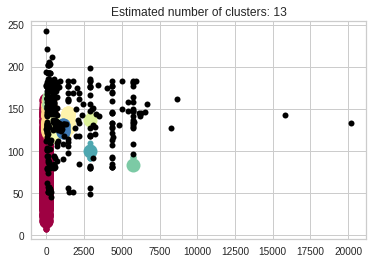

In [ ]:
dbscan_tfidf = compute_DBSCAN_categories(X, categories, tfidf_dict, plot=True)

In [ ]:
dbscan_embeddings = compute_DBSCAN_categories(X, categories, embeddings_dict, plot=True)

## Whole Dataset

In [ ]:
def compute_DBSCAN(data:pd.DataFrame, encodings:list, eps:float, min_samples:int, p:int=2, plot:bool=False):
  clustering = DBSCAN(eps=eps, min_samples=min_samples).fit(encodings)
  labels = clustering.labels_
  n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
  n_noise_ = list(labels).count(-1)
  counter = Counter(labels)
  counter = dict(sorted(counter.items(), key=lambda item: item[1], reverse=True))
  print("The dataset has {} clusters and {} noisy points\nDistribution of the samples in the clusters: {}\n".format(n_clusters_, n_noise_, counter))
  if plot:
    core_samples_mask = np.zeros_like(labels, dtype=bool)
    core_samples_mask[clustering.core_sample_indices_] = True
    plot_dbscan(encodings, labels, core_samples_mask, n_clusters_)
  return clustering, labels

Data dimension: (5724, 768)
The dataset has 0 clusters and 5724 noisy points
Distribution of the samples in the clusters: {-1: 5724}



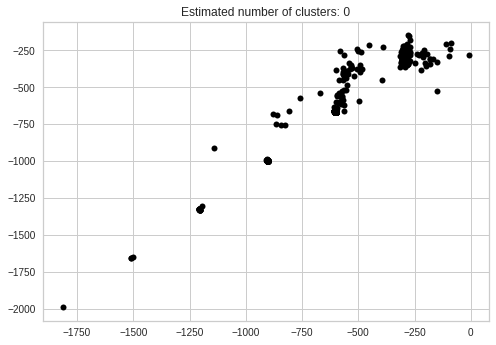

In [ ]:
if data_type == "tfidf":
  svd_tfidf = plot_with_SVD(df_tfidf)
  representation_used = svd_tfidf#df_tfidf
  model_results, labels = compute_DBSCAN(X, representation_used, eps=0.1, min_samples=100, plot=True)
elif data_type == "emb":
  svd_embeddings = plot_with_SVD(embeddings_np)
  representation_used = np.array(embeddings_np)
  model_results, labels = compute_DBSCAN(X, representation_used, eps=0.0001, min_samples=10, plot=True)
else: #declutr
  declutr_svd = plot_with_SVD(declutr_emb)
  representation_used = declutr_svd#declutr_emb
  model_results, labels = compute_DBSCAN(X, representation_used, eps=0.5, min_samples=10, plot=True)

## Results

In [ ]:
#inter_cluster_distance(model_results, representation_used)

In [ ]:
complete_diameter_dict, avg_diameter_dict, centroid_diameter_dict = intra_cluster_distance(labels, representation_used)

KeyboardInterrupt: ignored

In [ ]:
calinski_harabasz(representation_used, labels)

In [ ]:
davies_bouldin(representation_used, labels)

In [ ]:
get_topics(labels, data)

In [ ]:
pmi(data, labels)

In [ ]:
topic_diversity(data, labels=labels)

In [ ]:
c_npmi, c_uci, c_umass, c_v = coherence(data, labels=labels)

# GMM

In [ ]:
from sklearn.mixture import GaussianMixture

In [ ]:
def plot_GMM(gmm, data:pd.DataFrame):
  if(type(data)==type(np.zeros(1))):
    data_array = data
  else:
    data_array = data.to_numpy()
  gmm_labels = gmm.predict(data_array)
  plt.scatter(data_array[:,0], data_array[:,1], c=gmm_labels, cmap='rainbow')
  plt.axis('equal')
  plt.show()

## Categories

In [ ]:
def GMM_categories(data:pd.DataFrame, categories:list, description_dict:dict, plot:bool=False):
  gmm_dict = dict()
  for c in categories:
    data_category = data[data[c]!=0]
    descriptions_encodings = pd.DataFrame(description_dict[c], index=data_category.index)
    data_category.drop(columns=categories, inplace=True)
    data_with_encodings = pd.concat([data_category, descriptions_encodings], axis=1, ignore_index=True)
    gmm = GaussianMixture(n_components=5, random_state=42).fit(data_with_encodings)
    gmm_dict[c] = gmm
    print("Plot of clusters for class {}".format(c))
    plot_GMM(gmm, data_with_encodings)
    #plot_results(data_with_tfidf, gmm.predict(data_with_tfidf), gmm.means_, gmm.covariances_, 0, "Class {}".format(c))
  return gmm_dict

Plot of clusters for class aria aperta


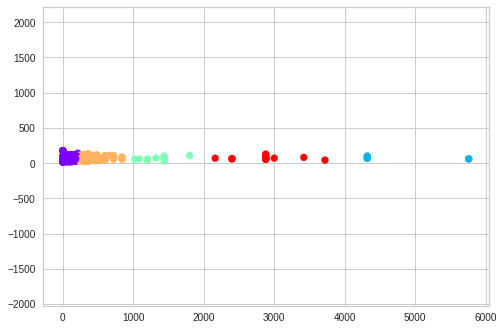

Plot of clusters for class cultura


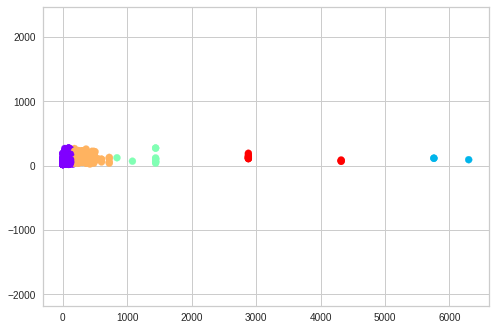

Plot of clusters for class food


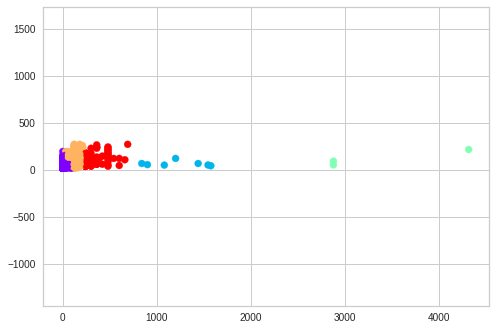

Plot of clusters for class sport


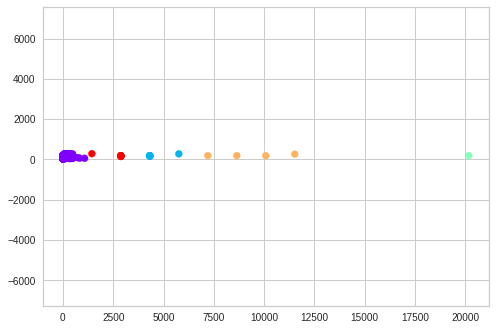

Plot of clusters for class tempo libero


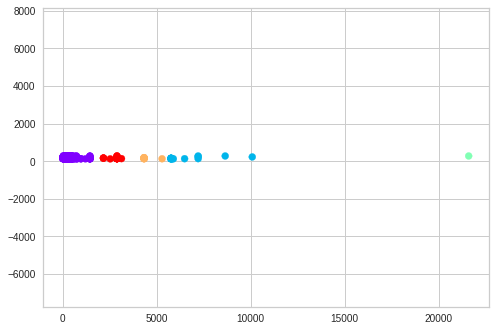

Plot of clusters for class viaggi


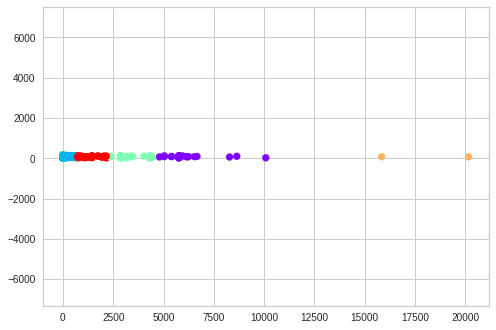

{'aria aperta': GaussianMixture(n_components=5, random_state=42),
 'cultura': GaussianMixture(n_components=5, random_state=42),
 'food': GaussianMixture(n_components=5, random_state=42),
 'sport': GaussianMixture(n_components=5, random_state=42),
 'tempo libero': GaussianMixture(n_components=5, random_state=42),
 'viaggi': GaussianMixture(n_components=5, random_state=42)}

In [ ]:
GMM_categories(X, categories, tfidf_dict, plot=True)

Plot of clusters for class aria aperta


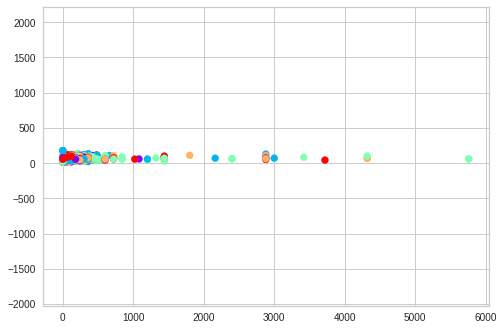

Plot of clusters for class cultura


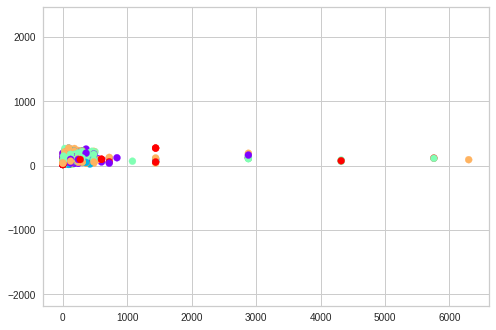

Plot of clusters for class food


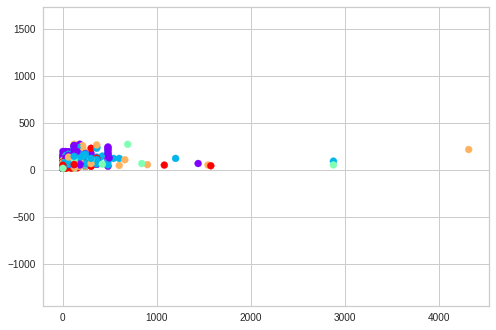

Plot of clusters for class sport


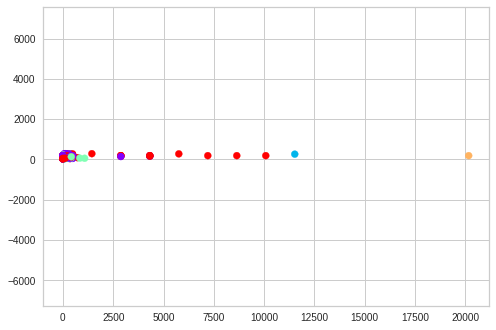

Plot of clusters for class tempo libero


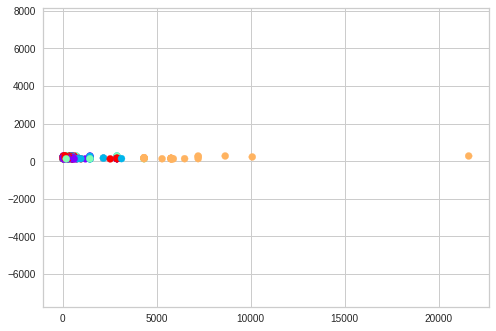

Plot of clusters for class viaggi


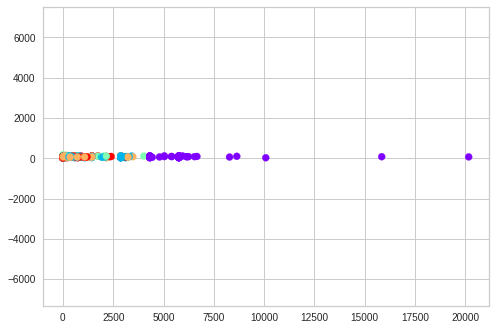

{'aria aperta': GaussianMixture(n_components=5, random_state=42),
 'cultura': GaussianMixture(n_components=5, random_state=42),
 'food': GaussianMixture(n_components=5, random_state=42),
 'sport': GaussianMixture(n_components=5, random_state=42),
 'tempo libero': GaussianMixture(n_components=5, random_state=42),
 'viaggi': GaussianMixture(n_components=5, random_state=42)}

In [ ]:
GMM_categories(X, categories, embeddings, plot=True)

## Whole Dataset

In [ ]:
def GMM_dataset(data_encoded:list, plot:bool=False):
  gmm = GaussianMixture(n_components=5, random_state=42).fit(data_encoded)
  plot_GMM(gmm, data_encoded)
  labels_gmm = gmm.predict(data_encoded)
  return gmm, labels_gmm

In [ ]:
def gmm_print_predictions(labels_gmm):
  predictions = np.unique(labels_gmm, return_counts=True)
  clusters = predictions[0]
  freq = predictions[1]
  for t in zip(clusters,freq):
  print("Cluster {} has {} points".format(t[0], t[1]))

Cluster 0 has 2117 points
Cluster 1 has 1793 points
Cluster 2 has 615 points
Cluster 3 has 1050 points
Cluster 4 has 149 points


In [ ]:
gmm_tfidf, labels_gmm_tfidf = GMM_dataset(df_tfidf, plot=True)

In [ ]:
gmm_print_predictions(labels_gmm_tfidf)

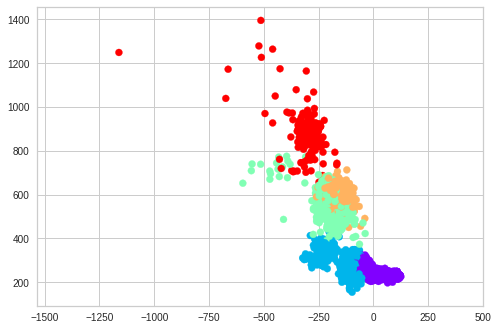

In [ ]:
gmm_embeddings, labels_gmm_emb = GMM_dataset(np.array(embeddings_np), plot=True)

In [ ]:
gmm_print_predictions(labels_gmm_emb)

In [ ]:
gmm_declutr_emb, labels_gmm_declutr = GMM_dataset(declutr_emb, plot=True)

In [ ]:
gmm_print_predictions(labels_gmm_emb)

# UMAP + HDBSCAN

In [ ]:
!pip install hdbscan
!pip install umap-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.2 MB 14.4 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.28-cp37-cp37m-linux_x86_64.whl size=2342084 sha256=3a550a2311da1d5cbb1e0bf3e4d2fb6a179864bcc0b72bbafc83f6d8eddaa45c
  Stored in directory: /root/.cache/pip/wheels/6e/7a/5e/259ccc841c085fc41b99ef4a71e896b62f5161f2bc8a14c97a
Successfully built hdbscan
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 88 kB 5.0 MB/s 
     |████████████████████████████████| 1.1 MB 45.8 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=9cec1c9bd38e36fa2fce9b8bebe8ae4a2924cf7934f4e33c8d207d1c9540d9e4
  Stored in directory: /root/.cache/pip/wheels

In [ ]:
import hdbscan
import umap.umap_ as umap

In [ ]:
def plot_clusters(embeddings, clusters, n_neighbors:int=15, min_dist:float=0.1):
    """
    Reduce dimensionality of best clusters and plot in 2D

    Arguments:
        embeddings: embeddings to use
        clusteres: HDBSCAN object of clusters
        n_neighbors: float, UMAP hyperparameter n_neighbors
        min_dist: float, UMAP hyperparameter min_dist for effective
                  minimum distance between embedded points

    """
    umap_data = umap.UMAP(n_neighbors=n_neighbors, 
                          n_components=2, 
                          min_dist = min_dist,  
                          #metric='cosine',
                          random_state=42).fit_transform(embeddings)

    point_size = 100.0 / np.sqrt(embeddings.shape[0])
    
    result = pd.DataFrame(umap_data, columns=['x', 'y'])
    result['labels'] = clusters.labels_

    fig, ax = plt.subplots(figsize=(14, 8))
    outliers = result[result.labels == -1]
    clustered = result[result.labels != -1]
    plt.scatter(outliers.x, outliers.y, color = 'lightgrey', s=point_size)
    plt.scatter(clustered.x, clustered.y, c=clustered.labels, s=point_size, cmap='jet')
    plt.colorbar()
    plt.show()

In [ ]:
def score_clusters(clusters, prob_threshold:float = 0.05):
    """
    Returns the label count and cost of a given clustering

    Arguments:
        clusters: HDBSCAN clustering object
        prob_threshold: float, probability threshold to use for deciding
                        what cluster labels are considered low confidence

    Returns:
        label_count: int, number of unique cluster labels, including noise
        cost: float, fraction of data points whose cluster assignment has
              a probability below cutoff threshold
    """
    
    cluster_labels = clusters.labels_
    label_count = len(np.unique(cluster_labels))
    total_num = len(clusters.labels_)
    cost = (np.count_nonzero(clusters.probabilities_ < prob_threshold)/total_num)
    
    return cluster_labels, label_count, cost

In [ ]:
def generate_clusters(message_embeddings,
                      n_neighbors:int,
                      n_components:int, 
                      min_cluster_size:int,
                      min_dist:float,
                      min_samples:int = None,
                      random_state:int = None):
    """
    Returns HDBSCAN objects after first performing dimensionality reduction using UMAP
    
    Arguments:
        message_embeddings: embeddings to use
        n_neighbors: int, UMAP hyperparameter n_neighbors
        n_components: int, UMAP hyperparameter n_components
        min_cluster_size: int, HDBSCAN hyperparameter min_cluster_size
        min_samples: int, HDBSCAN hyperparameter min_samples
        random_state: int, random seed
        
    Returns:
        clusters: HDBSCAN object of clusters
    """
    
    umap_embeddings = (umap.UMAP(n_neighbors = n_neighbors, 
                                n_components = n_components, 
                                #metric = 'cosine', 
                                min_dist = min_dist,
                                random_state=random_state)
                            .fit_transform(message_embeddings))

    clusters = hdbscan.HDBSCAN(min_cluster_size = min_cluster_size, 
                               min_samples = min_samples,
                               #metric='euclidean', 
                               gen_min_span_tree=True,
                               cluster_selection_method='eom').fit(umap_embeddings)
    return clusters

## Categories

In [ ]:
def compute_hdbscan_dict(embeddings:dict, 
                         categories:list, 
                         n_neighbors:int = 100, 
                         n_components:int = 2, 
                         min_cluster_size:int = 100,
                         min_dist:float = 0.5): 

  hdbscan_clusters = dict()
  for c in categories:
    print("Clustering category '{}'".format(c))
    try:
      if type(embeddings[c]) == list:
        embeddings_cpu = torch.Tensor(len(embeddings[c]), len(embeddings[c][0]))
        list_emb = [t.unsqueeze(0) for t in embeddings[c]] 
        #print(embeddings_cpu.shape, list_emb[0].shape)
        embeddings_cpu = torch.cat(list_emb, dim=0)
        encodings = embeddings_cpu.cpu()
        #print(embeddings_cpu.device)
      else:
        encodings = embeddings[c]
      hdbscan_clusters[c] = generate_clusters(encodings,
                                              n_neighbors = n_neighbors, 
                                              n_components = n_components, 
                                              min_cluster_size = min_cluster_size,
                                              min_dist = min_dist,
                                              random_state=42)
      labels_def, cost_def = score_clusters(hdbscan_clusters[c])
      print("Number of labels: {}".format(labels_def))
      print("Cost: {}".format(cost_def))
      plot_clusters(encodings,
                    hdbscan_clusters[c],
                    n_neighbors = n_neighbors,
                    min_dist = min_dist)
    except Exception as e:
      print("---> Cannot cluster category '{}' because of error:\n{}".format(c, e))
      #continue
    print()
  return hdbscan_clusters

Clustering category 'aria aperta'
Number of labels: 2
Cost: 0.0


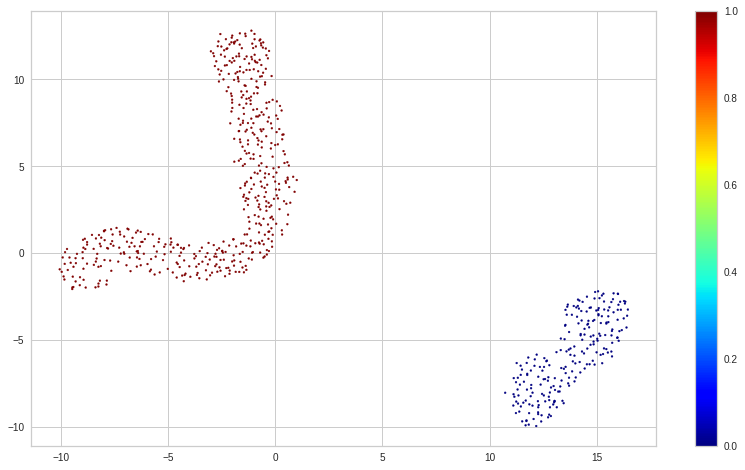


Clustering category 'cultura'
Number of labels: 2
Cost: 0.0


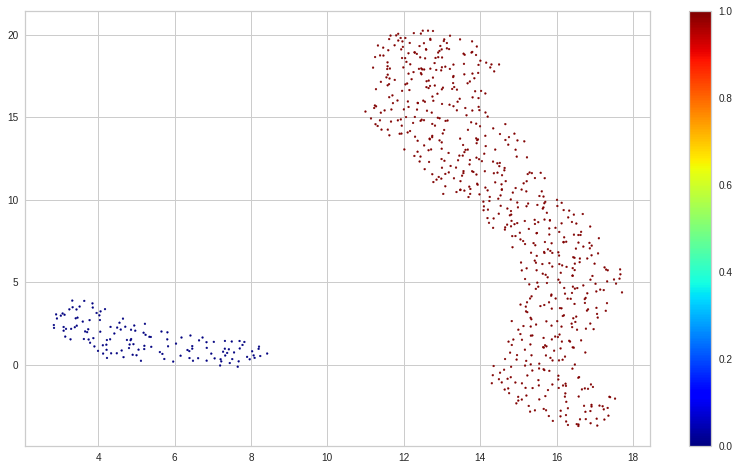


Clustering category 'food'
Number of labels: 2
Cost: 0.0


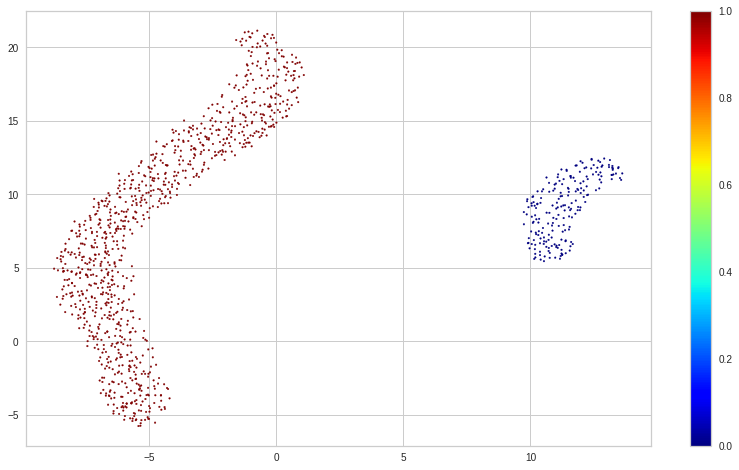


Clustering category 'sport'
Number of labels: 2
Cost: 0.0


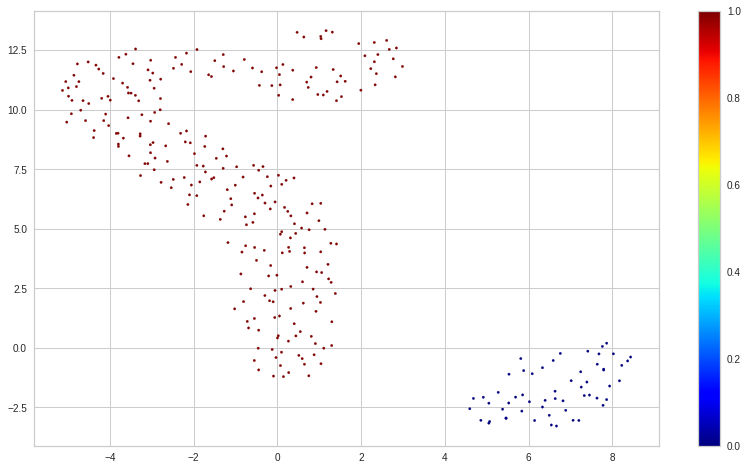


Clustering category 'tempo libero'
Number of labels: 2
Cost: 0.0


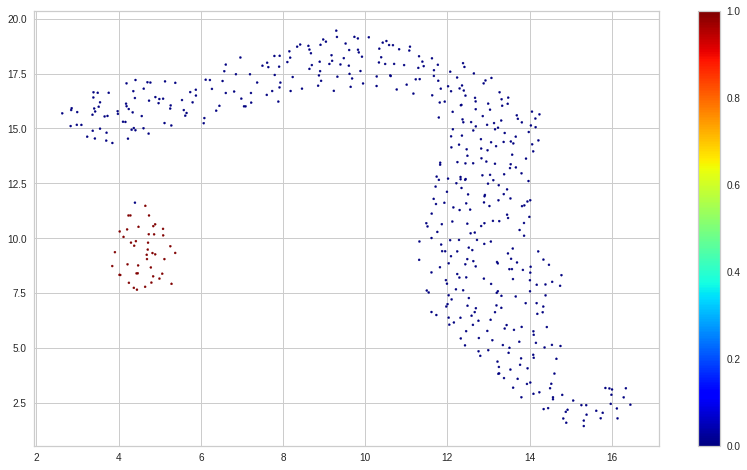


Clustering category 'viaggi'
Number of labels: 2
Cost: 0.0


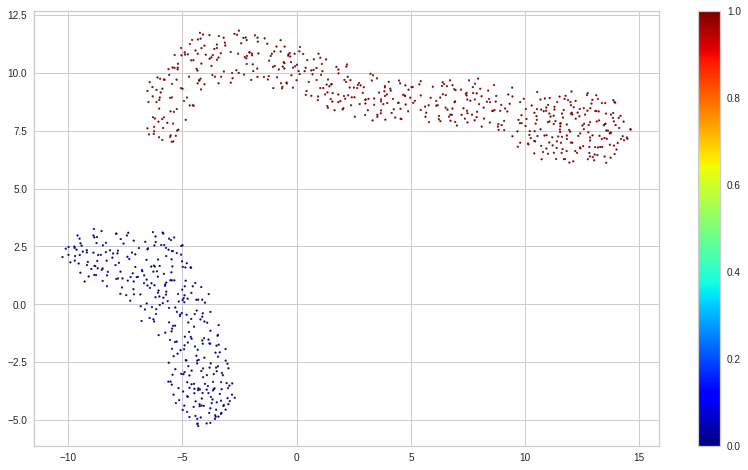

In [ ]:
hdbscan_dict = compute_hdbscan_dict(embeddings, 
                                    categories,
                                    n_neighbors = 200, 
                                    n_components = 2, 
                                    min_cluster_size = 30,
                                    min_dist=0.9)

Clustering category 'aria aperta'
Number of labels: 3
Cost: 0.2506775067750677


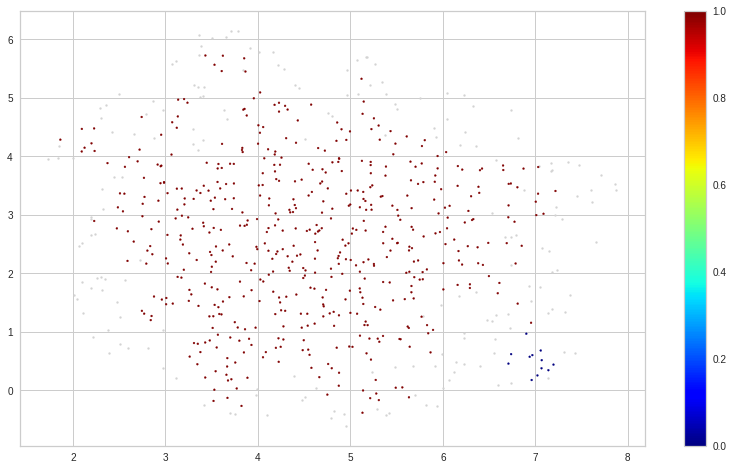


Clustering category 'cultura'
Number of labels: 3
Cost: 0.06060606060606061


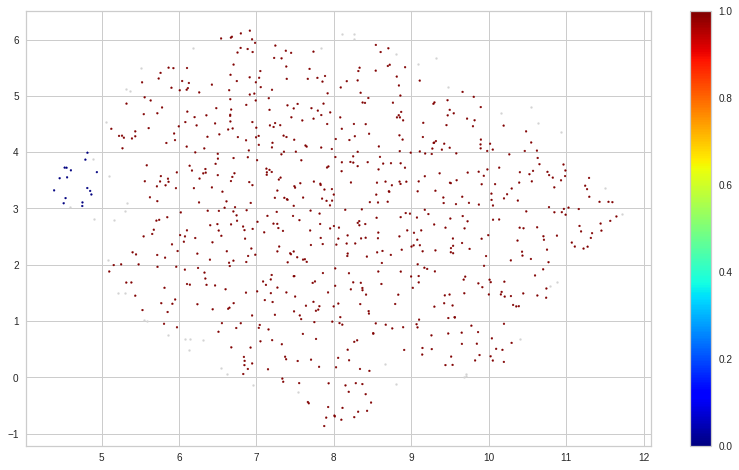


Clustering category 'food'
Number of labels: 2
Cost: 0.0


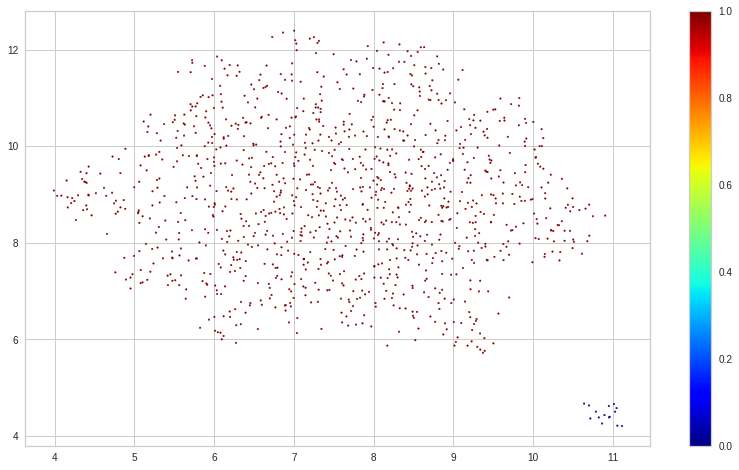


Clustering category 'sport'
Number of labels: 4
Cost: 0.8190184049079755


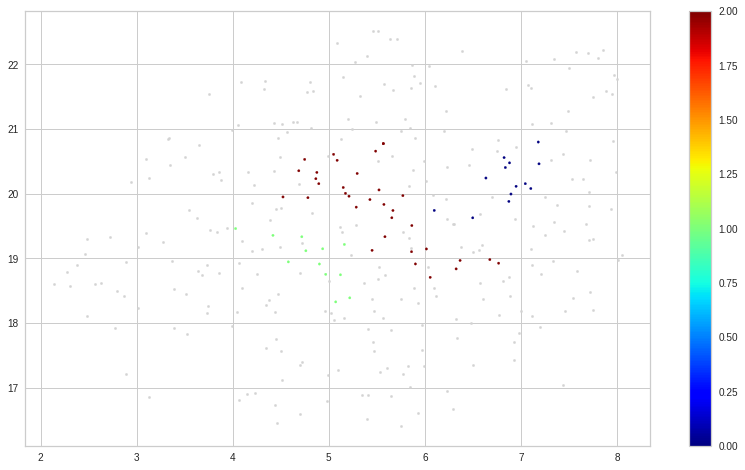


Clustering category 'tempo libero'
Number of labels: 3
Cost: 0.10727969348659004


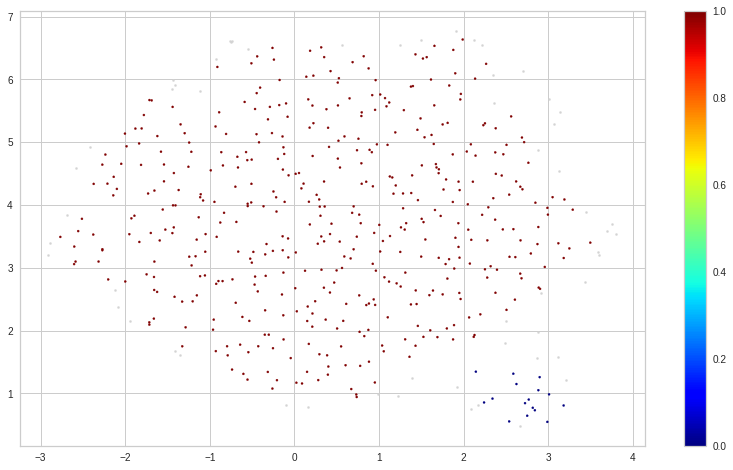


Clustering category 'viaggi'
Number of labels: 3
Cost: 0.14882226980728053


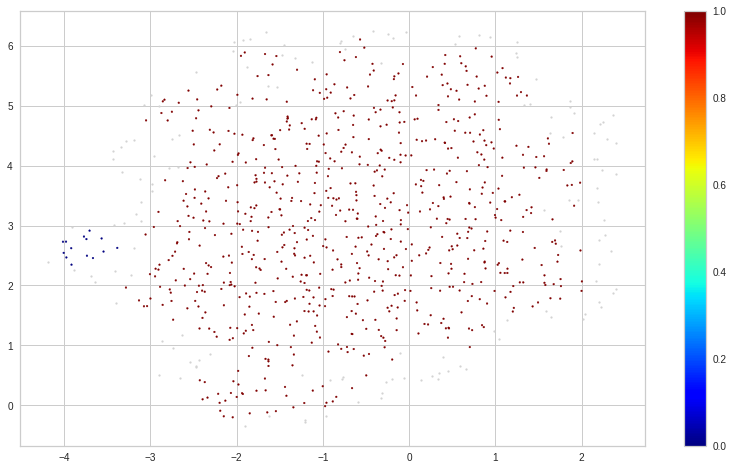

In [ ]:
hdbscan_dict = compute_hdbscan_dict(tfidf_dict,
                                    categories,
                                    n_neighbors = 100, 
                                    n_components = 2, 
                                    min_cluster_size = 10,
                                    min_dist=0.5)

## Whole Dataset

In [ ]:
def compute_hdbscan_dict(embeddings:dict, 
                         n_neighbors:int = 100, 
                         n_components:int = 2, 
                         min_cluster_size:int = 100,
                         min_dist:float = 0.5): 

  try:
    if type(embeddings) != list:
      embeddings_cpu = torch.Tensor(len(embeddings), len(embeddings[0]))
      list_emb = [t.unsqueeze(0) for t in embeddings] 
      #print(embeddings_cpu.shape, list_emb[0].shape)
      embeddings_cpu = torch.cat(list_emb, dim=0)
      encodings = embeddings_cpu.cpu()
      #print(embeddings_cpu.device)
    else:
      encodings = embeddings
    hdbscan_clusters = generate_clusters(encodings,
                                            n_neighbors = n_neighbors, 
                                            n_components = n_components, 
                                            min_cluster_size = min_cluster_size,
                                            min_dist = min_dist,
                                            random_state=42)
    labels, labels_def, cost_def = score_clusters(hdbscan_clusters)
    print("Number of labels: {}".format(labels_def))
    print("Cost: {}".format(cost_def))
    plot_clusters(encodings,
                  hdbscan_clusters,
                  n_neighbors = n_neighbors,
                  min_dist = min_dist)
  except Exception as e:
    print("---> Cannot cluster because of error:\n{}".format(e))
    return None
    #continue
  print()
  return hdbscan_clusters, labels

In [ ]:
if data_type == "tfidf":
  representation_used = df_tfidf
  model_results, labels = compute_hdbscan_dict(representation_used, 
                                    n_neighbors = 200, 
                                    n_components = 2, 
                                    min_cluster_size = 30,
                                    min_dist=0.9)
elif data_type == "emb":
  representation_used = np.array(embeddings_np)
  model_results, labels = compute_hdbscan_dict(representation_used,
                                    n_neighbors = 200, 
                                    n_components = 2, 
                                    min_cluster_size = 30,
                                    min_dist=0.9)
else: #declutr
  representation_used = declutr_emb
  model_results, labels = compute_hdbscan_dict(representation_used,
                                    n_neighbors = 200, 
                                    n_components = 2, 
                                    min_cluster_size = 30,
                                    min_dist=0.9)

In [ ]:
# hdbscan_dict = compute_hdbscan_dict(np.array(embeddings_np),
#                                     n_neighbors = 200, 
#                                     n_components = 2, 
#                                     min_cluster_size = 30,
#                                     min_dist=0.9)

In [ ]:
# hdbscan_dict = compute_hdbscan_dict(df_tfidf, 
#                                     n_neighbors = 200, 
#                                     n_components = 2, 
#                                     min_cluster_size = 30,
#                                     min_dist=0.9)

In [ ]:
# hdbscan_dict = compute_hdbscan_dict(declutr_emb, 
#                                     n_neighbors = 200, 
#                                     n_components = 2, 
#                                     min_cluster_size = 30,
#                                     min_dist=0.9)

## Results

In [ ]:
silhouette_visualizer(model_results, representation_used)

In [ ]:
inter_cluster_distance(model_results, representation_used)

In [ ]:
complete_diameter_dict, avg_diameter_dict, centroid_diameter_dict = intra_cluster_distance(labels, representation_used)

In [ ]:
calinski_harabasz(representation_used, labels)

In [ ]:
davies_bouldin(representation_used, labels)

In [ ]:
get_topics(labels, data)

In [ ]:
pmi(data, labels)

In [ ]:
topic_diversity(data, labels=labels)

In [ ]:
c_npmi, c_uci, c_umass, c_v = coherence(data, labels=labels)

#WEClustering

From [this paper](https://link.springer.com/article/10.1007/s40747-021-00512-9).

The algorithm is also described in my notes (/Clustering/WECustering)

#### Phases 1-2: Preprocess, embeddings extraction and filtration

In [ ]:
!pip install emoji

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 197 kB 34.0 MB/s 
  Created wheel for emoji: filename=emoji-2.0.0-py3-none-any.whl size=193022 sha256=22aee4ad29710d89a905eadebf6fcf379096dc51b53fb56a059ef6e3e1700f15
  Stored in directory: /root/.cache/pip/wheels/ec/29/4d/3cfe7452ac7d8d83b1930f8a6205c3c9649b24e80f9029fc38
Successfully built emoji


In [ ]:
from math import ceil
from tqdm import tqdm

import nltk
nltk.download('punkt')

from nltk.corpus import stopwords
nltk.download('stopwords')
ita_stopwords = set(nltk.corpus.stopwords.words('italian'))

import emoji
import string
punctuation = string.punctuation.replace("#","")
punctuation += '’“”'

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
device = 0
if torch.cuda.is_available():    
    # Tell PyTorch to use the GPU.    
    device = torch.device("cuda")
    print('There are %d GPU(s) available.' % torch.cuda.device_count())
    print('We will use the GPU:', torch.cuda.get_device_name(0))
# If not...
else:
    print('No GPU available, using the CPU instead.')
    device = torch.device("cpu")

There are 1 GPU(s) available.
We will use the GPU: Tesla T4


In [ ]:
class MyTransformer():
    def __init__(
            self,
            pretrained_model_name_or_path: str = "dbmdz/bert-base-italian-cased",
            device: str = 'cpu'
    ):
        super().__init__()
        self.tokenizer = AutoTokenizer.from_pretrained(pretrained_model_name_or_path)
        self.model = AutoModel.from_pretrained(pretrained_model_name_or_path)
        self.model.to(device)
        print("Device used: {}".format(self.model.device))
        self.word_dictionary = dict()
        self.set_w = set()

    def add_special_tokens(self, tokens_ids):
      # add CLS (token_id is 101) and SEP (token_id is 102)
      ids = [101] + tokens_ids + [102]
      # add padding (token_id is 0)
      padding_length = 512-len(ids)
      for i in range(padding_length):
        ids += [0]
      #print("\n padding_length: {} - len(tokens_ids): {}\nTokens_ids: {}".format(padding_length, len(ids), ids))
      return ids

    def compute_embedding(self, tokens_ids):
      self.model.eval()
      with torch.no_grad():
        if(len(tokens_ids) <= 510):
          #tokens_ids = self.add_special_tokens(tokens_ids)
          context_embeddings = self.model(torch.tensor(tokens_ids)[None,:].to(device))[0]
        else:
          k = ceil(len(tokens_ids) / 510.0)
          chunks = np.array_split(tokens_ids, k)
          for i in range(len(chunks)):
            chunks[i] = self.add_special_tokens(chunks[i].tolist())
          chunks_tensor = torch.tensor(chunks[0])[None,:].to(device)
          context_embeddings_list = self.model(chunks_tensor)[0].to(device)
          for i in range(1, len(chunks)):
            chunks_tensor = torch.tensor(chunks[i])[None,:].to(device)
            context_embeddings_list = torch.cat((context_embeddings_list, self.model(chunks_tensor)[0]), 1)
          #dim = context_embeddings_list.shape[-1]
          context_embeddings = context_embeddings_list.to(device)
        #compute the average of the vectors
        #avg_embeddings = torch.sum(context_embeddings,1)[0]
        #print("Embeddings shape: {}".format(context_embeddings.shape))
      return context_embeddings

    def demoji(self, text):
      allchars = [str for str in text] #.decode('utf-8')
      emoji_list = [c for c in allchars if c in emoji.UNICODE_EMOJI]
      clean_text = ' '.join([str for str in text.split() if not any(i in str for i in emoji_list)])
      return clean_text


# I can obtain the embedding of a word by averaging the subwords -> 
# once I have the sentence's embeddings I can transform subwords back to words 
# ## means that the subword has to be attached to the previous one without spaces

    def words_from_subwords(self, emb, tokens:list):
      list_emb = emb.tolist()
      res_tokens = []
      res_emb = []
      for j, t in enumerate(tokens):
        if t[:2] == "##":
          #print(tokens[j-1], tokens[j])
          word = res_tokens[-1] + tokens[j].replace("#", "")
          res_tokens[-1] = word
          emb_mean = [np.mean(k) for k in zip(res_emb[-1], list_emb[0][j])]
          res_emb[-1] = emb_mean
        else:
          res_tokens.append(t)
          res_emb.append(list_emb[0][j])
      return torch.unsqueeze(torch.Tensor(res_emb), 0), res_tokens

    def filter_embeddings(self, emb, tokens:list):
      list_emb = emb.tolist()
      res_tokens = []
      #print(len(list_emb[0]))
      del_count = 0
      for j, t in enumerate(tokens):
        #remove [UNK]
        if t == "[UNK]":
          list_emb[0].pop(j-del_count)
          del_count += 1
        #remove digits
        elif any(ch.isdigit() for ch in t):
          list_emb[0].pop(j-del_count)
          del_count += 1
        #remove punctuation
        elif any(ch in punctuation for ch in t):
          list_emb[0].pop(j-del_count)
          del_count += 1
        #remove stopwords
        elif t.lower() in ita_stopwords: #.replace("#", "")
          list_emb[0].pop(j-del_count)
          del_count += 1
        else:
          res_tokens.append(t)
      return torch.Tensor(list_emb), res_tokens

    def compute_word_dictionary(self, tokens:list, embeddings:list, doc:int):
      for t,e in zip(tokens, embeddings[0]):
        #print("TOKEN: " + t)
        #print("emb shape: {}".format(e.shape))
        if t in self.word_dictionary:
          # add doc -> if a token appears more than once in a document than it will be added multiple times
          self.word_dictionary[t][1].append(doc)
          #print("DICT: {}".format(self.word_dictionary[t]))
          # compute new value for the embeddings of the token
          numb_doc = len(self.word_dictionary[t][1])
          #old_emb = torch.mul(self.word_dictionary[t][0], numb_doc-1) 
          old_emb = self.word_dictionary[t][0]
          assert not True in torch.isinf(old_emb), "Bug in torch.mul: {}".format(torch.isinf(old_emb))
          list_old_emb = [old_emb for i in range(numb_doc-1)]
          #print(len(list_old_emb), numb_doc)
          list_old_emb.append(e)
          new_emb = torch.stack(list_old_emb, dim=0)
          assert not True in torch.isinf(new_emb), "Bug in new_emb: {}".format(new_emb)
          #print("SHAPE: {}".format(new_emb.shape))
          mean = torch.mean(new_emb, dim=0)
          assert not True in torch.isinf(mean), "Bug in torch.mean: {} {} {} {} {}".format(numb_doc, e, self.word_dictionary[t][0], new_emb, mean)
          self.word_dictionary[t][0] = mean
          #print(self.word_dictionary[t][0].shape, self.word_dictionary[t][1])
        else:
          #print("new word")
          self.word_dictionary[t] = [e,[doc]]
          #print(self.word_dictionary[t][0].shape, self.word_dictionary[t][1])

    # check if number of distinct tokens is equal to number of tokens in the dictionary
    def nested_sum(self, L):
        total = 0 
        for i in L:
            if isinstance(i, list):  # checks if `i` is a list
                self.nested_sum(i)
            else:
                self.set_w.add(i)
        return

    def check_number_words(self, tokens):
      self.nested_sum(tokens)
      assert len(self.set_w) == len(self.word_dictionary), "number of tokens in the dictionary is wrong"

    def encode(self, docs):
      embedded_docs = []
      tokens_docs = []
      for id,d in tqdm(enumerate(docs)):
        embedded_sentence = []
        tokens_sentence = []
        sentences =  nltk.tokenize.sent_tokenize(d)
        #print("-"*100)
        #print("ID: {}".format(id))
        for s in sentences:
          #s = self.demoji(s)
          if not s: #df_schede has null descriptions
            print("Empty description")
            empty_embedding = torch.zeros(768).to(device)
            embedded_sentence.append(empty_embedding)
            tokens_sentence.append([])
            continue
          t = self.tokenizer.tokenize(s)
          tokens_ids = self.tokenizer.convert_tokens_to_ids(t)
          #print("Tokens: {}".format(t))
          #print("Number of tokens ids: {}".format(len(tokens_ids)))
          embedding = self.compute_embedding(tokens_ids)
          #print("DIM after compute_embedding: {} {}".format(embedding.shape, len(tokens_ids)))
          #print(t)
          words_emb, words_tokens = self.words_from_subwords(embedding, t)
          #print("DIM after merging of the subwords: {} {}".format(words_emb.shape, len(words_tokens)))
          filtered_emb, filtered_tokens = self.filter_embeddings(words_emb, words_tokens)
          #print("DIM after filter: {} {}".format(filtered_emb.shape, len(filtered_tokens)))
          self.compute_word_dictionary(filtered_tokens, filtered_emb, id)
          embedded_sentence.append(filtered_emb)
          tokens_sentence.append(filtered_tokens)
          #print("After filter: {}".format(filtered_emb.shape))
        embedded_docs.append(embedded_sentence)
        tokens_docs.append(tokens_sentence)
      self.check_number_words(tokens_docs)
      return embedded_docs, tokens_docs

In [ ]:
model = MyTransformer(device=device)
#embeddings, tokens = model.encode(df_schede.description)
#embeddings, tokens = model.encode(data.description_processed.iloc[:2000])
embeddings, tokens = model.encode(data.description.iloc[:2000])

Some weights of the model checkpoint at dbmdz/bert-base-italian-cased were not used when initializing BertModel: ['cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Device used: cuda:0


2000it [17:24,  1.91it/s]


#### Save results in files

In [ ]:
embeddings_path = "/content/drive/MyDrive/Tesi/WEClustering.pt"
tokens_path = "/content/drive/MyDrive/Tesi/WEClustering_tokens.csv"
word_dictionary_path = "/content/drive/MyDrive/Tesi/words.pkl"

In [ ]:
# import pickle
# w_file = open(word_dictionary_path, "wb")
# pickle.dump(model.word_dictionary, w_file)
# w_file.close()

# w_file = open(word_dictionary_path, "rb")
# output = pickle.load(w_file)
# print(output)

In [ ]:
# import csv
# # save embeddings
# torch.save(embeddings, embeddings_path)
# # save tokens
# with open(tokens_path, "w") as f:
#     wr = csv.writer(f)
#     wr.writerows(tokens)

In [ ]:
# import csv
# # load embeddings
# embeddings = torch.load(embeddings_path)
# # load tokens
# with open(tokens_path, 'r') as read_obj:
#     csv_reader = csv.reader(read_obj)
#     tokens = list(csv_reader)
#     #print(tokens)

#### TF-IDF

In [ ]:
import ast
# from list of lists to list of documents
docs = []
for d in tokens:
  doc = []
  for s in d:
    if type(s)==str:
      doc += ast.literal_eval(s)
    else:
      doc += s
  text = " ".join(doc)
  docs.append(text)

In [ ]:
tfidf_vectorizer = TfidfVectorizer(lowercase=False)

#text = data.description
tfidf_schede = tfidf_vectorizer.fit_transform(docs)
dense_text = tfidf_schede.todense()
denselist_text = dense_text.tolist()

dataset_text_tfidf = pd.DataFrame(denselist_text, index=df_schede.description.iloc[:len(tokens)].index,
                                  columns=tfidf_vectorizer.get_feature_names())
dataset_text_tfidf

,ABBAZIA,ABBIGLIAMENTO,ABRUZZO,ADATTA,ADOTTA,ADULTI,AFFOGATO,AGOSTO,AJC,ALBEROBELLO,...,Östermalms,Österreichischen,àLaSu,àciclopiche,àmarine,ànelvento,èuna,Šmartno,Šum,ʿArab
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1997,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1998,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
np.count_nonzero(dataset_text_tfidf)

261532

#### Phase 3: Clustering of word embeddings

Build a matrix of dimension (n_words*768) and use K-means on it. How to build this matrix (not specified in the paper)?

1.   Take average of a certain token occurrences;
2.   Consider all the embeddings as separated words

I am using the first approach

In [ ]:
embs_list = list()
words_array = list()
for k,v in model.word_dictionary.items():
  words_array.append(k)
  embs_list.append(v[0].cpu().detach().numpy())

embs_array = np.array(embs_list)

In [ ]:
embs_array.shape

(38500, 768)

In [ ]:
from sklearn.cluster import MiniBatchKMeans
def compute_clusters(data_array, type_clustering="kmeans"):
  if type_clustering=="kmeans":
    model = KMeans()
  else:
    model = MiniBatchKMeans(random_state=0)#,batch_size=64)
  visualizer = KElbowVisualizer(model, k=range(2,10))
  visualizer.fit(data_array)        
  visualizer.show() 
  elbow = visualizer.elbow_value_
  print(elbow)
  #cluster with optimal number of clusters
  clustering = KMeans(n_clusters=elbow, random_state=0).fit(data_array)
  #clustering = KMeans(n_clusters=elbow).fit(data_array)
  labels = clustering.labels_

  return clustering, labels, elbow

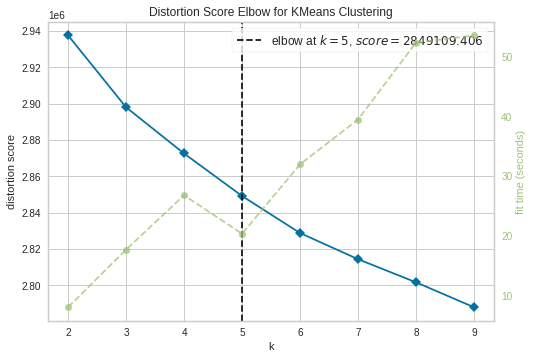

5


In [ ]:
model, labels, elbow = compute_clusters(embs_array)

In [ ]:
np.unique(labels, return_counts=True) 

(array([0, 1, 2, 3, 4], dtype=int32), array([6373, 8729, 8902, 7088, 7408]))

In [ ]:
words_clusters = dict()
for l,w in zip(labels, words_array):
  if l in words_clusters:
    words_clusters[l].append(w)
  else:
    words_clusters[l] = [w]

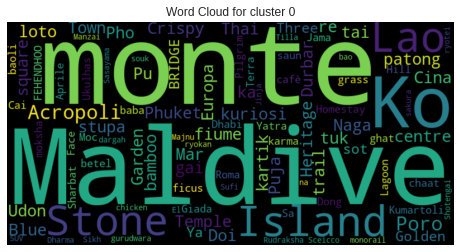

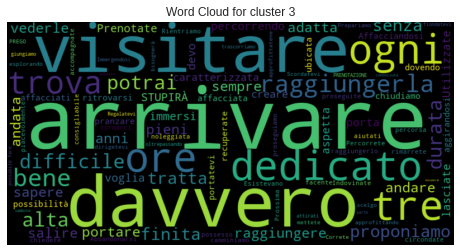

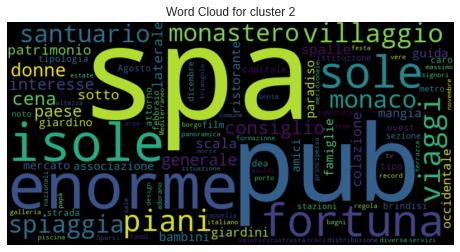

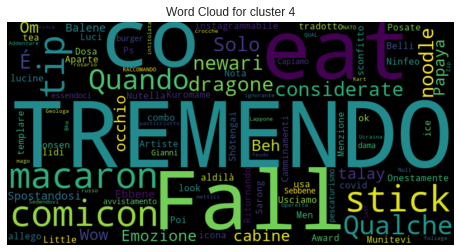

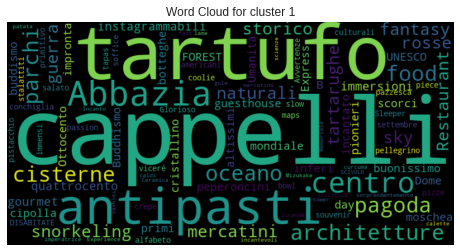

In [ ]:
from wordcloud import WordCloud
for c,w in words_clusters.items():  
  # Create and generate a word cloud image:
  wordcloud = WordCloud(width=800, height=400, max_words = 100).generate(" ".join(w))

  # Display the generated image:
  plt.imshow(wordcloud, interpolation='bilinear')
  plt.axis("off")
  plt.title("Word Cloud for cluster {}".format(c))
  plt.show()

#### Phase 4: Generation of concept-document matrix CD


In [ ]:
labels

array([0, 3, 3, ..., 3, 3, 2], dtype=int32)

In [ ]:
print(len(dataset_text_tfidf.columns), len(words_array), len(labels))

38454 38500 38500


In [ ]:
CD_list = [[] for i in range(len(tokens))]
for c in range(elbow):
  #retrieve tokens in concept
  tokens_index = np.where(labels == c)
  tokens_in_c = []
  for idx in tokens_index[0]:
    tokens_in_c.append(words_array[idx])
  for d in range(len(tokens)):
    #retrieve TF-IDF for the words
    val = 0
    for t in tokens_in_c:
      try:
        val += dataset_text_tfidf[t].iloc[d]
      except:
        continue
    CD_list[d].append(val)

In [ ]:
CD_matrix = np.array(CD_list)

In [ ]:
CD_matrix.shape

(2000, 5)

#### Phase 5: Clustering of the CD matrix

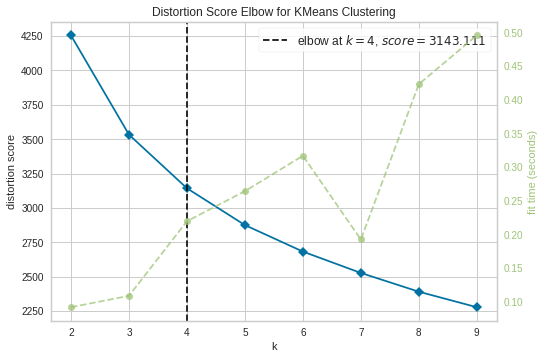

4


In [ ]:
final_model, final_labels, final_elbow = compute_clusters(CD_matrix)

## Results

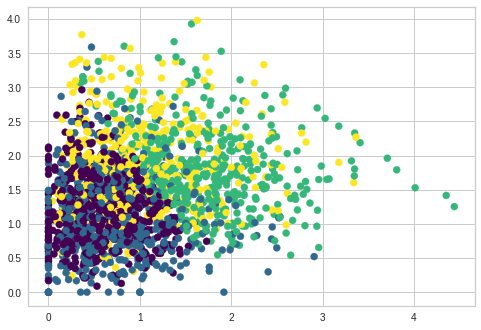

In [ ]:
plt.scatter(CD_matrix[:, 0], CD_matrix[:, 1], c=final_labels, s=50, cmap='viridis')

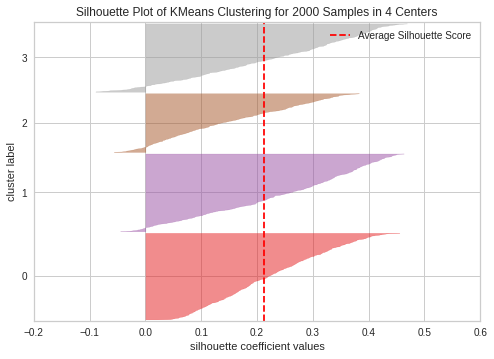

In [ ]:
silhouette_visualizer(final_model, CD_matrix)

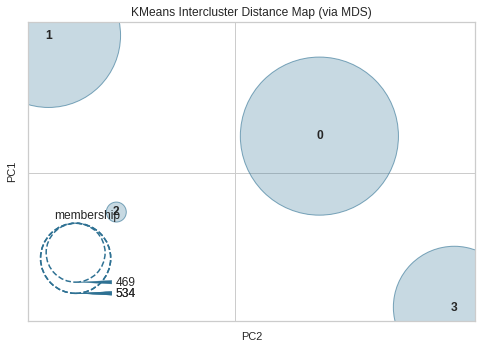

In [ ]:
inter_cluster_distance(final_model, CD_matrix)

In [ ]:
complete_diameter_dict, avg_diameter_dict, centroid_diameter_dict = intra_cluster_distance(final_labels, CD_matrix)

Intra cluster distances for topic 3:
Complete Diameter Distance: 1994.0
Average Diameter Distance: 637.4521713775445
Centroid Diameter Distance: 3816.270137812468
----------------------------------------------------------------------------------------------------
Intra cluster distances for topic 2:
Complete Diameter Distance: 1998.0
Average Diameter Distance: 749.2527931064282
Centroid Diameter Distance: 4435.120562575884
----------------------------------------------------------------------------------------------------
Intra cluster distances for topic 1:
Complete Diameter Distance: 1994.0
Average Diameter Distance: 619.6735811005474
Centroid Diameter Distance: 4746.046340448537
----------------------------------------------------------------------------------------------------
Intra cluster distances for topic 0:
Complete Diameter Distance: 1993.0
Average Diameter Distance: 642.5241453319024
Centroid Diameter Distance: 4731.524373484469
---------------------------------------------

In [ ]:
calinski_harabasz(CD_matrix, final_labels)

Calinski-Harabasz score (higher is better): 810.0633690721564


In [ ]:
davies_bouldin(CD_matrix, final_labels)

Davies-Bouldin score (closer to 0 is better): 1.4483627714963132


In [ ]:
get_topics(labels, data)

In [ ]:
pmi(data, labels)

In [ ]:
topic_diversity(data, labels=final_labels)

{0: 1.0, 1: 1.0, 2: 1.0, 3: 1.0}

In [ ]:
c_npmi, c_uci, c_umass, c_v = coherence(data, labels=final_labels)

c_npmi: 0.1119745112522183
c_uci: 0.24768508285027158
c_umass: -2.9245772937927907
----------------------------------------------------------------------------------------------------
c_npmi for each topic: [0.06023471943796489, 0.28578648375975374, 0.008263768455727613, 0.09361307335542694]
c_uci for each topic: [0.06023471943796489, 0.28578648375975374, 0.008263768455727613, 0.09361307335542694]
c_umass for each topic: [0.06023471943796489, 0.28578648375975374, 0.008263768455727613, 0.09361307335542694]


In [ ]:
np.unique(final_labels, return_counts=True)

(array([0, 1, 2, 3], dtype=int32), array([594, 534, 403, 469]))

In [ ]:
docs_clusters = dict()
for i, l in enumerate(final_labels):
  doc = df_schede.description.iloc[[i]].to_string()
  if l in docs_clusters:
    docs_clusters[l].append(doc)
  else:
    docs_clusters[l] = [doc]

In [ ]:
view = 5
for c,d in docs_clusters.items():
  print("First {} documents in cluster {}".format(view,c))
  for i in range(view):
    print(d[i])
    print("-"*100)
  print("#"*100)  

First 5 documents in cluster 3
0    Phuket è conosciuta per essere la meta predile...
----------------------------------------------------------------------------------------------------
8    Una delle attrazioni più suggestive di tutto l...
----------------------------------------------------------------------------------------------------
13    Quando sono in viaggio, non amo molto partecip...
----------------------------------------------------------------------------------------------------
15    Un'esperienza davvero unica ed indimenticabile...
----------------------------------------------------------------------------------------------------
17    Se amate scoprire luoghi misteriosi, suggestiv...
----------------------------------------------------------------------------------------------------
####################################################################################################
First 5 documents in cluster 2
1    Phuket non è solo spiagge, ci sono anche altri...

# LDA

In [34]:
!pip install pyLDAvis

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [35]:
import gensim
from gensim.test.utils import common_corpus, common_dictionary
import os
import ast

In [36]:
version_data = "processed" #processed raw

In [37]:
if version_data == "processed":
  texts = list(data.description_processed)
  for i,t in enumerate(texts):
    texts[i]= ast.literal_eval(t)
  id2word = gensim.corpora.Dictionary(texts)
  corpus = [id2word.doc2bow(t) for t in texts]
else:
  raw_data = list(data.description)
  texts = []
  for d in raw_data:
    words = d.split()
    texts.append(words)
  id2word = gensim.corpora.Dictionary(texts)
  corpus = [dictionary.doc2bow(text) for text in texts]

In [38]:
# number of topics
num_topics = 20
# Build LDA model
lda_model = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)
# Print the Keyword in the topics
#print(lda_model.print_topics())
doc_lda = lda_model[corpus]

## Results

In [39]:
import re
lda_topics_scores = lda_model.print_topics(num_topics=-1, num_words=10)

lda_topics = []
for t in lda_topics_scores:
  words = t[1]
  list_w = re.split("[*+]", words)
  topic_list = []
  for i,w in enumerate(list_w):
    if i % 2 == 1:
      #print(w)
      topic_list.append(''.join(e for e in w if e.isalnum()))
  lda_topics.append(topic_list)
print(lda_topics)

[['potere', 'giornata', 'venire', 'stare', 'spiaggia', 'esperienza', 'parco', 'acqua', 'alcun', 'interno'], ['potere', 'stare', 'parco', 'lago', 'sentiero', 'isola', 'punto', 'venire', 'acqua', 'monte'], ['potere', 'stare', 'interno', 'parco', 'ristorante', 'sentiero', 'punto', 'acqua', 'zona', 'arte'], ['potere', 'stare', 'piazza', 'centro', 'roma', 'zona', 'san', 'acqua', 'parco', 'punto'], ['potere', 'venire', 'centro', 'museo', 'locale', 'stare', 'zona', 'san', 'roma', 'interno'], ['potere', 'roma', 'centro', 'piazza', 'ristorante', 'interno', 'piatto', 'stare', 'visita', 'mare'], ['potere', 'venire', 'mare', 'acqua', 'interno', 'spiaggia', 'strada', 'centro', 'piazza', 'san'], ['potere', 'visita', 'stare', 'interno', 'roma', 'museo', 'opera', 'venire', 'esperienza', 'palazzo'], ['potere', 'stare', 'mare', 'isola', 'spiaggia', 'interno', 'acqua', 'dovere', 'san', 'punto'], ['potere', 'stare', 'museo', 'centro', 'esperienza', 'venire', 'interno', 'roma', 'carne', 'opera'], ['stare',

In [40]:
topic_diversity(data, topics_list=lda_topics, topk=25)

Topic diversity score is: 0.088


({0: 0.1,
  1: 0.0,
  2: 0.1,
  3: 0.0,
  4: 0.0,
  5: 0.0,
  6: 0.0,
  7: 0.0,
  8: 0.1,
  9: 0.1,
  10: 0.1,
  11: 0.2,
  12: 0.0,
  13: 0.2,
  14: 0.0,
  15: 0.0,
  16: 0.1,
  17: 0.0,
  18: 0.1,
  19: 0.2},
 0.088)

In [41]:
coherence(data, topics_list=lda_topics)

c_npmi: -0.0029556938474064906
c_uci: -0.057125811234431466
c_umass: -1.623405013113094
c_v: 0.3932363311032863
----------------------------------------------------------------------------------------------------
c_npmi for each topic: [-0.009186996815442909, 0.0012785287106670045, -0.017290116847166595, -0.001366352143155477, -0.008692553581917745, -0.005297125011923429, -0.012470706585930573, 0.018964794272941045, -0.0018066259697724987, -0.01326679883796701, -0.016223005468830445, -0.00814512467300378, -0.010835487740201717, -0.012076471327031343, 0.003305520990007665, 0.01880552611947998, 0.008585961674542147, 0.0012334664578501975, -0.026112600122062894, 0.031482289950788576]
c_uci for each topic: [-0.0880733368950256, -0.008706231212740011, -0.16242256436980332, -0.025161450409805185, -0.06762179128076114, -0.06979962627269047, -0.1416749511714067, 0.10687982268617376, -0.051233237109285075, -0.14467780804897526, -0.16803818336990356, -0.13350274561571882, -0.07936921367318882, -

(-0.0029556938474064906,
 -0.057125811234431466,
 -1.623405013113094,
 0.3932363311032863)

In [42]:
import pyLDAvis.gensim_models
import pyLDAvis
# Visualize the topics
#pyLDAvis.enable_notebook()
LDAvis_prepared = pyLDAvis.gensim_models.prepare(lda_model, corpus, id2word, mds='mmds')
pyLDAvis.display(LDAvis_prepared)

# Top2Vec

In [ ]:
!pip install top2vec

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from top2vec import Top2Vec

In [ ]:
version_data = "raw" # processed raw

In [ ]:
if version_data == "processed":
  docs = list(data.description_processed)
else:
  docs = list(data.description)

In [86]:
model_top2vec = Top2Vec(documents=docs, embedding_model="doc2vec", speed="deep-learn")

2022-08-17 13:20:29,696 - top2vec - INFO - Pre-processing documents for training
INFO:top2vec:Pre-processing documents for training
2022-08-17 13:20:34,548 - top2vec - INFO - Creating joint document/word embedding
INFO:top2vec:Creating joint document/word embedding
2022-08-17 13:48:37,984 - top2vec - INFO - Creating lower dimension embedding of documents
INFO:top2vec:Creating lower dimension embedding of documents
2022-08-17 13:48:51,349 - top2vec - INFO - Finding dense areas of documents
INFO:top2vec:Finding dense areas of documents
2022-08-17 13:48:51,534 - top2vec - INFO - Finding topics
INFO:top2vec:Finding topics


In [87]:
num_topics = model_top2vec.get_num_topics()

get_topics returns:

- topic_words: For each topic the top 50 words are returned, in order of semantic similarity to topic.

- word_scores: For each topic the cosine similarity scores of the top 50 words to the topic are returned.

- topic_nums: The unique index of every topic will be returned.

In [88]:
topic_words, word_scores, topic_nums = model_top2vec.get_topics(1)
topic_words, word_scores, topic_nums

(array([['opere', 'artista', 'cappella', 'affreschi', 'opera',
         'michelangelo', 'dipinti', 'pittore', 'affresco', 'statue',
         'raffaello', 'sculture', 'palazzo', 'bernini', 'chiesa',
         'figure', 'pozzo', 'edificio', 'cupola', 'architetto', 'barocco',
         'collezione', 'cristo', 'epoca', 'mostra', 'mosaici',
         'rinascimentale', 'fu', 'scala', 'colonne', 'scultura', 'arte',
         'artistico', 'secoli', 'capolavori', 'museo', 'maria', 'morte',
         'artisti', 'vergine', 'secolo', 'basilica', 'disegni',
         'galleria', 'gesu', 'dipinto', 'facciata', 'xii', 'costruita',
         'monumento']], dtype='<U15'),
 array([[0.37942132, 0.36803576, 0.36394903, 0.3356287 , 0.3271862 ,
         0.32193154, 0.31849867, 0.3104021 , 0.3074981 , 0.30284193,
         0.302587  , 0.2953989 , 0.29417232, 0.27648702, 0.27245378,
         0.2710532 , 0.26704487, 0.2667837 , 0.26563194, 0.26461643,
         0.26387087, 0.25727627, 0.2571821 , 0.25597858, 0.25473613

search_topics returns:

- topic_words: For each topic the top 50 words are returned, in order of semantic similarity to topic.

- word_scores: For each topic the cosine similarity scores of the top 50 words to the topic are returned.

- topic_scores: For each topic the cosine similarity to the search keywords will be returned.

- topic_nums: The unique index of every topic will be returned.

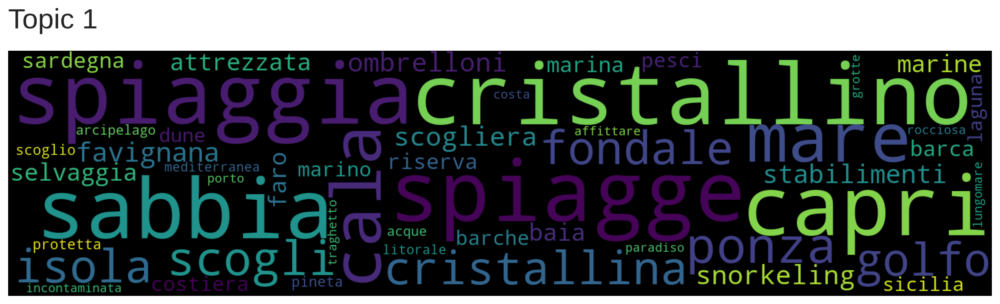

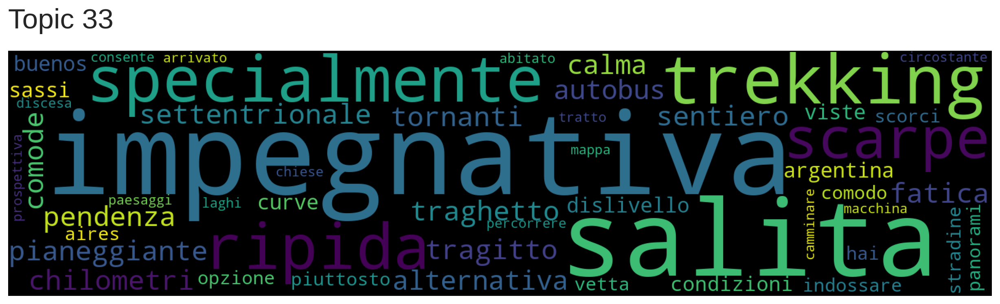

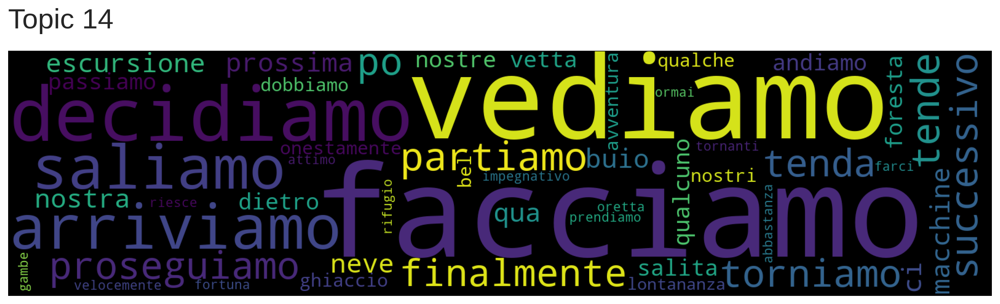

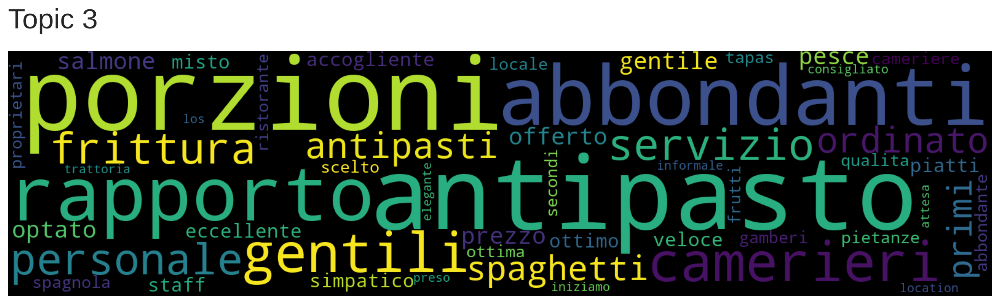

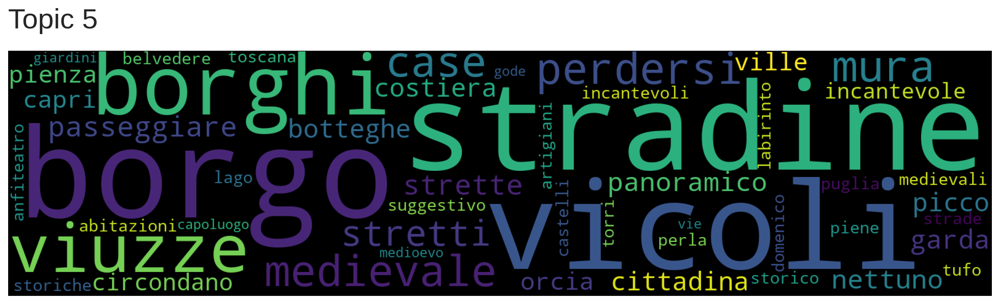

...

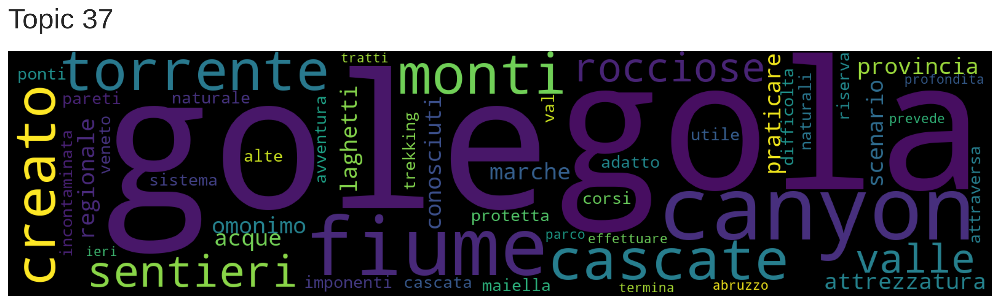

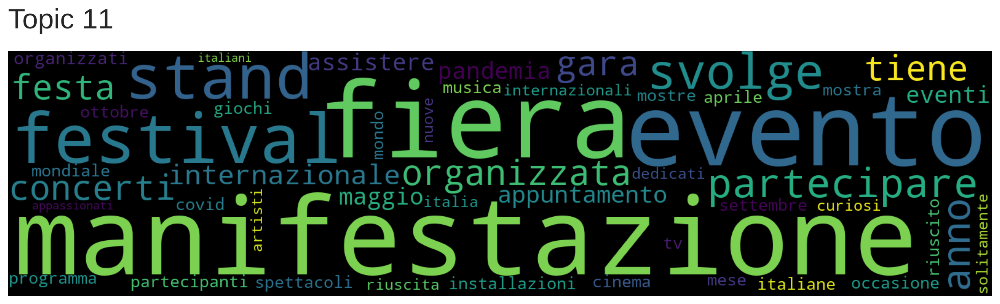

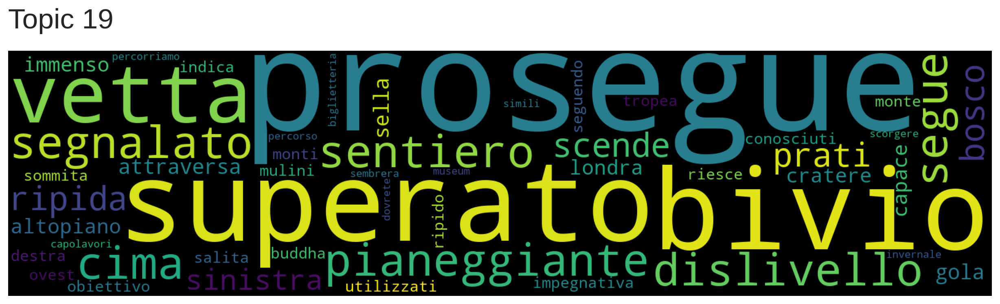

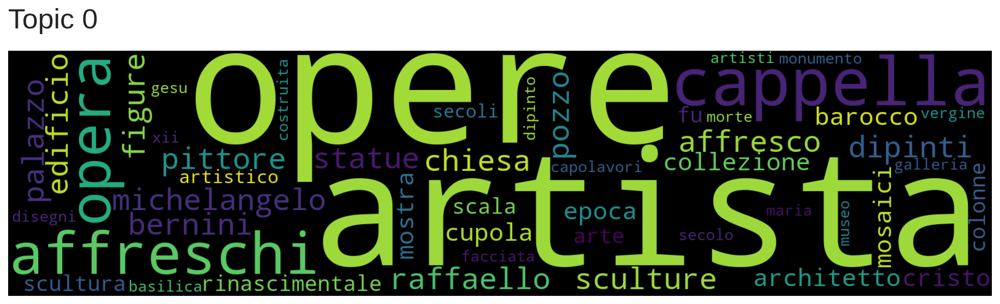

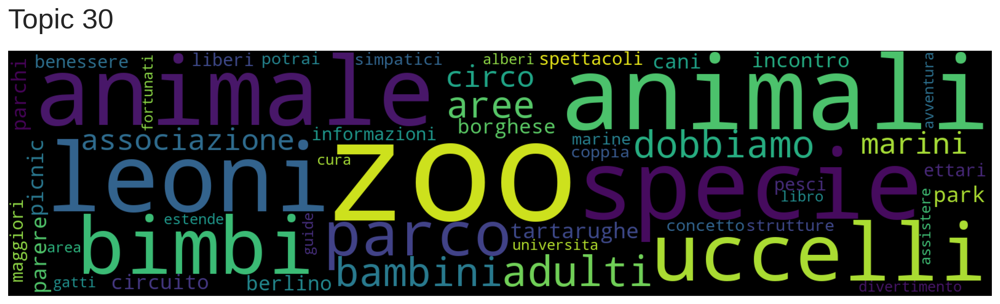

In [89]:
topic_words, word_scores, topic_scores, topic_nums = model_top2vec.search_topics(keywords=["mare"], num_topics=num_topics)
for topic in topic_nums:
    model_top2vec.generate_topic_wordcloud(topic)

search_documents_by_topic returns:

- documents: The documents in a list, the most similar are first.

- doc_scores: Semantic similarity of document to topic. The cosine similarity of the document and topic vector.

- doc_ids: Unique ids of documents. If ids were not given, the index of document in the original corpus

In [90]:
import random

random_topic = random.randint(0, num_topics-1)

documents, document_scores, document_ids = model_top2vec.search_documents_by_topic(topic_num=random_topic, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 1346, Score: 0.5468339920043945
-----------
Quando "viene al mondo" una nuova attività, soprattutto se di stampo culinario, se ne ho la possibilità, mi fiondo a conoscerla e testarla: sono dell'idea, infatti, che un forte sostegno nella fase iniziale sia fondamentale per quanto riguarda la sopravvivenza nel tempo di un nuovo locale, di qualunque genere esso sia. E poi, nel caso specifico del cibo, non si può non avere curiosità per un assaggio! (Oppure sono semplicemente io un golosone?). Forte di questa convinzione, dunque, dopo aver avuto notizia di un "nuovo arrivo" nella zona che bazzico abitualmente, non ho saputo resistere: mi sono munito di cellulare, ho inoltrato l'ordine ed ho aspettato. Chi? "La Beccheria". 

Situata in quel di Mugnano, frazione della città di Napoli, "La Beccheria" può essere definita a tutti gli effetti come una paninoteca "in fasce", poiché ha aperto i battenti in corrispondenza del rush finale del 2021. Nonostante la tenerissima età, però, vi ga

get_topic_sizes returns:

- topic_sizes: The number of documents most similar to each topic.

- topic_nums: The unique index of every topic will be returned.

In [91]:
labels = np.empty([len(data)], dtype=int)
topic_sizes, topic_nums = model_top2vec.get_topic_sizes()
for ts,tn in zip(topic_sizes, topic_nums):
  print("Topic {} has {} documents".format(tn,ts))
  _, _, document_ids = model_top2vec.search_documents_by_topic(topic_num=tn, num_docs=ts)
  for id in document_ids:
    labels[id] = tn
labels

Topic 0 has 504 documents
Topic 1 has 461 documents
Topic 2 has 328 documents
Topic 3 has 234 documents
Topic 4 has 199 documents
Topic 5 has 186 documents
Topic 6 has 173 documents
Topic 7 has 167 documents
Topic 8 has 167 documents
Topic 9 has 152 documents
Topic 10 has 146 documents
Topic 11 has 144 documents
Topic 12 has 142 documents
Topic 13 has 136 documents
Topic 14 has 123 documents
Topic 15 has 116 documents
Topic 16 has 116 documents
Topic 17 has 114 documents
Topic 18 has 111 documents
Topic 19 has 108 documents
Topic 20 has 107 documents
Topic 21 has 97 documents
Topic 22 has 96 documents
Topic 23 has 93 documents
Topic 24 has 92 documents
Topic 25 has 91 documents
Topic 26 has 88 documents
Topic 27 has 88 documents
Topic 28 has 88 documents
Topic 29 has 86 documents
Topic 30 has 83 documents
Topic 31 has 73 documents
Topic 32 has 67 documents
Topic 33 has 65 documents
Topic 34 has 63 documents
Topic 35 has 63 documents
Topic 36 has 60 documents
Topic 37 has 58 documents
T

array([ 9,  9,  6, ..., 38, 38, 38])

## Results

In [92]:
!pip install gensim==4.1.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [93]:
import gensim
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from gensim.models.coherencemodel import CoherenceModel

In [94]:
if version_data == "raw":
  representation_used = []
  for d in docs:
    words = d.split()
    representation_used.append(words)
  dictionary = gensim.corpora.Dictionary(representation_used)
  bow_corpus = [dictionary.doc2bow(text) for text in representation_used]

In [95]:
if version_data == "processed":
  representation_used = list(data.description_processed.apply(ast.literal_eval))
  dictionary = gensim.corpora.Dictionary(representation_used)
  bow_corpus = [dictionary.doc2bow(text) for text in representation_used]

In [96]:
def get_topics_words(labels, docs):
  topics_words = dict()
  for i in range(len(labels)):
    if version_data == "raw":
      text = ast.literal_eval(data.description_processed.iloc[i])
    else:
      text = docs[i]
    if labels[i] in topics_words:
      topics_words[labels[i]] += text
    else: 
      topics_words[labels[i]] = text
  return topics_words

In [97]:
def get_count(t:tuple):
  return t[1]
  
def get_topics(labels, docs, n = 25, print_topics=False):
  #get list of words for each topic
  topics_words = get_topics_words(labels, docs)
  #count words in topics
  topics_count_words = dict()
  for k in topics_words.keys():
    count_words = np.unique(np.array(topics_words[k]), return_counts=True)
    topics_count_words[k] = count_words
  #get 25 top words for each topic
  topics_topn = dict()
  for k in topics_count_words.keys():
    heap = []
    heapq.heapify(heap)
    for w,c in zip(topics_count_words[k][0], topics_count_words[k][1]):
      heapq.heappush(heap, (w,c))
    topics_topn[k] = heapq.nlargest(n, heap, key=get_count) 
  ## Print topics
  if print_topics==True:
    print("Topics:")
    for a in topics_topn.keys():
      print(a, topics_topn[a])
  #I want just the words, not the counts
  top_words_topics = dict()
  for t,words_list in topics_topn.items():
    top_words_topics[t] = []
    for w in words_list:
      top_words_topics[t].append(w[0])
  return top_words_topics

In [98]:
print(get_topics(labels, representation_used))

{9: ['potere', 'tempio', 'stare', 'interno', 'venire', 'moschea', 'statua', 'buddha', 'centro', 'visita', 'fiume', 'templi', 'edificio', 'ingresso', 'strada', 'zona', 'secolo', 'storia', 'piazza', 'fiore', 'metro', 'punto', 'acqua', 'mahal', 'nome'], 6: ['parco', 'potere', 'roma', 'bambino', 'area', 'lago', 'giornata', 'passeggiata', 'stare', 'villa', 'zona', 'famiglia', 'natura', 'percorso', 'sentiero', 'acqua', 'gioco', 'interno', 'amico', 'animale', 'giardino', 'aria', 'nic', 'punto', 'ristorante'], 38: ['potere', 'stare', 'viaggio', 'treno', 'montagna', 'sito', 'metro', 'percorso', 'zona', 'machu', 'punto', 'esperienza', 'lago', 'natura', 'perù', 'ponte', 'picchu', 'valle', 'strada', 'piede', 'venire', 'nome', 'sentiero', 'villaggio', 'dovere'], 1: ['spiaggia', 'mare', 'isola', 'potere', 'acqua', 'stare', 'costa', 'grotta', 'zona', 'barca', 'giornata', 'colore', 'punto', 'sabbia', 'tramonto', 'sole', 'esperienza', 'porto', 'strada', 'vista', 'ristorante', 'dovere', 'piede', 'natura

In [99]:
def topic_diversity_score(topics, topk):  
  unique_words = set()
  for topic in topics.values():
      unique_words = unique_words.union(set(topic))
  td = len(unique_words) / (topk * len(topics))
  return td

In [100]:
def get_count(t:tuple):
  return t[1]

def topic_diversity(docs, labels=None, topics_list=None, topk=25):
  if topics_list is None:
    #get topics
    topics_topk = get_topics(labels, docs, topk)
  else:
    topics_topk = dict()
    for id,t in enumerate(topics_list):
      topics_topk[id] = t[:topk]
  #compute diversity
  topics_diversity = dict()
  for k1 in topics_topk.keys():
    words = topics_topk[k1]
    not_unique_words = 0
    #nuw = dict()
    for w in words:
      for k2 in topics_topk.keys():
        if k2 == k1:
          continue
        if w in topics_topk[k2]:
          not_unique_words += 1
          # if k1 in nuw:
          #   nuw[k1].append(w)
          # else:
          #   nuw[k1] = [w]
          break
    percentage = (len(words) - not_unique_words)/len(words)
    topics_diversity[k1] = percentage
    # print("Topic {} has {} words that are not unique".format(k1, not_unique_words))
    # if k1 in nuw:
    #   print("Not unique words for topic {} are: {}".format(k1, nuw[k1]))
    # else:
    #   print("{} has no not unique words".format(k1))
  #return result
  td_score = topic_diversity_score(topics_topk, topk)
  print("Topic diversity score is: {}".format(td_score))
  return topics_diversity, td_score

In [101]:
topic_diversity(representation_used, labels=labels)

Topic diversity score is: 0.3029787234042553


({9: 0.16,
  6: 0.08,
  38: 0.16,
  1: 0.12,
  31: 0.16,
  18: 0.16,
  30: 0.08,
  15: 0.2,
  46: 0.28,
  17: 0.2,
  5: 0.0,
  8: 0.12,
  26: 0.24,
  2: 0.16,
  11: 0.32,
  4: 0.16,
  14: 0.04,
  35: 0.16,
  19: 0.04,
  12: 0.08,
  10: 0.24,
  32: 0.2,
  22: 0.4,
  39: 0.16,
  25: 0.32,
  24: 0.08,
  44: 0.12,
  20: 0.24,
  3: 0.04,
  42: 0.16,
  13: 0.32,
  0: 0.08,
  33: 0.0,
  36: 0.28,
  16: 0.24,
  37: 0.08,
  7: 0.16,
  21: 0.12,
  45: 0.24,
  23: 0.24,
  28: 0.16,
  40: 0.12,
  29: 0.12,
  43: 0.28,
  27: 0.16,
  41: 0.32,
  34: 0.28},
 0.3029787234042553)

In [102]:
def coherence(docs, labels=None, topics_list=None):
  if topics_list is None:
    topics = get_topics(labels, docs)
    topics_keys = list(topics.keys())
    topics_list = [topics[k] for k in topics_keys]
    
  c_npmi = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="c_npmi")
  c_umass = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="u_mass")
  c_uci = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="c_uci")
  c_v = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="c_v")
  #results
  coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v = c_npmi.get_coherence(), c_uci.get_coherence(), c_umass.get_coherence(), c_v.get_coherence()
  coherence_c_npmi_topics, coherence_c_uci_topics, coherence_c_umass_topics, coherence_c_v_topics = c_npmi.get_coherence_per_topic(), c_uci.get_coherence_per_topic(), c_umass.get_coherence_per_topic(), c_v.get_coherence_per_topic()
  print("c_npmi: {}\nc_uci: {}\nc_umass: {}\nc_v: {}".format(coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v))
  print("-"*100)
  print("c_npmi for each topic: {}\nc_uci for each topic: {}\nc_umass for each topic: {}\nc_v for each topic: {}".format(coherence_c_npmi_topics, coherence_c_uci_topics, coherence_c_umass_topics, coherence_c_v_topics))
  return coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v

In [103]:
c_npmi, c_uci, c_umass, c_v = coherence(representation_used, labels=labels)

c_npmi: -0.2146542176219682
c_uci: -6.2596178830750855
c_umass: -5.13383612314975
c_v: 0.3749240652081001
----------------------------------------------------------------------------------------------------
c_npmi for each topic: [-0.2570396293335974, -0.2453044225833626, -0.23069123920606588, -0.12813135773981071, -0.2589349626672079, -0.1319074084932619, -0.287737316135149, -0.30165727718108887, -0.28169449491473025, -0.18376665520687796, -0.1726478192608362, -0.13620762697421854, -0.27128089232822705, -0.17167941787527788, -0.29018525039452275, -0.254077791291258, -0.16787569297150454, -0.28569425344910293, -0.10374457886000087, -0.20753267816400983, -0.2152979636556045, -0.29577139796646756, -0.18579269162289927, -0.2069618555730281, -0.1690667972362752, -0.21112736780580765, -0.21375328422669745, -0.28703519301794633, -0.09197532340036317, -0.23350517513430552, -0.1400995202676153, -0.21432415125228216, -0.1974813889222858, -0.294426420699849, -0.21817498968943416, -0.228352804431

# BERTopic

In [70]:
!pip install bertopic
!pip install distributed==2021.9.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [71]:
from bertopic import BERTopic
topic_model = BERTopic(language="multilingual", calculate_probabilities=True)

In [72]:
version_data = "raw" #processed raw

In [73]:
if version_data == "processed":
  data_used = data.description_processed
else:
  data_used = data.description

In [74]:
topics, probs = topic_model.fit_transform(data_used)

In [75]:
topic_model.get_topic_info()

,Topic,Count,Name
0,-1,1911,-1_di_il_la_un
1,0,1183,0_di_un_con_il
2,1,443,1_isola_mare_spiaggia_di
3,2,171,2_chiesa_la_della_del
4,3,164,3_museo_opere_arte_la
...,...,...,...
59,58,11,58_foto_bambini_gladiatori_pascal
60,59,11,59_scozia_irlanda_dublino_birra
61,60,10,60_grotte_sono_acqua_frasassi
62,61,10,61_venezia_marco_gondola_carnevale


In [79]:
import random

num_topics = len(topic_model.get_topic_info().Topic)
random_topic = random.randint(0, num_topics-1)
topic_model.get_topic(random_topic)

[('lago', 0.06551381365332334),
 ('il', 0.01638469032614444),
 ('del', 0.016282552745072284),
 ('di', 0.013684524854529808),
 ('si', 0.013025527198196121),
 ('un', 0.011620917278624526),
 ('in', 0.011598929615596559),
 ('che', 0.010980225138862395),
 ('per', 0.010409130864665952),
 ('una', 0.01027548081658392)]

In [80]:
topic_model.visualize_topics()

In [81]:
topic_model.visualize_barchart()

In [82]:
topic_model.visualize_distribution(probs[200], min_probability=0.0015)

In [83]:
topic_model.visualize_hierarchy(top_n_topics=50)

In [84]:
topic_model.visualize_heatmap(n_clusters=20, width=1000, height=1000)

In [85]:
similar_topics, similarity = topic_model.find_topics("sole", top_n=5); similar_topics

[1, 5, 0, -1, 22]

In [86]:
topics = []
topics_list = topic_model.get_topic_info().Topic
for i in topics_list:
  topics_scores = topic_model.get_topic(i)
  topic_i = []
  for t in topics_scores:
    topic_i.append(t[0])
  cleaned_topic = list(dict.fromkeys(topic_i))
  topics.append(cleaned_topic)

In [87]:
topics

[['di', 'il', 'la', 'un', 'che', 'in', 'per', 'una', 'si', 'del'],
 ['di', 'un', 'con', 'il', 'che', 'la', 'per', 'non', 'in', 'una'],
 ['isola', 'mare', 'spiaggia', 'di', 'la', 'un', 'che', 'per', 'una', 'in'],
 ['chiesa', 'la', 'della', 'del', 'di', 'san', 'il', 'che', 'nel', 'piazza'],
 ['museo', 'opere', 'arte', 'la', 'di', 'il', 'del', 'della', 'che', 'in'],
 ['pizza',
  'pizze',
  'pizzeria',
  'la',
  'napoli',
  'di',
  'non',
  'una',
  'con',
  'sono'],
 ['sentiero', 'rifugio', 'il', 'monte', 'in', 'la', 'di', 'si', 'un', 'una'],
 ['di', 'la', 'che', 'il', 'del', 'in', 'per', 'un', 'si', 'della'],
 ['sushi',
  'ramen',
  'giapponese',
  'con',
  'eat',
  'il',
  'you',
  'can',
  'ristorante',
  'piatti'],
 ['giardino',
  'piante',
  'parco',
  'di',
  'orto',
  'bosco',
  'un',
  'il',
  'mostri',
  'che'],
 ['volo',
  'mongolfiera',
  'ho',
  'il',
  'un',
  'esperienza',
  'in',
  'di',
  'che',
  'volare'],
 ['parco', 'bambini', 'per', 'un', 'di', 'da', 'una', 'in', 'il',

## Results

In [90]:
!pip install gensim==4.1.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [91]:
import gensim
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from gensim.models.coherencemodel import CoherenceModel

In [92]:
if version_data == "raw":
  representation_used = []
  for d in data_used:
    words = d.split()
    representation_used.append(words)
  dictionary = gensim.corpora.Dictionary(representation_used)
  bow_corpus = [dictionary.doc2bow(text) for text in representation_used]

In [93]:
if version_data == "processed":
  representation_used = list(data_used.apply(ast.literal_eval))
  dictionary = gensim.corpora.Dictionary(representation_used)
  bow_corpus = [dictionary.doc2bow(text) for text in representation_used]

In [94]:
def get_topics_words(labels, docs):
  topics_words = dict()
  for i in range(len(labels)):
    if version_data == "raw":
      text = ast.literal_eval(data.description_processed.iloc[i])
    else:
      text = docs[i]
    if labels[i] in topics_words:
      topics_words[labels[i]] += text
    else: 
      topics_words[labels[i]] = text
  return topics_words

In [95]:
def get_count(t:tuple):
  return t[1]
  
def get_topics(labels, docs, n = 25, print_topics=False):
  #get list of words for each topic
  topics_words = get_topics_words(labels, docs)
  #count words in topics
  topics_count_words = dict()
  for k in topics_words.keys():
    count_words = np.unique(np.array(topics_words[k]), return_counts=True)
    topics_count_words[k] = count_words
  #get 25 top words for each topic
  topics_topn = dict()
  for k in topics_count_words.keys():
    heap = []
    heapq.heapify(heap)
    for w,c in zip(topics_count_words[k][0], topics_count_words[k][1]):
      heapq.heappush(heap, (w,c))
    topics_topn[k] = heapq.nlargest(n, heap, key=get_count) 
  ## Print topics
  if print_topics==True:
    print("Topics:")
    for a in topics_topn.keys():
      print(a, topics_topn[a])
  #I want just the words, not the counts
  top_words_topics = dict()
  for t,words_list in topics_topn.items():
    top_words_topics[t] = []
    for w in words_list:
      top_words_topics[t].append(w[0])
  return top_words_topics

In [96]:
def topic_diversity_score(topics, topk):  
  unique_words = set()
  for topic in topics.values():
      unique_words = unique_words.union(set(topic))
  td = len(unique_words) / (topk * len(topics))
  return td

In [97]:
def get_count(t:tuple):
  return t[1]

def topic_diversity(docs, labels=None, topics_list=None, topk=25):
  if topics_list is None:
    #get topics
    topics_topk = get_topics(labels, docs, topk)
  else:
    topics_topk = dict()
    for id,t in enumerate(topics_list):
      topics_topk[id] = t[:topk]
  #compute diversity
  topics_diversity = dict()
  for k1 in topics_topk.keys():
    words = topics_topk[k1]
    not_unique_words = 0
    #nuw = dict()
    for w in words:
      for k2 in topics_topk.keys():
        if k2 == k1:
          continue
        if w in topics_topk[k2]:
          not_unique_words += 1
          # if k1 in nuw:
          #   nuw[k1].append(w)
          # else:
          #   nuw[k1] = [w]
          break
    percentage = (len(words) - not_unique_words)/len(words)
    topics_diversity[k1] = percentage
    # print("Topic {} has {} words that are not unique".format(k1, not_unique_words))
    # if k1 in nuw:
    #   print("Not unique words for topic {} are: {}".format(k1, nuw[k1]))
    # else:
    #   print("{} has no not unique words".format(k1))
  #return result
  td_score = topic_diversity_score(topics_topk, topk)
  print("Topic diversity score is: {}".format(td_score))
  return topics_diversity, td_score

In [98]:
topic_diversity(representation_used, topics_list=topics)

Topic diversity score is: 0.199375


({0: 0.0,
  1: 0.0,
  2: 0.3,
  3: 0.1,
  4: 0.2,
  5: 0.3,
  6: 0.1,
  7: 0.0,
  8: 0.6,
  9: 0.5,
  10: 0.4,
  11: 0.0,
  12: 0.3,
  13: 0.3,
  14: 0.5,
  15: 0.1,
  16: 0.2,
  17: 0.4,
  18: 0.2,
  19: 0.3,
  20: 0.4,
  21: 0.1,
  22: 0.4,
  23: 0.1,
  24: 0.0,
  25: 0.4,
  26: 0.3,
  27: 0.6,
  28: 0.4,
  29: 0.3,
  30: 0.5,
  31: 0.2,
  32: 0.4,
  33: 0.2,
  34: 0.8,
  35: 0.2,
  36: 0.4,
  37: 0.4,
  38: 0.4,
  39: 0.5,
  40: 0.7,
  41: 0.4,
  42: 0.6,
  43: 0.5,
  44: 1.0,
  45: 0.6,
  46: 0.7,
  47: 0.7,
  48: 0.9,
  49: 0.9,
  50: 0.4,
  51: 0.7,
  52: 0.8,
  53: 0.4,
  54: 0.5,
  55: 0.5,
  56: 0.8,
  57: 0.3,
  58: 0.9,
  59: 0.7,
  60: 0.9,
  61: 0.8,
  62: 0.7,
  63: 0.5},
 0.199375)

In [99]:
def coherence(docs, labels=None, topics_list=None):
  if topics_list is None:
    topics = get_topics(labels, docs)
    topics_keys = list(topics.keys())
    topics_list = [topics[k] for k in topics_keys]
    
  c_npmi = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="c_npmi")
  c_umass = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="u_mass")
  c_uci = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="c_uci")
  c_v = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="c_v")
  #results
  coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v = c_npmi.get_coherence(), c_uci.get_coherence(), c_umass.get_coherence(), c_v.get_coherence()
  coherence_c_npmi_topics, coherence_c_uci_topics, coherence_c_umass_topics, coherence_c_v_topics = c_npmi.get_coherence_per_topic(), c_uci.get_coherence_per_topic(), c_umass.get_coherence_per_topic(), c_v.get_coherence_per_topic()
  print("c_npmi: {}\nc_uci: {}\nc_umass: {}\nc_v: {}".format(coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v))
  print("-"*100)
  print("c_npmi for each topic: {}\nc_uci for each topic: {}\nc_umass for each topic: {}\nc_v for each topic: {}".format(coherence_c_npmi_topics, coherence_c_uci_topics, coherence_c_umass_topics, coherence_c_v_topics))
  return coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v

In [100]:
c_npmi, c_uci, c_umass, c_v = coherence(representation_used, topics_list=topics)

c_npmi: -0.05705004351287396
c_uci: -1.8688258314672257
c_umass: -3.1576953272193573
c_v: 0.3706567913880174
----------------------------------------------------------------------------------------------------
c_npmi for each topic: [-0.03845346637026089, -0.0356912787484441, -0.006779269355053764, 0.003088019013008974, -0.010293908191915157, -0.0542179453630833, -0.009801584985034816, -0.039418138125169616, 0.1197662721748112, -0.008227147488311793, 0.02019658539311789, -0.019062939518848798, 0.027849868463588667, -0.042725527910962034, -0.1116068401131584, -0.04898465981923425, -0.016125517070727357, -0.06676164657703651, -0.10262316954819105, -0.022945093137357264, 0.00579747506936625, -0.03978206400806095, -0.023891578708154757, -0.028508292752526428, -0.02347503644567839, -0.0852510899227229, -0.1565559561805371, -0.00836298114052298, -0.08014378226975924, -0.006854502887247714, -0.011154493709492643, -0.09555017888460968, -0.189695753764973, -0.02119606782420654, -0.0583867273324

#Combined Topic Modelling

In [43]:
%%capture
!pip install contextualized-topic-models==2.3.0

In [44]:
%%capture
!pip install pyldavis

In [45]:
from contextualized_topic_models.models.ctm import CombinedTM
from contextualized_topic_models.utils.data_preparation import TopicModelDataPreparation
from contextualized_topic_models.utils.preprocessing import WhiteSpacePreprocessingStopwords
import nltk
nltk.download('punkt')

from nltk.corpus import stopwords
nltk.download('stopwords')
ita_stopwords = set(nltk.corpus.stopwords.words('italian'))

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [46]:
version_data = "processed" #processed raw

In [47]:
if version_data == "processed":
  data_used = data.description_processed
else:
  data_used = data.description

In [48]:
sp = WhiteSpacePreprocessingStopwords(data_used, stopwords_list=ita_stopwords)#.iloc[:2000]
preprocessed_documents, unpreprocessed_corpus, vocab, retained_indices = sp.preprocess()

In [49]:
tp = TopicModelDataPreparation("distiluse-base-multilingual-cased")

training_dataset = tp.fit(text_for_contextual=unpreprocessed_corpus, text_for_bow=preprocessed_documents)

Batches:   0%|          | 0/29 [00:00<?, ?it/s]

In [50]:
ctm = CombinedTM(bow_size=len(tp.vocab), contextual_size=512, n_components=20, num_epochs=10)
ctm.fit(training_dataset) # run the model

Epoch: [10/10]	 Seen Samples: [57080/57080]	Train Loss: 398.80330460674713	Time: 0:00:01.757898: : 10it [00:17,  1.74s/it]
Sampling: [20/20]: : 20it [00:28,  1.44s/it]


In [51]:
import random

num_topics = len(list(ctm.get_topics().keys()))
random_topic = random.randint(0, num_topics-1)
ctm.get_topic_lists(5)

[['sentiero', 'metro', 'percorso', 'monte', 'strada'],
 ['potere', 'mare', 'esperienza', 'zona', 'persona'],
 ['parco', 'roma', 'giardino', 'villa', 'imperatore'],
 ['sentiero', 'strada', 'lago', 'percorso', 'rifugio'],
 ['isola', 'potere', 'mare', 'venire', 'spiaggia'],
 ['museo', 'opera', 'arte', 'quartiere', 'sala'],
 ['parco', 'secolo', 'area', 'san', 'giardino'],
 ['locale', 'tavolo', 'menu', 'cucina', 'carne'],
 ['cucina', 'personale', 'locale', 'carne', 'cliente'],
 ['stare', 'potere', 'viaggio', 'esperienza', 'centro'],
 ['vento', 'sport', 'sci', 'pista', 'adrenalina'],
 ['pistacchio', 'cioccolato', 'impasto', 'gusto', 'carne'],
 ['chiesa', 'san', 'secolo', 'piazza', 'centro'],
 ['mare', 'isola', 'spiaggia', 'acqua', 'sabbia'],
 ['potere', 'piazza', 'centro', 'chiesa', 'ponte'],
 ['piatto', 'locale', 'cucina', 'carne', 'menu'],
 ['budget', 'estero', 'marcia', 'totale', 'instagram'],
 ['riproduzione', 'estero', 'piazzetta', 'marcia', 'mestiere'],
 ['arte', 'mostra', 'museo', 'op

In [52]:
lda_vis_data = ctm.get_ldavis_data_format(tp.vocab, training_dataset, n_samples=10)

Sampling: [10/10]: : 10it [00:14,  1.46s/it]


In [53]:
import pyLDAvis as vis

lda_vis_data = ctm.get_ldavis_data_format(tp.vocab, training_dataset, n_samples=10)

ctm_pd = vis.prepare(**lda_vis_data)
vis.display(ctm_pd)

Sampling: [10/10]: : 10it [00:14,  1.44s/it]


In [54]:
topics_predictions = ctm.get_thetas(training_dataset, n_samples=5) # get all the topic predictions

Sampling: [5/5]: : 5it [00:07,  1.45s/it]


In [55]:
preprocessed_documents[0] # see the text of our preprocessed document

'meta turista spiaggia acqua meraviglia pena big buddha buddha monte cemento marmo metro penisola collina stare buddha stare turismo gente scalinata base buddha posizione fiore vento foglia oro aria attrazione spiritualita zona preghiera offerta monaco tutt statua cartello storia progetto albero panorama grado potere baia isola lontananza vista collina scimmia incontro telefono mano finche interno base tempio costruzione postazione tappeto minuto alcun cartello energia benessere potere big buddha stare sguardo mare protezione abitante costruzione persona turista tempio potere messaggio nome marmo dimensione venire nome fortuna cultura vacanza mare'

In [56]:
import numpy as np
topic_number = np.argmax(topics_predictions[0]) # get the topic id of the first document

In [57]:
topic_number

4

In [58]:
ctm.get_topic_lists(5)[topic_number] 

['isola', 'potere', 'mare', 'venire', 'spiaggia']

In [59]:
keys_topics = list(ctm.get_topics().keys())
keys_topics.sort()
topics_ctm = []
for k in keys_topics:
  topics_ctm.append(ctm.get_topics()[k])

## Results

In [60]:
!pip install gensim==4.1.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [61]:
import gensim
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from gensim.models.coherencemodel import CoherenceModel

In [62]:
if version_data == "raw":
  representation_used = []
  for d in data_used:
    words = d.split()
    representation_used.append(words)
  dictionary = gensim.corpora.Dictionary(representation_used)
  bow_corpus = [dictionary.doc2bow(text) for text in representation_used]

In [63]:
if version_data == "processed":
  representation_used = list(data_used.apply(ast.literal_eval))
  dictionary = gensim.corpora.Dictionary(representation_used)
  bow_corpus = [dictionary.doc2bow(text) for text in representation_used]

In [64]:
def get_topics_words(labels, docs):
  topics_words = dict()
  for i in range(len(labels)):
    if version_data == "raw":
      text = ast.literal_eval(data.description_processed.iloc[i])
    else:
      text = docs[i]
    if labels[i] in topics_words:
      topics_words[labels[i]] += text
    else: 
      topics_words[labels[i]] = text
  return topics_words

In [65]:
def get_count(t:tuple):
  return t[1]
  
def get_topics(labels, docs, n = 25, print_topics=False):
  #get list of words for each topic
  topics_words = get_topics_words(labels, docs)
  #count words in topics
  topics_count_words = dict()
  for k in topics_words.keys():
    count_words = np.unique(np.array(topics_words[k]), return_counts=True)
    topics_count_words[k] = count_words
  #get 25 top words for each topic
  topics_topn = dict()
  for k in topics_count_words.keys():
    heap = []
    heapq.heapify(heap)
    for w,c in zip(topics_count_words[k][0], topics_count_words[k][1]):
      heapq.heappush(heap, (w,c))
    topics_topn[k] = heapq.nlargest(n, heap, key=get_count) 
  ## Print topics
  if print_topics==True:
    print("Topics:")
    for a in topics_topn.keys():
      print(a, topics_topn[a])
  #I want just the words, not the counts
  top_words_topics = dict()
  for t,words_list in topics_topn.items():
    top_words_topics[t] = []
    for w in words_list:
      top_words_topics[t].append(w[0])
  return top_words_topics

In [66]:
def topic_diversity_score(topics, topk):  
  unique_words = set()
  for topic in topics.values():
      unique_words = unique_words.union(set(topic))
  td = len(unique_words) / (topk * len(topics))
  return td

In [67]:
def get_count(t:tuple):
  return t[1]

def topic_diversity(docs, labels=None, topics_list=None, topk=25):
  if topics_list is None:
    #get topics
    topics_topk = get_topics(labels, docs, topk)
  else:
    topics_topk = dict()
    for id,t in enumerate(topics_list):
      topics_topk[id] = t[:topk]
  #compute diversity
  topics_diversity = dict()
  for k1 in topics_topk.keys():
    words = topics_topk[k1]
    not_unique_words = 0
    #nuw = dict()
    for w in words:
      for k2 in topics_topk.keys():
        if k2 == k1:
          continue
        if w in topics_topk[k2]:
          not_unique_words += 1
          # if k1 in nuw:
          #   nuw[k1].append(w)
          # else:
          #   nuw[k1] = [w]
          break
    percentage = (len(words) - not_unique_words)/len(words)
    topics_diversity[k1] = percentage
    # print("Topic {} has {} words that are not unique".format(k1, not_unique_words))
    # if k1 in nuw:
    #   print("Not unique words for topic {} are: {}".format(k1, nuw[k1]))
    # else:
    #   print("{} has no not unique words".format(k1))
  #return result
  td_score = topic_diversity_score(topics_topk, topk)
  print("Topic diversity score is: {}".format(td_score))
  return topics_diversity, td_score

In [68]:
topic_diversity(representation_used, topics_list=topics_ctm)

Topic diversity score is: 0.248


({0: 0.3,
  1: 0.2,
  2: 0.8,
  3: 0.4,
  4: 0.0,
  5: 0.3,
  6: 0.2,
  7: 0.3,
  8: 0.5,
  9: 0.4,
  10: 0.9,
  11: 0.5,
  12: 0.0,
  13: 0.6,
  14: 0.2,
  15: 0.0,
  16: 0.4,
  17: 0.5,
  18: 0.5,
  19: 0.4},
 0.248)

In [69]:
def coherence(docs, labels=None, topics_list=None):
  if topics_list is None:
    topics = get_topics(labels, docs)
    topics_keys = list(topics.keys())
    topics_list = [topics[k] for k in topics_keys]
    
  c_npmi = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="c_npmi")
  c_umass = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="u_mass")
  c_uci = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="c_uci")
  c_v = CoherenceModel(topics=topics_list,
                                texts=docs,
                                dictionary=dictionary,
                                coherence="c_v")
  #results
  coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v = c_npmi.get_coherence(), c_uci.get_coherence(), c_umass.get_coherence(), c_v.get_coherence()
  coherence_c_npmi_topics, coherence_c_uci_topics, coherence_c_umass_topics, coherence_c_v_topics = c_npmi.get_coherence_per_topic(), c_uci.get_coherence_per_topic(), c_umass.get_coherence_per_topic(), c_v.get_coherence_per_topic()
  print("c_npmi: {}\nc_uci: {}\nc_umass: {}\nc_v: {}".format(coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v))
  print("-"*100)
  print("c_npmi for each topic: {}\nc_uci for each topic: {}\nc_umass for each topic: {}\nc_v for each topic: {}".format(coherence_c_npmi_topics, coherence_c_uci_topics, coherence_c_umass_topics, coherence_c_v_topics))
  return coherence_c_npmi, coherence_c_uci, coherence_c_umass, coherence_c_v

In [70]:
c_npmi, c_uci, c_umass, c_v = coherence(representation_used, topics_list=topics_ctm)

c_npmi: -0.005050253231708729
c_uci: -1.6992217140846482
c_umass: -4.331946863030619
c_v: 0.5955090998745453
----------------------------------------------------------------------------------------------------
c_npmi for each topic: [0.08348495533833804, 0.014482268087096848, 0.03799216517153178, 0.11561449242015161, 0.001698069323802341, 0.08121229888324613, 0.06038923481886847, 0.15605871461019916, 0.05170969704564747, 0.010940825135921801, -0.052079672747170846, 0.12586614842818078, 0.09608613838225928, 0.15510657305764475, 0.05175671540735591, 0.1171197365958502, -0.44481315126166204, -0.4408221946770963, 0.13012339872347212, -0.4529314773778121]
c_uci for each topic: [0.5630250678561065, 0.06614609346321793, -0.22795482259921285, 0.796654266199966, -0.019801877278821017, 0.5430717852940109, 0.39223910729488387, 1.0783409027963107, -1.257127860701299, 0.0651147548942695, -3.000232084925469, 0.9987147521949137, 0.6345223223284102, 0.8674824679889004, 0.3487644816286973, 0.8053076033

# OCTIS

In [ ]:
!pip install octis

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 129 kB 4.7 MB/s 
     |████████████████████████████████| 100 kB 10.2 MB/s 
     |████████████████████████████████| 22.3 MB 1.5 MB/s 
     |████████████████████████████████| 16.5 MB 53.6 MB/s 
     |████████████████████████████████| 170 kB 64.0 MB/s 
  Created wheel for libsvm: filename=libsvm-3.23.0.4-cp37-cp37m-linux_x86_64.whl size=233362 sha256=2104814e541175a3d43980454c519a640f6ec4d126826662f4844a7d541bd1f7
  Stored in directory: /root/.cache/pip/wheels/cd/e8/1e/bf95cf256e4d3ffc94289ab508c49d48e34c98220af63e3513
Successfully built libsvm
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.0.2
    Uninstalling scikit-learn-1.0.2:
      Successfully uninstalled scikit-learn-1.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source o

In [ ]:
import inspect
import csv
import ast

from octis.models.ETM import ETM
from octis.models.LDA import LDA
from octis.models.CTM import CTM
from octis.dataset.dataset import Dataset
from octis.evaluation_metrics.coherence_metrics import Coherence
from octis.evaluation_metrics.diversity_metrics import TopicDiversity

In [ ]:
dataset_chosen = "easytour" # tourpedia or easytour

In [ ]:
if dataset_chosen == "easytour":
  data_folder = "/content/drive/MyDrive/Tesi/OCTIS/Easytour"
  data_tsv = '/content/drive/MyDrive/Tesi/OCTIS/Easytour/corpus.tsv'
  data_vocabulary = '/content/drive/MyDrive/Tesi/OCTIS/Easytour/vocabulary.txt'
else:
  data_folder = "/content/drive/MyDrive/Tesi/OCTIS/Tourpedia"
  data_tsv = '/content/drive/MyDrive/Tesi/OCTIS/Tourpedia/corpus.tsv'
  data_vocabulary = '/content/drive/MyDrive/Tesi/OCTIS/Tourpedia/vocabulary.txt'

In [ ]:
def build_corpus_easytour():
  data_description = data.description_processed.apply(ast.literal_eval)
  vocabulary = set()
  file_tsv = open(data_tsv, 'wt', encoding='UTF8')
  tsv_writer = csv.writer(file_tsv, delimiter='\t')
  l = len(data_description)
  tsv_writer.writerow(["Review"])
  bad_reviews = 0
  for i in range(0,l):
    #new entry for tsv file
    entry = data_description.iloc[i]
    if len(entry)>1:
      tsv_writer.writerow([' '.join(entry)])
      #update vocabulary
      vocabulary.update(entry)
    else:
      #print("The following entry is not good enough: {}".format(entry))
      bad_reviews += 1
  print("{} reviews were skipped".format(bad_reviews))
  file_tsv.close()

  #save vocabulary
  file_v = open(data_vocabulary, 'w+')
  for e in vocabulary:
    file_v.write(e+'\n')
  file_v.close()

#build_corpus_easytour()

In [ ]:
data_tsv_chosen = pd.read_csv(data_tsv, sep='\t', header=None)
data_tsv_chosen

,0
0,Review
1,met turist assalt spiagg acqua meravigl pen bi...
2,spiagg pen temp wat chalong big buddh temp phu...
3,marc maltratt animal andar sconsigl passegg el...
4,punt iniz viagg myanm preg difett yangon sapor...
...,...
5704,alba realt viagg rumor casc capell fium urubam...
5705,prov esistt alien realt stud terrazz moray veg...
5706,diec esperit machu ricord memor sit meravigl f...
5707,argoment meravigl ebben realt inca percors mac...


In [ ]:
dataset = Dataset()
dataset.load_custom_dataset_from_folder(data_folder)

## LDA

In [ ]:
#print(inspect.getsource(LDA))

In [ ]:
model_lda = LDA(num_topics=20) 
lda_output = model_lda.train_model(dataset)

Output streaming troncato alle ultime 5000 righe.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning:

Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.

/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning:

Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.

/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning:

Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.

/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning:

Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np

In [ ]:
for topic in lda_output['topics']:
    print(" ".join(topic))

amsterdam pot sentier pist star sal vall mont percors rom
mar isol spiagg pot acqua punt star giorn zon color
pot isol spiagg mar sal zon local cost star ristor
el local pot pizz malg birr qualit los zon strad
pot star oper ven sit stor muse de intern dov
local pot piatt ristor prezz vin qualit cucin carn serviz
pot acqua madrid star de parc rom piant color centr
pot sentier rifug star parc percors punt vall montagn mont
pot star sardegn ristor mar pesc spiagg local centr vol
piazz pot fiorentin esperit ven star firenz san ibiz local
chies piazz castell palazz sant de pot vis san pont
music de piazz artist ven pot oper franc parqu statu
caff pot star palazz vin torin piatt borg piazz port
pot muse star quart piazz intern centr rom vis oper
pot star parc mar ristor zon giorn viagg strad barcellon
pot star parc luc hamburger mostr alcun mar stil fier
pot ven las intern star sal rom cioccol dolc giardin
lag pot sentier punt zon acqua borg pont mont dov
pot star metr centr de percors esper

In [ ]:
metric = TopicDiversity(topk=10) 
topic_diversity_score = metric.score(lda_output)
topic_diversity_score

0.455

In [ ]:
# c_npmi
npmi = Coherence(texts=dataset.get_corpus())
npmi_score = npmi.score(lda_output)
# u_mass
u_mass = Coherence(texts=dataset.get_corpus(), measure = 'u_mass')
u_mass_score = npmi.score(lda_output)
# c_v
c_v = Coherence(texts=dataset.get_corpus(), measure = 'c_v')
c_v_score = npmi.score(lda_output)
# c_uci
c_uci = Coherence(texts=dataset.get_corpus(), measure = 'c_uci')
c_uci_score = npmi.score(lda_output)

print("Coherence scores:\nnpmi score: {}\nu_mass score: {}\nc_v score: {}\nc_uci score: {}".format(npmi_score, u_mass_score, c_v_score, c_uci_score))

Coherence scores:
npmi score: 0.0033764536242818187
u_mass score: 0.0033764536242818187
c_v score: 0.0033764536242818187
c_uci score: 0.0033764536242818187


## ETM

In [ ]:
print(inspect.getsource(ETM))

class ETM(BaseETM):

    def __init__(self, num_topics=10, num_epochs=100, t_hidden_size=800, rho_size=300, embedding_size=300,
                 activation='relu', dropout=0.5, lr=0.005, optimizer='adam', batch_size=128, clip=0.0,
                 wdecay=1.2e-6, bow_norm=1, device='cpu', top_word=10, train_embeddings=True, embeddings_path=None,
                 embeddings_type='pickle', binary_embeddings=True, headerless_embeddings=False, use_partitions=True):
        """
        initialization of ETM

        :param embeddings_path: string, path to embeddings file. Can be a binary file for
            the 'pickle', 'keyedvectors' and 'word2vec' types or a text file for 'word2vec'. 
            This parameter is only used if 'train_embeddings' is set to False
        :param embeddings_type: string, defines the format of the embeddings file.
            Possible values are 'pickle', 'keyedvectors' or 'word2vec'. If set to 'pickle',
            you must provide a file created with 'pickl

In [ ]:
model_etm = ETM(num_topics=10, num_epochs=10, use_partitions=False)
etm_output = model_etm.train_model(dataset)

model: ETM(
  (t_drop): Dropout(p=0.5, inplace=False)
  (theta_act): ReLU()
  (rho): Linear(in_features=300, out_features=26501, bias=False)
  (alphas): Linear(in_features=300, out_features=10, bias=False)
  (q_theta): Sequential(
    (0): Linear(in_features=26501, out_features=800, bias=True)
    (1): ReLU()
    (2): Linear(in_features=800, out_features=800, bias=True)
    (3): ReLU()
  )
  (mu_q_theta): Linear(in_features=800, out_features=10, bias=True)
  (logsigma_q_theta): Linear(in_features=800, out_features=10, bias=True)
)
Epoch: 1 .. batch: 20/45 .. LR: 0.005 .. KL_theta: nan .. Rec_loss: nan .. NELBO: nan
Epoch: 1 .. batch: 40/45 .. LR: 0.005 .. KL_theta: nan .. Rec_loss: nan .. NELBO: nan
****************************************************************************************************
Epoch----->1 .. LR: 0.005 .. KL_theta: nan .. Rec_loss: nan .. NELBO: nan
****************************************************************************************************
Epoch: 2 .. bat

In [ ]:
# for topic in etm_output['topics']:
#     print(" ".join(topic))

In [ ]:
metric = TopicDiversity(topk=10) 
topic_diversity_score = metric.score(etm_output)
topic_diversity_score

0

In [ ]:
# c_npmi
npmi = Coherence(texts=dataset.get_corpus())
npmi_score = npmi.score(etm_output)
# u_mass
u_mass = Coherence(texts=dataset.get_corpus(), measure = 'u_mass')
u_mass_score = npmi.score(etm_output)
# c_v
c_v = Coherence(texts=dataset.get_corpus(), measure = 'c_v')
c_v_score = npmi.score(etm_output)
# c_uci
c_uci = Coherence(texts=dataset.get_corpus(), measure = 'c_uci')
c_uci_score = npmi.score(etm_output)

print("Coherence scores:\nnpmi score: {}\nu_mass score: {}\nc_v score: {}\nc_uci score: {}".format(npmi_score, u_mass_score, c_v_score, c_uci_score))

Coherence scores:
npmi score: -1
u_mass score: -1
c_v score: -1
c_uci score: -1


## CTM

In [ ]:
#print(inspect.getsource(CTM))

In [ ]:
model_ctm = CTM(num_topics=20, num_epochs=30, inference_type='zeroshot', bert_model="bert-base-nli-mean-tokens", use_partitions=False)
ctm_output = model_ctm.train_model(dataset)

In [ ]:
for topic in ctm_output['topics']:
    print(" ".join(topic))

camp sport trekking natur sci pist nev giorn animal casc
quart capital de amsterdam europ negoz attrazion simbol vis muse
e61 lesc ibn jagu casper marcinell madrileños jezer tarif autovettur
borg rocc mont san vall sant territor min panoram comun
piazz edific palazz chies monument stor statu centr fontan cattedral
cocktail local aperit bar cib food atmosfer location drink panin
menu you tavolin dessert serviz personal eat formul vanigl zucchin
artist mostr oper event arte muse concert esposizion murales scultur
piatt cucin menù carn sapor sals chef scelt uov antipast
ibn cienfuegos jagu e61 atoc marcinell madrileños cea saturnal lesc
person gioc man amic ciò ragazz event cart part tip
cienfuegos e61 ibn jagu lesc provenc rintocc jezer madrileños cea
rom vill pap statu secol fontan affresc epoc cappell imper
borg castell san sant territor chies mur origin santuar secol
lag sentier percors rifug metr bosc vall dislivell disces parchegg
ibn cienfuegos jagu e61 atoc madrileños esoter recue

In [ ]:
metric = TopicDiversity(topk=10) 
topic_diversity_score = metric.score(ctm_output)
topic_diversity_score

0.805

In [ ]:
# c_npmi
npmi = Coherence(texts=dataset.get_corpus())
npmi_score = npmi.score(ctm_output)
# u_mass
u_mass = Coherence(texts=dataset.get_corpus(), measure = 'u_mass')
u_mass_score = npmi.score(ctm_output)
# c_v
c_v = Coherence(texts=dataset.get_corpus(), measure = 'c_v')
c_v_score = npmi.score(ctm_output)
# c_uci
c_uci = Coherence(texts=dataset.get_corpus(), measure = 'c_uci')
c_uci_score = npmi.score(ctm_output)

print("Coherence scores:\nnpmi score: {}\nu_mass score: {}\nc_v score: {}\nc_uci score: {}".format(npmi_score, u_mass_score, c_v_score, c_uci_score))

Coherence scores:
npmi score: 0.02551136230605853
u_mass score: 0.02551136230605853
c_v score: 0.02551136230605853
c_uci score: 0.02551136230605853


# Texts + Images

In [ ]:
from os import listdir
from os.path import isfile, join

In [ ]:
folder = "/content/drive/MyDrive/Tesi/images_small"
images = [join(folder, f) for f in listdir(folder) if isfile(join(folder, f))]

In [ ]:
!pip install -qqq -U sentence-transformers bert-extractive-summarizer sacremoses

     |████████████████████████████████| 85 kB 3.6 MB/s 
     |████████████████████████████████| 880 kB 45.8 MB/s 
     |████████████████████████████████| 1.2 MB 38.1 MB/s 


## CLIP

In [ ]:
from PIL import Image
import requests

from transformers import CLIPTokenizer, CLIPTextModel, CLIPProcessor, CLIPVisionModel
from summarizer.sbert import SBertSummarizer
from sentence_transformers import SentenceTransformer

In [ ]:
pretrained_it = "clip-italian/clip-italian"
pretrained_openai = "openai/clip-vit-base-patch32"

Texts embeddings

In [ ]:
def get_documents(df_documents, model, num_docs=0, number_sentences=8):
  if num_docs != 0:
    texts = df_documents.iloc[:num_docs]
  else:
    texts = df_documents
  df_summarized = texts.apply(lambda article: model(article, num_sentences=number_sentences))
  return df_summarized.tolist()

In [ ]:
model_text = CLIPTextModel.from_pretrained("openai/clip-vit-base-patch32") 
tokenizer_text = CLIPTokenizer.from_pretrained("openai/clip-vit-base-patch32")
model_summarizer = SBertSummarizer('distiluse-base-multilingual-cased-v1')

summarized_text = get_documents(df_schede.description, model_summarizer, num_docs=4, number_sentences=8)
inputs_text = tokenizer_text(summarized_text, padding=True, return_tensors="pt") #["a photo of a cat", "a photo of a dog"]

outputs_text = model_text(**inputs_text)
last_hidden_state_text = outputs_text.last_hidden_state
pooled_output_text = outputs_text.pooler_output  # pooled (EOS token) states

Images embeddings

In [ ]:
model_image = CLIPVisionModel.from_pretrained("openai/clip-vit-base-patch32")
processor_image = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

img_embeddings = []
for i in images:
  image = Image.open(i)

  inputs_image = processor_image(images=image, return_tensors="pt")

  outputs_image = model_image(**inputs_image)
  last_hidden_state_image = outputs_image.last_hidden_state
  pooled_output_image = outputs_image.pooler_output  # pooled CLS states
  img_embeddings.append(pooled_output_image)

Some weights of the model checkpoint at openai/clip-vit-base-patch32 were not used when initializing CLIPVisionModel: ['text_model.encoder.layers.3.layer_norm2.weight', 'text_model.encoder.layers.0.self_attn.out_proj.bias', 'text_model.encoder.layers.6.layer_norm1.bias', 'text_model.encoder.layers.1.self_attn.k_proj.bias', 'text_model.encoder.layers.9.mlp.fc2.weight', 'text_model.encoder.layers.9.self_attn.out_proj.weight', 'text_model.encoder.layers.7.self_attn.q_proj.bias', 'text_model.encoder.layers.11.self_attn.v_proj.weight', 'text_model.encoder.layers.10.layer_norm1.bias', 'text_model.encoder.layers.1.self_attn.v_proj.weight', 'text_model.encoder.layers.3.mlp.fc2.weight', 'text_model.encoder.layers.11.mlp.fc1.bias', 'text_model.encoder.layers.10.layer_norm1.weight', 'text_model.encoder.layers.2.layer_norm1.bias', 'text_model.encoder.layers.0.self_attn.v_proj.bias', 'text_model.encoder.layers.2.mlp.fc1.weight', 'visual_projection.weight', 'text_model.encoder.layers.1.self_attn.out

In [ ]:
img_embeddings[0]

## Vision Text Dual Encoder

https://huggingface.co/docs/transformers/v4.20.1/en/model_doc/vision-text-dual-encoder

In [ ]:
from PIL import Image
import requests
from transformers import (
    VisionTextDualEncoderModel,
    VisionTextDualEncoderProcessor,
    ViTFeatureExtractor,
    BertTokenizer,
)

In [ ]:
def get_documents(df_documents, model, limit=0):
  if limit != 0:
    texts = df_documents.iloc[:limit]
  else:
    texts = df_documents
  df_summarized = texts.apply(lambda article: model(article, num_sentences=8))
  return df_summarized.tolist()

In [ ]:
def get_text_image_pairs(schede):
  texts_input = []
  images_input = []
  for i,media in zip(schede.description, schede.media):
    if not media["photos"]:
      print("One scheda does not have photos")
      continue
    for p in media["photos"]:
      #print(p["fileId"])
      texts_input.append(i)
      images_input.append(Image.open(join(folder, p["fileId"])))
  return texts_input, images_input

In [ ]:
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
feature_extractor = ViTFeatureExtractor.from_pretrained("google/vit-base-patch16-224")
processor = VisionTextDualEncoderProcessor(feature_extractor, tokenizer)
model = VisionTextDualEncoderModel.from_vision_text_pretrained(
    "google/vit-base-patch16-224", "bert-base-uncased"
)

texts_input, images_input = get_text_image_pairs(df_schede)
inputs = processor(text=texts_input, images=images_input, return_tensors="pt", padding=True)

outputs = model(
    input_ids=inputs.input_ids,
    attention_mask=inputs.attention_mask,
    pixel_values=inputs.pixel_values,
    return_loss=False,
)

text_embeds, image_embeds = outputs.text_embeds, outputs.image_embeds
text_model_output, image_model_output = outputs.text_model_output, outputs.text_model_output

In [ ]:
text_embeds, image_embeds

(tensor([[-0.0246,  0.0254,  0.0223,  ..., -0.0660,  0.0594,  0.0119],
         [-0.0286,  0.0319,  0.0228,  ..., -0.0531,  0.0502,  0.0373]],
        grad_fn=<DivBackward0>),
 tensor([[-0.0084, -0.0714, -0.0522,  ...,  0.0158,  0.0424, -0.0791],
         [ 0.1035,  0.0121, -0.0011,  ..., -0.0283,  0.0219,  0.1015]],
        grad_fn=<DivBackward0>))

## Concept Library -> CLIP + BERTopic

In [ ]:
%clear
!pip install concept
!pip install -U sentence-transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 88 kB 5.4 MB/s 
     |████████████████████████████████| 5.2 MB 18.6 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 81 kB 11.8 MB/s 
     |████████████████████████████████| 53 kB 2.3 MB/s 
     |████████████████████████████████| 1.2 MB 56.2 MB/s 
     |████████████████████████████████| 1.1 MB 60.3 MB/s 
  Created wheel for sentence-transformers: filename=sentence_transformers-1.2.0-py3-none-any.whl size=123336 sha256=9d704a4c81fe78c3b58a4184afc626f9ede5f34a2eac2f5a05d5888f0e19d4b6
  Stored in directory: /root/.cache/pip/wheels/5a/34/6c/17406cadd88634de11a062015d04d1de556b45c9921752805a
  Created wheel for hdbscan: filename=hdbscan-0.8.28-cp37-cp37m-linux_x86_64.whl size=2342166 sha256=43e93ac4dc461e39900951929fd2193638b1935570e

In [ ]:
import random
import nltk
nltk.download("wordnet")
nltk.download('omw-1.4')
from nltk.corpus import wordnet as wn

all_nouns = [word for synset in wn.all_synsets('n') for word in synset.lemma_names() if "_" not in word]
selected_nouns = random.sample(all_nouns, 50_000)

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


In [ ]:
from os import listdir
from os.path import isfile, join
import glob
import zipfile
from tqdm import tqdm
from sentence_transformers import util

images_folder = "/content/drive/MyDrive/Tesi/images"
img_names = list(glob.glob(images_folder+'/*'))

In [ ]:
len(img_names)

7734

In [ ]:
from concept import ConceptModel

concept_model = ConceptModel() #embedding_model="clip-ViT-B-32-multilingual-v1"
concepts = concept_model.fit_transform(img_names, docs=selected_nouns) 

Downloading:   0%|          | 0.00/690 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/4.03k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/525k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/316 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/605M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/389 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/604 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/961k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.88k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/116 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/122 [00:00<?, ?B/s]

100%|██████████| 61/61 [56:31<00:00, 55.60s/it]


Batches:   0%|          | 0/1172 [00:00<?, ?it/s]

In [ ]:
import numpy as np
concepts_freq = np.unique(np.array(concepts), return_counts=True)
print(concepts_freq)
concepts_list = list(concepts_freq[0])
concepts_list.remove(-1)
print(concepts_list)

(array([-1,  0,  1,  2,  3,  4,  5,  6,  7]), array([ 315,   42,   36,  121,   66,   32, 5944,  137, 1041]))
[0, 1, 2, 3, 4, 5, 6, 7]


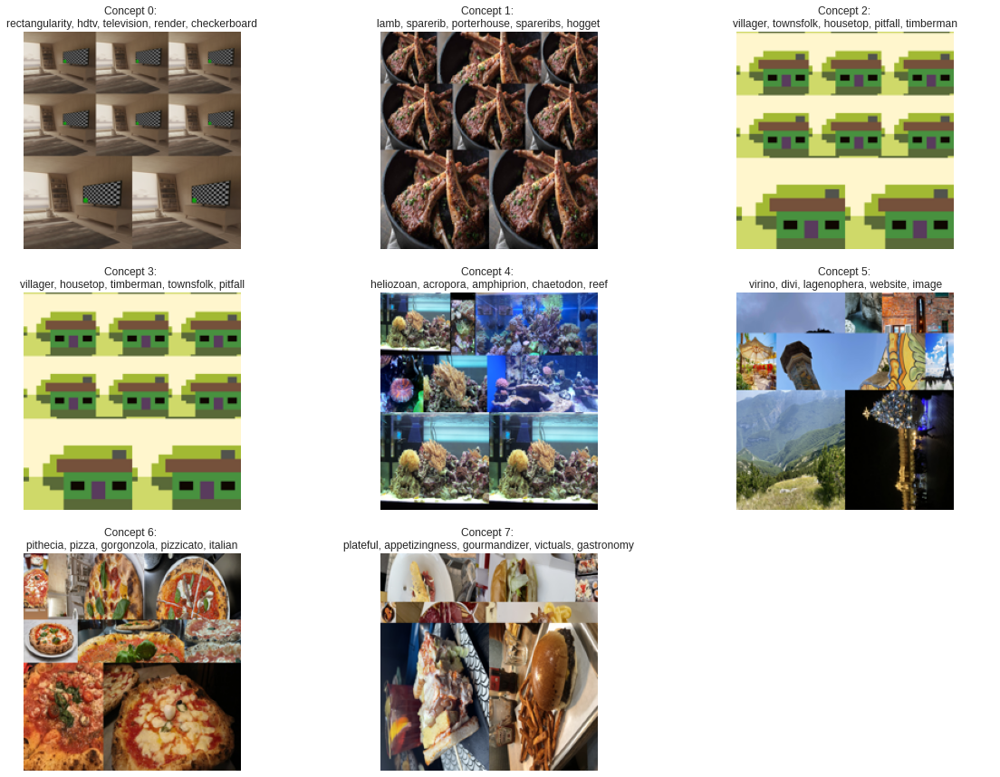

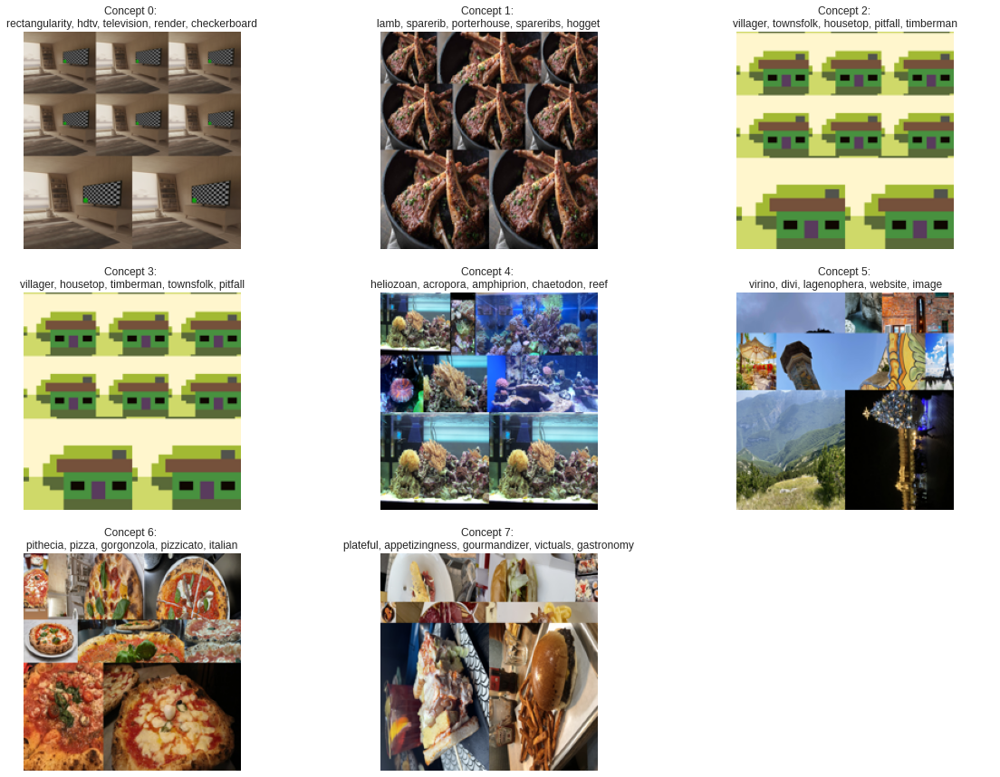

In [ ]:
concept_model.visualize_concepts(concepts=concepts_list)

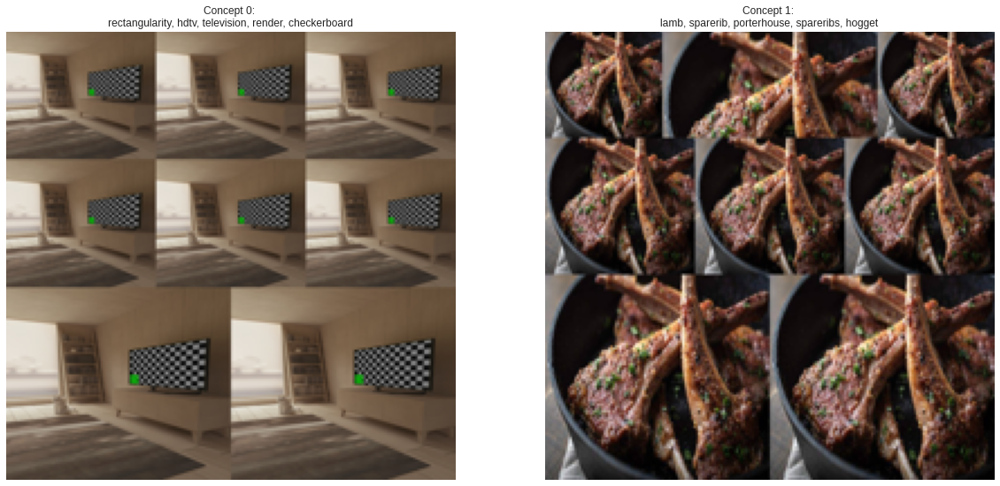

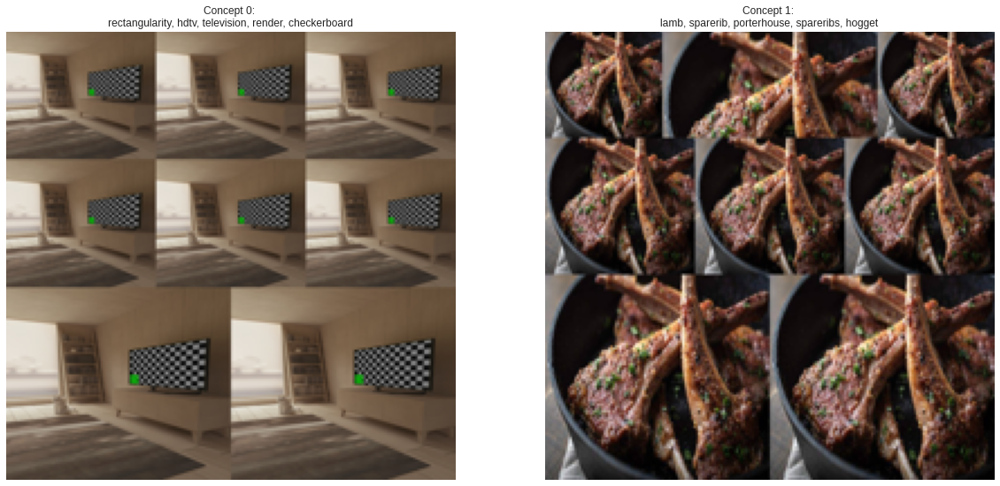

In [ ]:
concept_model.visualize_concepts(concepts=[0,1])

In [ ]:
concept_model.find_concepts("spiaggia")

[(5, 0.26442772393380487),
 (7, 0.23060777104001945),
 (6, 0.219193780379409),
 (4, 0.2042810991624901),
 (3, 0.18184264922180352)]

## CCA

<h1>Problem:</h1> <h3>It works just on pairs (image,text), so the two dataset should have the same number of samples. </h3>

In [ ]:
import numpy as np
from sklearn.cross_decomposition import CCA

Texts

In [ ]:
X = declutr_emb
X_mc = (X-X.mean())/(X.std())

Images

In [ ]:
model_image = CLIPVisionModel.from_pretrained("openai/clip-vit-base-patch32")
processor_image = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

img_embeddings = []
for i in images[:100]:
  image = Image.open(i)

  inputs_image = processor_image(images=image, return_tensors="pt")

  outputs_image = model_image(**inputs_image)
  last_hidden_state_image = outputs_image.last_hidden_state
  pooled_output_image = outputs_image.pooler_output  # pooled CLS states
  img_embeddings.append(pooled_output_image)

Downloading:   0%|          | 0.00/4.03k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/577M [00:00<?, ?B/s]

Some weights of the model checkpoint at openai/clip-vit-base-patch32 were not used when initializing CLIPVisionModel: ['text_model.encoder.layers.5.self_attn.v_proj.bias', 'text_model.encoder.layers.10.self_attn.v_proj.bias', 'text_model.encoder.layers.3.layer_norm1.weight', 'text_model.encoder.layers.11.mlp.fc2.bias', 'text_model.encoder.layers.7.layer_norm2.weight', 'text_model.encoder.layers.8.mlp.fc1.weight', 'text_model.encoder.layers.3.layer_norm1.bias', 'text_model.encoder.layers.1.layer_norm1.weight', 'text_model.encoder.layers.2.mlp.fc1.bias', 'text_model.encoder.layers.3.self_attn.q_proj.bias', 'text_model.encoder.layers.0.self_attn.out_proj.weight', 'text_model.encoder.layers.11.mlp.fc2.weight', 'text_model.encoder.layers.11.layer_norm1.bias', 'text_model.encoder.layers.6.mlp.fc1.bias', 'text_model.encoder.layers.7.self_attn.v_proj.weight', 'text_model.encoder.layers.1.mlp.fc1.weight', 'text_model.encoder.layers.8.mlp.fc1.bias', 'text_model.encoder.layers.4.mlp.fc1.weight', 

Downloading:   0%|          | 0.00/316 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/568 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/842k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/512k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/2.12M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/389 [00:00<?, ?B/s]

In [ ]:
len = len(img_embeddings)
for i in range(len):
  img_embeddings[i] = img_embeddings[i].cpu().detach().numpy()
Y = np.array(img_embeddings)
Y_mc = (Y-Y.mean())/(Y.std())

In [ ]:
ca = CCA()
ca.fit(X_mc, Y_mc)
X_c, Y_c = ca.transform(X_mc, Y_mc)

ValueError: ignored

## Data2Vec

Paper -> https://arxiv.org/pdf/2202.03555.pdf

HF -> https://huggingface.co/docs/transformers/model_doc/data2vec#transformers.Data2VecTextModel

In [ ]:
from transformers import RobertaTokenizer, Data2VecTextModel
from transformers import BeitFeatureExtractor, Data2VecVisionModel
from summarizer.sbert import SBertSummarizer
import torch
from PIL import Image

In [ ]:
def get_documents(df_documents, model, num_docs=0, number_sentences=8):
  if num_docs != 0:
    texts = df_documents.iloc[:num_docs]
  else:
    texts = df_documents
  df_summarized = texts.apply(lambda article: model(article, num_sentences=number_sentences))
  return df_summarized.tolist()

Max number of tokens admitted is 514 -> summarize texts to 8 sentence is generally enough (add truncation anyway because sometimes the limit is exceeded) 

In [ ]:
tokenizer = RobertaTokenizer.from_pretrained("facebook/data2vec-text-base")
model_text = Data2VecTextModel.from_pretrained("facebook/data2vec-text-base")
model_summarizer = SBertSummarizer('distiluse-base-multilingual-cased-v1')

summarized_texts = get_documents(df_schede.description, model_summarizer, num_docs=0, number_sentences=8)
inputs_text = tokenizer(summarized_texts, padding=True, truncation=True, return_tensors="pt") 
outputs_text = model_text(**inputs_text)

text_last_hidden_states = outputs_text.last_hidden_state
text_pooler_output = outputs_text.pooler_output

Downloading:   0%|          | 0.00/878k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/446k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/772 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.09k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/714 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/476M [00:00<?, ?B/s]

Some weights of the model checkpoint at facebook/data2vec-text-base were not used when initializing Data2VecTextModel: ['lm_head.layer_norm.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.bias', 'lm_head.dense.weight', 'lm_head.bias']
- This IS expected if you are initializing Data2VecTextModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing Data2VecTextModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of Data2VecTextModel were not initialized from the model checkpoint at facebook/data2vec-text-base and are newly initialized: ['data2vec_text.pooler.dense.weight', 'data2vec_text.pooler.dense.bias']
You should probably TRAIN this model on a down-stream task to be able to use it f

Downloading:   0%|          | 0.00/690 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/114 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/2.38k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/556 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/122 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/539M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.96M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/452 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/996k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/341 [00:00<?, ?B/s]

In [ ]:
text_pooler_output.shape

In [ ]:
feature_extractor = BeitFeatureExtractor.from_pretrained("facebook/data2vec-vision-base")
model_vision = Data2VecVisionModel.from_pretrained("facebook/data2vec-vision-base", add_pooling_layer=True)

img = Image.open(images[0])
inputs_vision = feature_extractor(img, return_tensors="pt")

with torch.no_grad():
    outputs_vision = model_vision(**inputs_vision)

vision_last_hidden_states = outputs_vision.last_hidden_state
vision_pooler_output = outputs_vision.pooler_output

In [ ]:
vision_pooler_output.shape